In [2]:
from Dirs import *
import os
import pandas as pd
import numpy as np

print("Coluna 1: DIMENSÃO | Coluna 2: STD | Coluna 3: CLASSE | Coluna 4: Moda Estatística para cada classe predicted pelo Kmeans")

arquivos = os.listdir(latentSpace_dir)
classes = pd.read_csv("Classes.csv")
labels = ["type1", "whan"]

for arquivo in arquivos:
    #print(arquivo)
    df_tmp = pd.read_csv(latentSpace_dir +"/"+ arquivo)
    features = []
    for i in range(df_tmp.shape[1]):
        features.append('Feature {}'.format(i+1))
  
    features.append("type1")
    features.append("whan")
    type1 = np.copy(classes.values[:,1])
    type1 = np.reshape(type1, (type1.shape[0],1))
    concat = np.concatenate([df_tmp.values, type1], axis = 1)
    whan = np.copy(classes.values[:,-1])
    whan = np.reshape(whan, (whan.shape[0],1))
    concat = np.concatenate([concat, whan], axis = 1)
    df = pd.DataFrame(data = concat , columns = features)
    #print(df.head(5))
    #print(df.shape)
    labels = ["type1", "whan"]
    for label in labels:
        from sklearn.cluster import KMeans
        y_test = np.asarray(df[label])
        y_test = np.reshape(y_test, (df[label].shape[0],1))
        unique = np.unique(y_test)
        #print(unique)
        
        n_clusters = len(np.unique(df[label]))
        kmeans = KMeans(n_clusters=n_clusters, n_init=5)
        y_pred_kmeans = kmeans.fit_predict(df.values[:,:df_tmp.shape[1]])
        #y_pred_kmeans = y_pred_kmeans.astype('float64') 
        #print(y_pred_kmeans)
        #print(np.unique(y_pred_kmeans))
        from scipy.stats import mode
        y_pred_kmeans = np.reshape(y_pred_kmeans, (y_pred_kmeans.shape[0],1))
        labels = np.zeros_like(y_pred_kmeans)
        #print(labels.shape)
        
        for i in range(unique.shape[0]):
            mask = (y_pred_kmeans == float(i))
            #y_test = df["type1"]
            #print(mask[-10:])
            #print(y_test.shape)
            #print((mode(y_test[mask])[0]))
            print(f"{arquivo}  |  {label}  |  {mode(y_test[mask])}")
            labels[mask] = mode(y_test[mask])[0]
        #print(np.unique(labels, return_counts=True))
        from sklearn.metrics import accuracy_score
        #print(f"{arquivo} | {label} | {accuracy_score(y_test, labels)}")
        print(arquivo)
        break
    break

Coluna 1: DIMENSÃO | Coluna 2: STD | Coluna 3: CLASSE | Coluna 4: Moda Estatística para cada classe predicted pelo Kmeans
[VAE]Lat_Dim=5 | STD=1e-13.csv  |  type1  |  ModeResult(mode=array([2.]), count=array([45873]))
[VAE]Lat_Dim=5 | STD=1e-13.csv  |  type1  |  ModeResult(mode=array([2.]), count=array([2824]))
[VAE]Lat_Dim=5 | STD=1e-13.csv  |  type1  |  ModeResult(mode=array([2.]), count=array([18967]))
[VAE]Lat_Dim=5 | STD=1e-13.csv


In [61]:
from sklearn.cluster import KMeans
#print(np.unique(df["type1"]))
y_test = np.asarray(df["whan"])
y_test = np.reshape(y_test, (df["whan"].shape[0],1))
unique = np.unique(df["whan"])
n_clusters = len(np.unique(unique))
kmeans = KMeans(n_clusters=n_clusters, n_init=20)
y_pred_kmeans = kmeans.fit_predict(df.values[:,:3])

from scipy.stats import mode
y_pred_kmeans = np.reshape(y_pred_kmeans, (y_pred_kmeans.shape[0],1))
labels = np.zeros_like(y_pred_kmeans)
#print(labels.shape)
for i in range(5):
    mask = (y_pred_kmeans == i)
    #y_test = df["type1"]
    #print(mask.shape)
    #print(y_test.shape)
    #print(mode(y_test[mask][0]))
    labels[mask] = mode(y_test[mask])[0]

from sklearn.metrics import accuracy_score
accuracy_score(y_test, labels)

0.3993167433197094

In [74]:
import time

start = time.time()

from sklearn.cluster import SpectralClustering
#print(np.unique(df["type1"]))
y_test = np.asarray(df["whan"])
y_test = np.reshape(y_test, (df["whan"].shape[0],1))
n_clusters = len(np.unique(df["whan"]))
model = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors',
                           assign_labels='kmeans', n_init= 1)
y_pred_spec = model.fit_predict(df.values[:,:df.shape[1] - 2])


from scipy.stats import mode
y_pred_spec = np.reshape(y_pred_spec, (y_pred_spec.shape[0],1))
labels = np.zeros_like(y_pred_spec)
#print(labels.shape)
for i in range(5):
    mask = (y_pred_spec == float(i))
    #y_test = df["type1"]
    #print(mask.shape)
    #print(y_test.shape)
    #print(mode(y_test[mask][0]))
    labels[mask] = mode(y_test[mask])[0]

from sklearn.metrics import accuracy_score
print(accuracy_score(y_test, labels))

finish = time.time()
tempo = finish - start
print("Minutos: {}".format(int(tempo/60)))

0.3993167433197094
Minutos: 13


In [72]:
from sklearn.mixture import GaussianMixture
#print(np.unique(df["type1"]))
y_test = np.asarray(df["whan"])
y_test = np.reshape(y_test, (df["whan"].shape[0],1))
n_clusters = len(np.unique(df["whan"]))

gmm = GaussianMixture(n_components=n_clusters, n_init= 20, covariance_type= 'full')
y_pred_gmm = gmm.fit_predict(df.values[:,:df.shape[1]-2])

from scipy.stats import mode
y_pred_gmm = np.reshape(y_pred_gmm, (y_pred_gmm.shape[0],1))
labels = np.zeros_like(y_pred_gmm)
#print(labels.shape)
for i in range(5):
    mask = (y_pred_gmm == float(i))
    #y_test = df["type1"]
    #print(mask.shape)
    #print(y_test.shape)
    #print(mode(y_test[mask][0]))
    labels[mask] = mode(y_test[mask])[0]

from sklearn.metrics import accuracy_score
accuracy_score(y_test, labels)

0.3993167433197094

In [4]:
from sklearn.manifold import TSNE

# Project the data: this step will take several seconds
tsne = TSNE(n_components=2, init='random', random_state=0)
digits_proj = tsne.fit_transform(df.values[:,:df.shape[1] - 2 ])
print("**T-SNE**")

from sklearn.cluster import KMeans
#print(np.unique(df["type1"]))
y_test = np.asarray(df["whan"])
y_test = np.reshape(y_test, (df["whan"].shape[0],1))
n_clusters = len(np.unique(df["whan"]))
kmeans = KMeans(n_clusters=n_clusters, n_init=20)
y_pred_kmeans = kmeans.fit_predict(digits_proj)

from scipy.stats import mode
y_pred_kmeans = np.reshape(y_pred_kmeans, (y_pred_kmeans.shape[0],1))
labels = np.zeros_like(y_pred_kmeans)
#print(labels.shape)
for i in range(5):
    mask = (y_pred_kmeans == float(i))
    #y_test = df["type1"]
    #print(mask.shape)
    #print(y_test.shape)
    #print(mode(y_test[mask][0]))
    labels[mask] = mode(y_test[mask])[0]

from sklearn.metrics import accuracy_score
print(accuracy_score(y_test, labels))




from sklearn.mixture import GaussianMixture
#print(np.unique(df["type1"]))
y_test = np.asarray(df["whan"])
y_test = np.reshape(y_test, (df["whan"].shape[0],1))
n_clusters = len(np.unique(df["whan"]))

gmm = GaussianMixture(n_components=n_clusters, n_init= 20, covariance_type= 'full')
y_pred_gmm = gmm.fit_predict(digits_proj)

from scipy.stats import mode
y_pred_gmm = np.reshape(y_pred_gmm, (y_pred_gmm.shape[0],1))
labels = np.zeros_like(y_pred_gmm)
#print(labels.shape)
for i in range(5):
    mask = (y_pred_gmm == float(i))
    #y_test = df["type1"]
    #print(mask.shape)
    #print(y_test.shape)
    #print(mode(y_test[mask][0]))
    labels[mask] = mode(y_test[mask])[0]

from sklearn.metrics import accuracy_score
print(accuracy_score(y_test, labels))

**T-SNE**
0.3993167433197094
0.3993167433197094


In [5]:
features = []
for i in range(digits_proj.shape[1]):
    features.append('Feature {}'.format(i+1))

features.append("type1")
features.append("whan")
type1 = np.copy(classes.values[:,1])
type1 = np.reshape(type1, (type1.shape[0],1))
concat = np.concatenate([digits_proj, type1], axis = 1)
whan = np.copy(classes.values[:,-1])
whan = np.reshape(whan, (whan.shape[0],1))
concat = np.concatenate([concat, whan], axis = 1)

tse_df = pd.DataFrame(data = concat, columns = features)



In [3]:
classes = pd.read_csv("Training_Data")
classes = np.asarray(classes.values[:,:-2])
classes[:5,:]

array([[2.51538893e-02, 3.63598638e-03, 3.66249663e-03, 5.48723522e-02,
        2.31600172e-02, 5.50684425e-02, 1.21398892e-01, 1.18402548e-01],
       [8.37411112e-04, 1.15936400e-04, 1.42125631e-04, 4.12819115e-03,
        2.24692788e-04, 4.34588329e-03, 7.22071244e-03, 4.92860769e-03],
       [9.90329644e-03, 1.71254620e-03, 1.73864576e-03, 8.60401988e-03,
        7.66240405e-03, 8.82257887e-03, 4.15693150e-02, 4.37196489e-02],
       [3.74286356e-03, 4.59328976e-04, 4.84920871e-04, 1.58392183e-02,
        3.82691781e-03, 1.60463374e-02, 2.69904538e-02, 2.88758431e-02],
       [9.14113121e-03, 3.37871781e-04, 3.64150918e-04, 2.43563278e-02,
        8.16939121e-03, 2.45636863e-02, 2.46011690e-02, 1.94679999e-02]])

In [5]:
import os 
from Dirs import *


arquivos = os.listdir(latentSpace_dir)
arquivos

['[CVAE]Lat_Dim=1 | STD=0.1',
 '[CAE]Lat_Dim=2',
 '[CVAE]Lat_Dim=3 | STD=1.0',
 '[CVAE]Lat_Dim=5 | STD=0.1',
 '[VAE]Lat_Dim=2 | STD=1e-13',
 '[CVAE]Lat_Dim=4 | STD=1e-13',
 '[VAE]Lat_Dim=5 | STD=1.0',
 '[CVAE]Lat_Dim=2 | STD=1e-13',
 '[CAE]Lat_Dim=3',
 '[VAE]Lat_Dim=1 | STD=1e-13',
 '[VAE]Lat_Dim=6 | STD=0.5',
 '[VAE]Lat_Dim=3 | STD=1e-13',
 '[CVAE]Lat_Dim=2 | STD=1.0',
 '[CVAE]Lat_Dim=5 | STD=1.0',
 '[CAE]Lat_Dim=5',
 '[AE]Lat_Dim=2',
 '[CVAE]Lat_Dim=3 | STD=1e-13',
 '[CVAE]Lat_Dim=2 | STD=0.5',
 '[VAE]Lat_Dim=2 | STD=0.1',
 '.ipynb_checkpoints',
 '[CVAE]Lat_Dim=5 | STD=0.5',
 '[VAE]Lat_Dim=1 | STD=0.5',
 '[VAE]Lat_Dim=5 | STD=1e-13',
 '[CVAE]Lat_Dim=4 | STD=0.5',
 '[AE]Lat_Dim=1',
 '[VAE]Lat_Dim=2 | STD=0.5',
 '[VAE]Lat_Dim=6 | STD=1e-13',
 '[VAE]Lat_Dim=3 | STD=1.0',
 '[VAE]Lat_Dim=2 | STD=1.0',
 '[CVAE]Lat_Dim=6 | STD=0.1',
 '[VAE]Lat_Dim=5 | STD=0.5',
 '[AE]Lat_Dim=3',
 '[VAE]Lat_Dim=4 | STD=0.1',
 '[VAE]Lat_Dim=5 | STD=0.1',
 '[VAE]Lat_Dim=1 | STD=1.0',
 '[VAE]Lat_Dim=3 | STD=0.1

[CVAE]Lat_Dim=4 | STD=0.1
Computing KMeans
Computing BIC


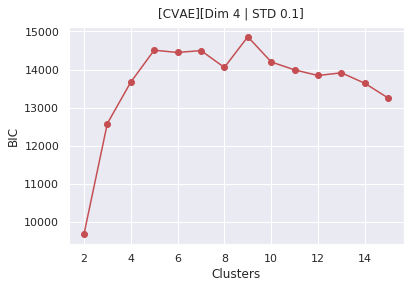

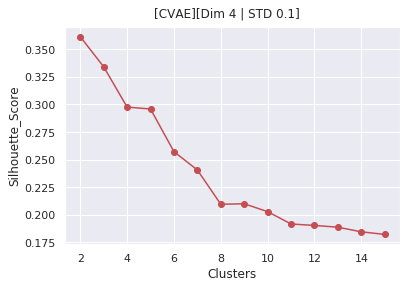

Computing GAP


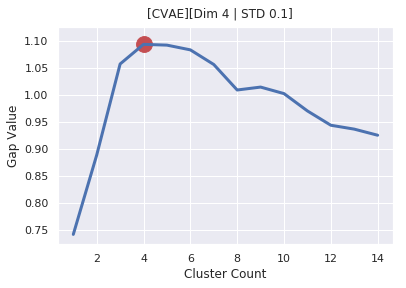

Computing GAP-2
Melho numero de clusters: 3


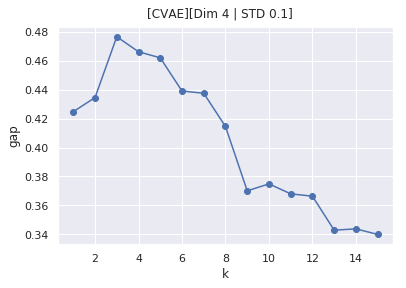

[Finished][CVAE]Lat_Dim=4 | STD=0.1
[VAE]Lat_Dim=3 | STD=0.5
Computing KMeans
Computing BIC


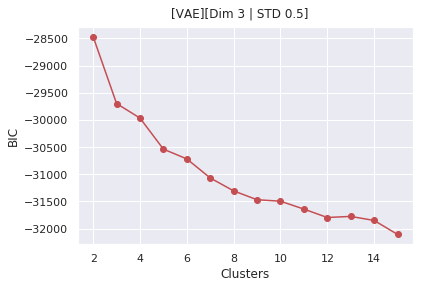

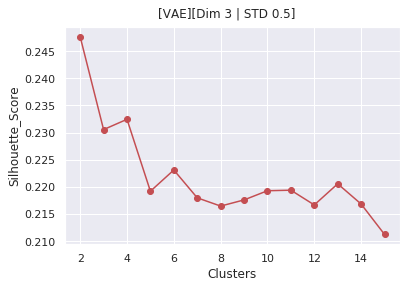

Computing GAP


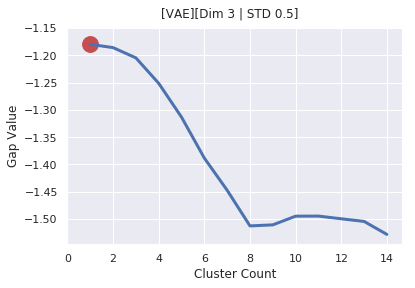

Computing GAP-2
Melho numero de clusters: 1


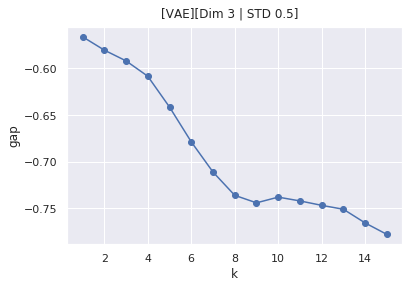

[Finished][VAE]Lat_Dim=3 | STD=0.5
[CVAE]Lat_Dim=4 | STD=1.0
Computing KMeans
Computing BIC


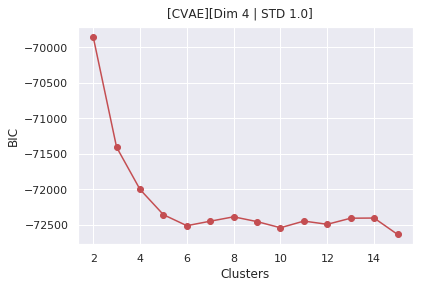

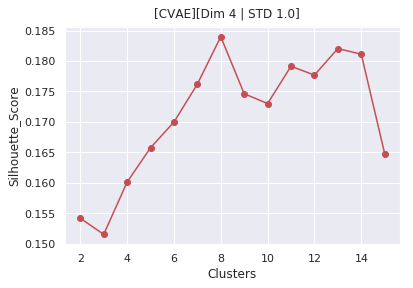

Computing GAP


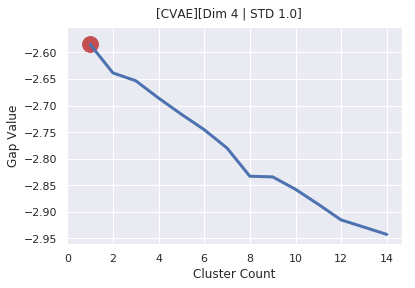

Computing GAP-2
Melho numero de clusters: 1


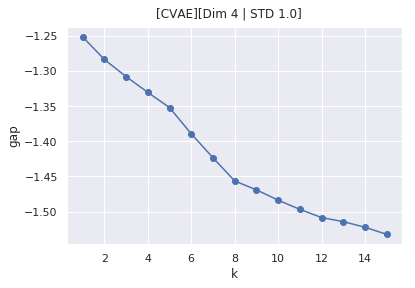

[Finished][CVAE]Lat_Dim=4 | STD=1.0
[VAE]Lat_Dim=4 | STD=0.5
Computing KMeans
Computing BIC


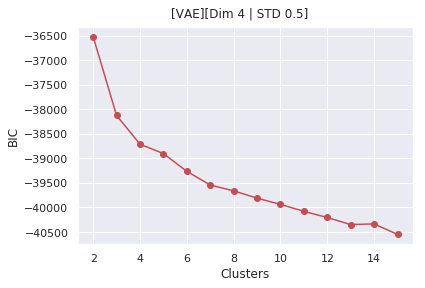

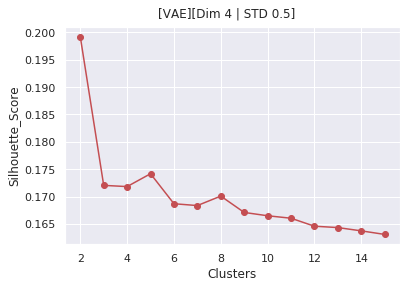

Computing GAP


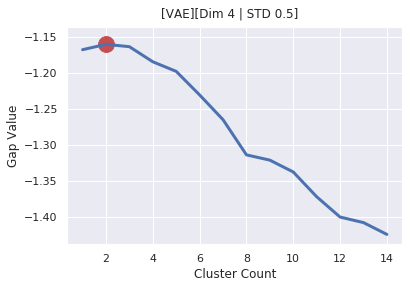

Computing GAP-2
Melho numero de clusters: 1


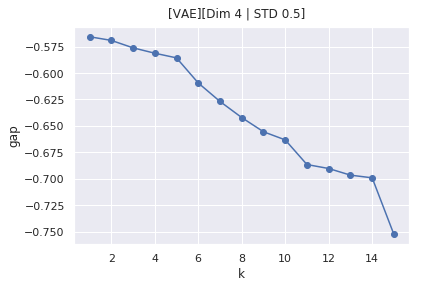

[Finished][VAE]Lat_Dim=4 | STD=0.5
[CVAE]Lat_Dim=2 | STD=0.1
Computing KMeans
Computing BIC


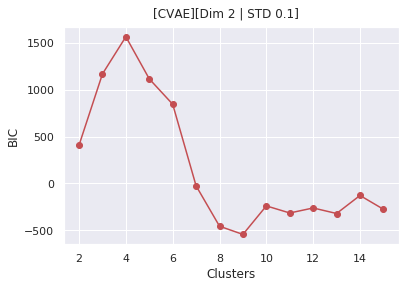

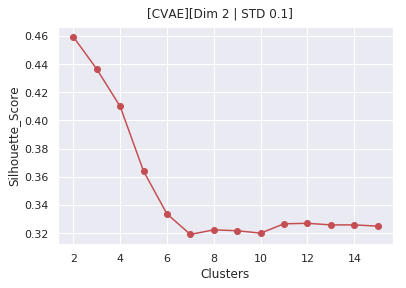

Computing GAP


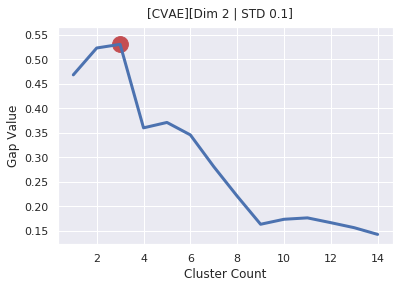

Computing GAP-2
Melho numero de clusters: 1


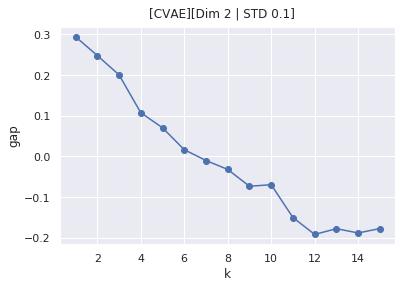

[Finished][CVAE]Lat_Dim=2 | STD=0.1
[VAE]Lat_Dim=1 | STD=0.1
Computing KMeans
Computing BIC


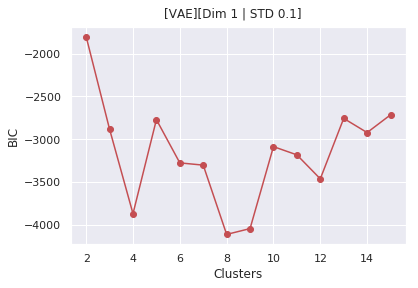

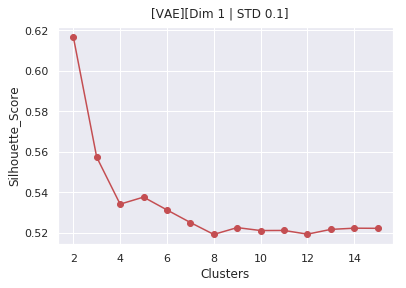

Computing GAP


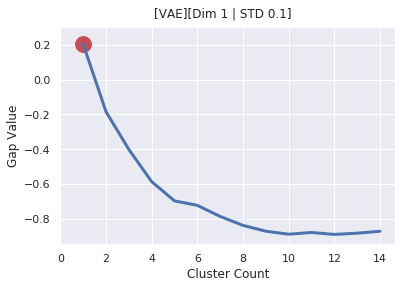

Computing GAP-2
Melho numero de clusters: 1


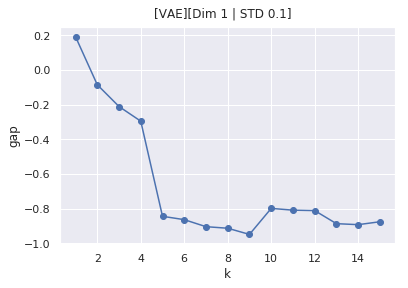

[Finished][VAE]Lat_Dim=1 | STD=0.1
[CVAE]Lat_Dim=6 | STD=1.0
Computing KMeans
Computing BIC


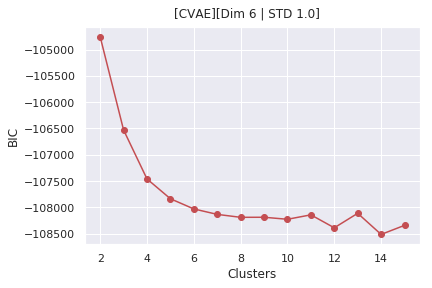

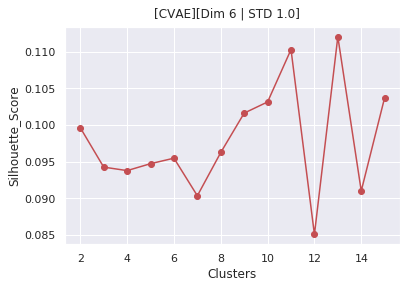

Computing GAP


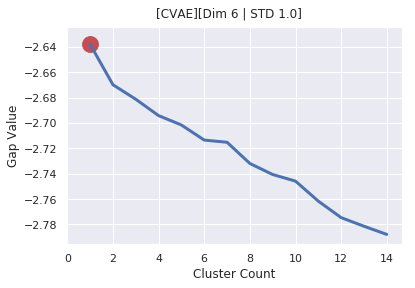

Computing GAP-2
Melho numero de clusters: 1


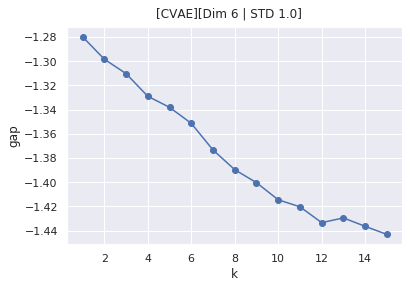

[Finished][CVAE]Lat_Dim=6 | STD=1.0
[AE]Lat_Dim=6
[CAE]Lat_Dim=4
[VAE]Lat_Dim=6 | STD=1.0
Computing KMeans
Computing BIC


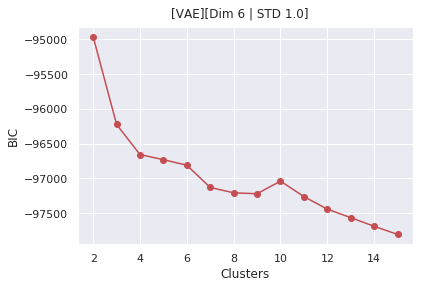

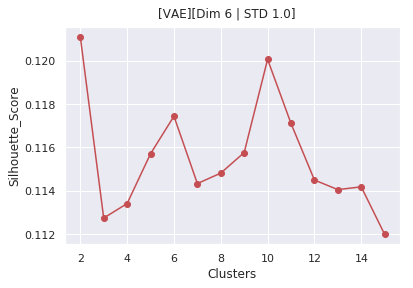

Computing GAP


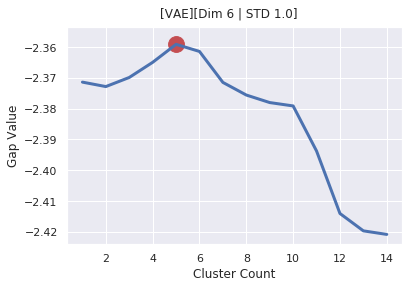

Computing GAP-2
Melho numero de clusters: 5


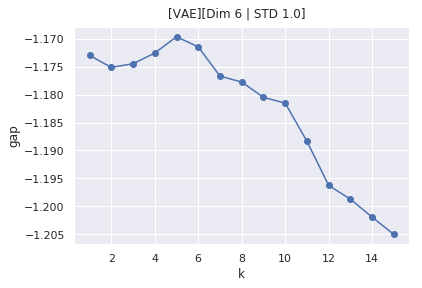

[Finished][VAE]Lat_Dim=6 | STD=1.0
[VAE]Lat_Dim=6 | STD=0.1
Computing KMeans
Computing BIC


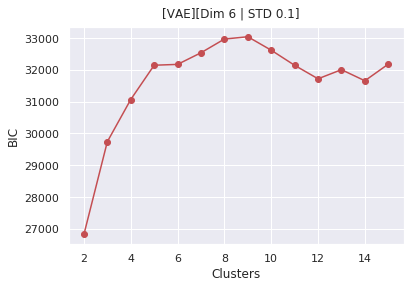

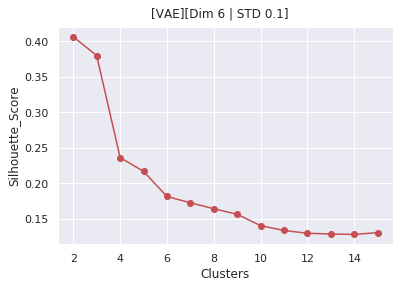

Computing GAP


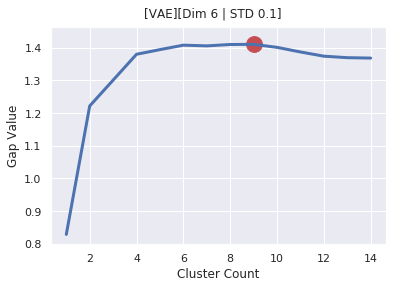

Computing GAP-2
Melho numero de clusters: 4


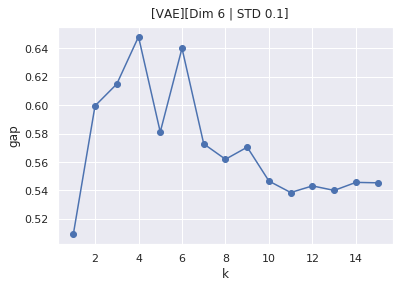

[Finished][VAE]Lat_Dim=6 | STD=0.1
[CVAE]Lat_Dim=5 | STD=1e-13
Computing KMeans
Computing BIC


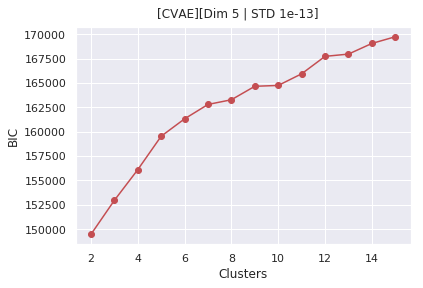

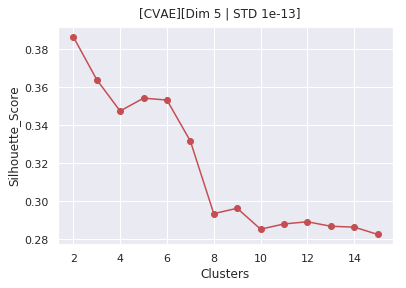

Computing GAP


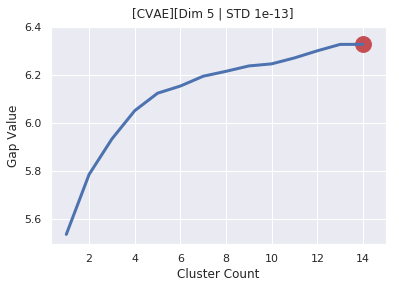

Computing GAP-2
Melho numero de clusters: 4


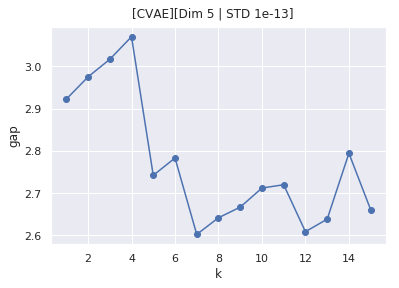

[Finished][CVAE]Lat_Dim=5 | STD=1e-13
[VAE]Lat_Dim=4 | STD=1e-13
Computing KMeans
Computing BIC


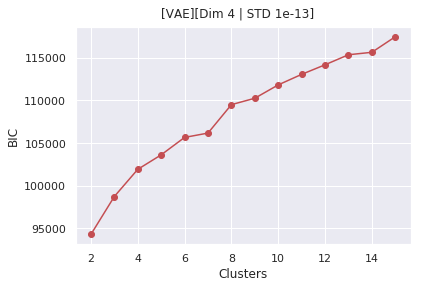

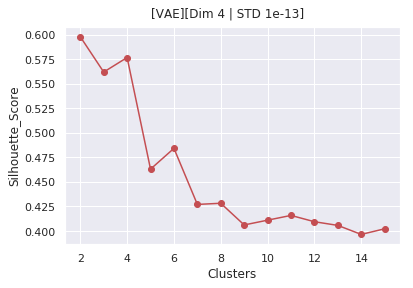

Computing GAP


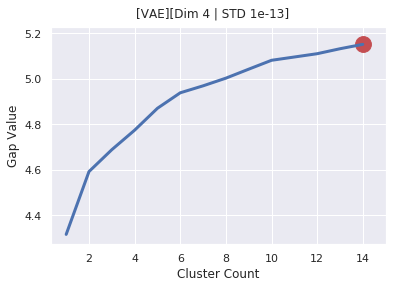

Computing GAP-2
Melho numero de clusters: 1


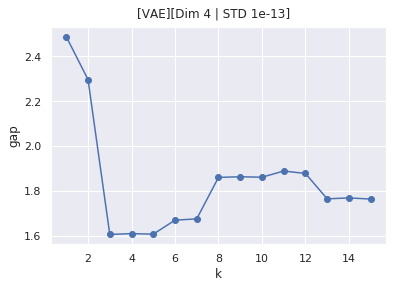

[Finished][VAE]Lat_Dim=4 | STD=1e-13
[CVAE]Lat_Dim=3 | STD=0.5
Computing KMeans
Computing BIC


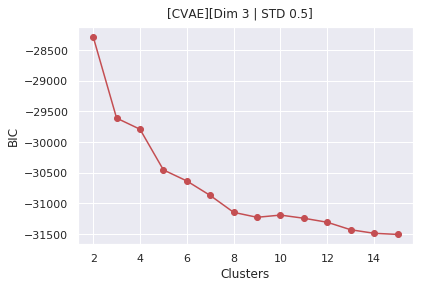

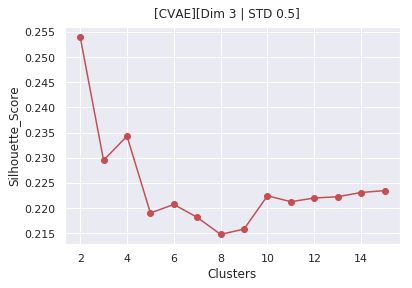

Computing GAP


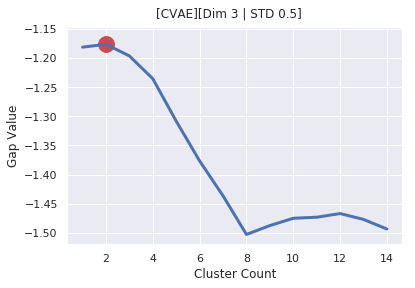

Computing GAP-2
Melho numero de clusters: 1


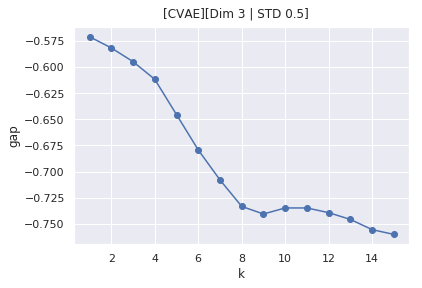

[Finished][CVAE]Lat_Dim=3 | STD=0.5
[CAE]Lat_Dim=6
[AE]Lat_Dim=4
[CVAE]Lat_Dim=6 | STD=1e-13
Computing KMeans
Computing BIC


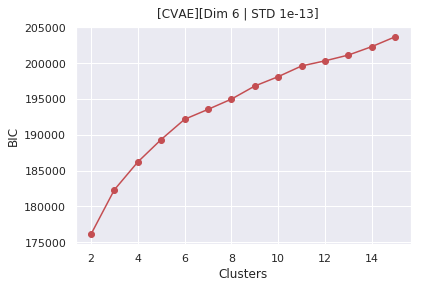

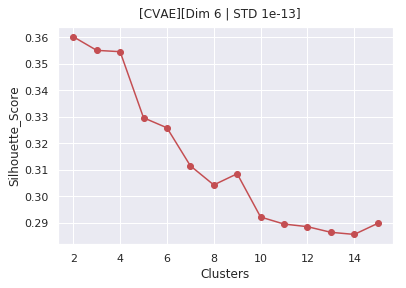

Computing GAP


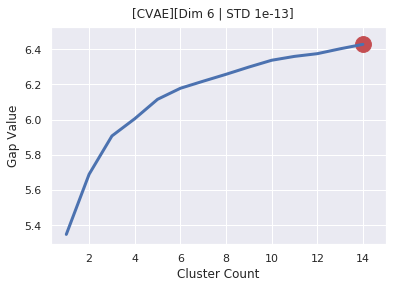

Computing GAP-2
Melho numero de clusters: 3


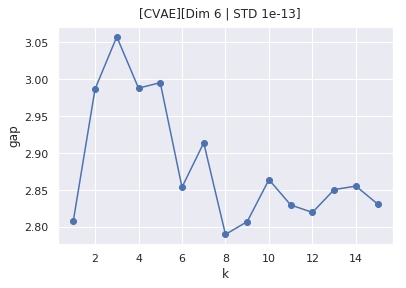

[Finished][CVAE]Lat_Dim=6 | STD=1e-13
[CVAE]Lat_Dim=1 | STD=0.5
Computing KMeans
Computing BIC


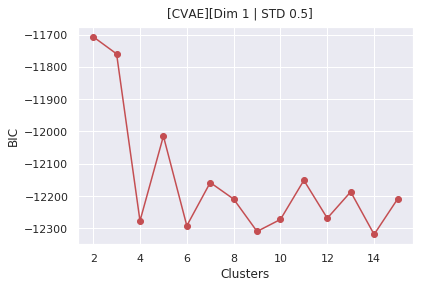

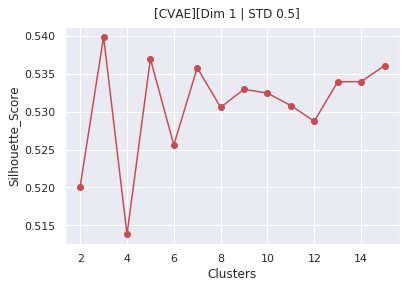

Computing GAP


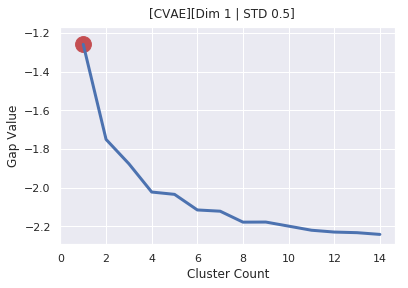

Computing GAP-2
Melho numero de clusters: 1


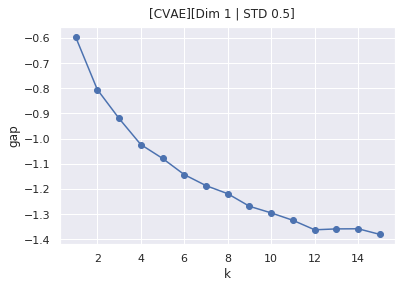

[Finished][CVAE]Lat_Dim=1 | STD=0.5
[CVAE]Lat_Dim=1 | STD=1.0
Computing KMeans
Computing BIC


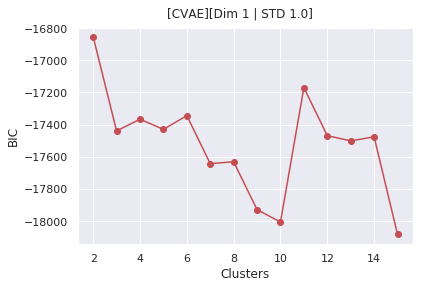

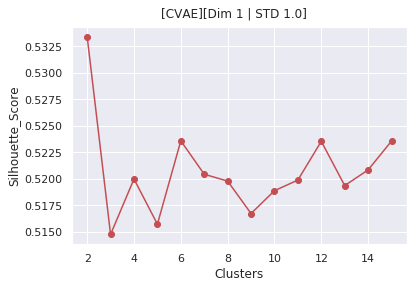

Computing GAP


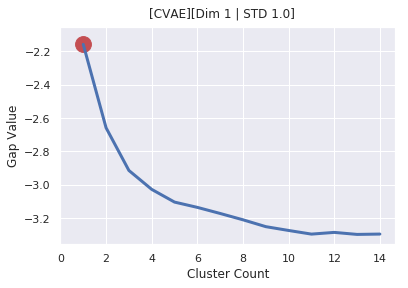

Computing GAP-2
Melho numero de clusters: 1


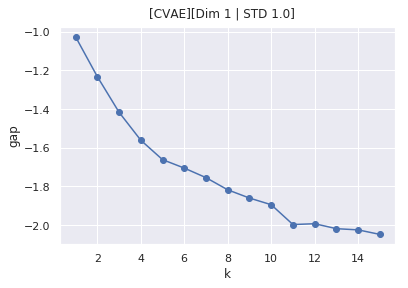

[Finished][CVAE]Lat_Dim=1 | STD=1.0
[VAE]Lat_Dim=4 | STD=1.0
Computing KMeans
Computing BIC


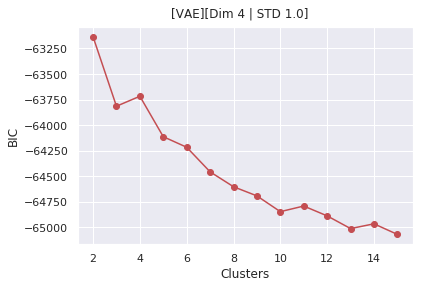

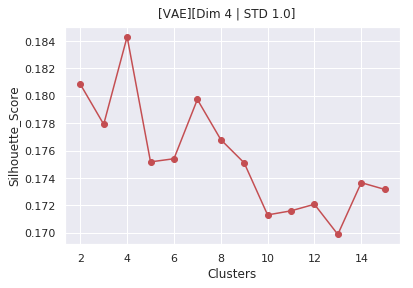

Computing GAP


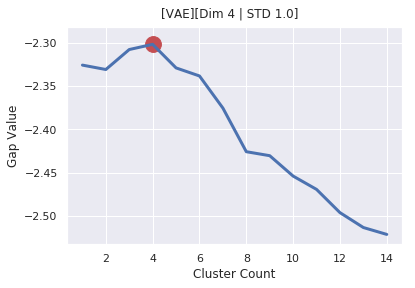

Computing GAP-2
Melho numero de clusters: 4


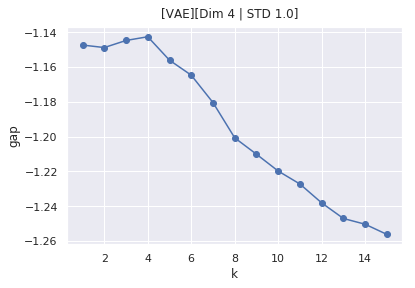

[Finished][VAE]Lat_Dim=4 | STD=1.0
[CVAE]Lat_Dim=3 | STD=0.1
Computing KMeans
Computing BIC


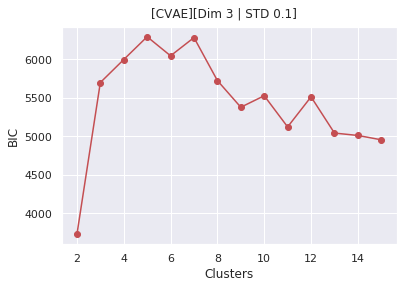

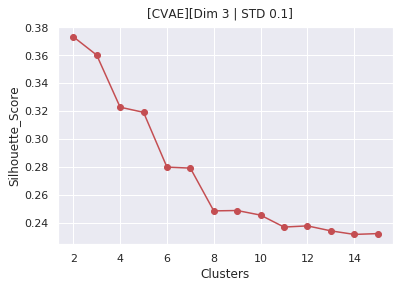

Computing GAP


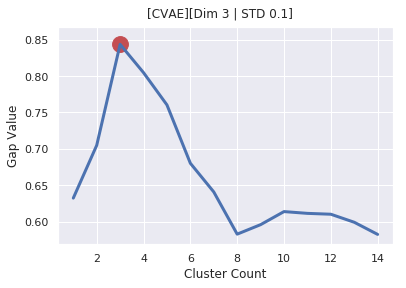

Computing GAP-2
Melho numero de clusters: 1


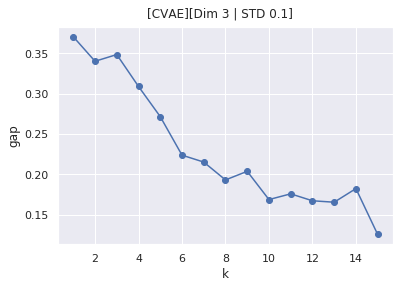

[Finished][CVAE]Lat_Dim=3 | STD=0.1
[AE]Lat_Dim=5
[CVAE]Lat_Dim=6 | STD=0.5
Computing KMeans
Computing BIC


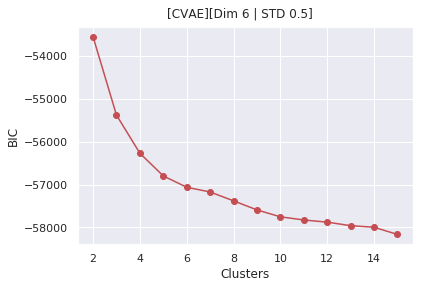

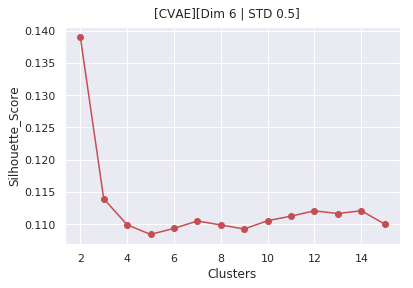

Computing GAP


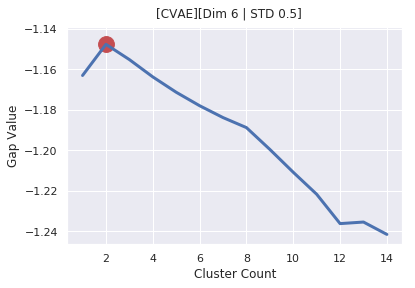

Computing GAP-2
Melho numero de clusters: 2


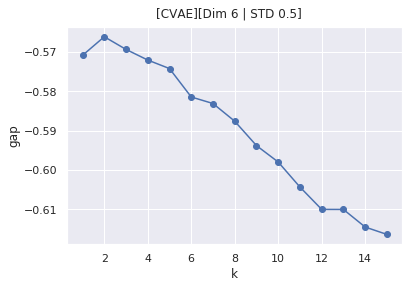

[Finished][CVAE]Lat_Dim=6 | STD=0.5
[CAE]Lat_Dim=1
[CVAE]Lat_Dim=1 | STD=1e-13
Computing KMeans
Computing BIC


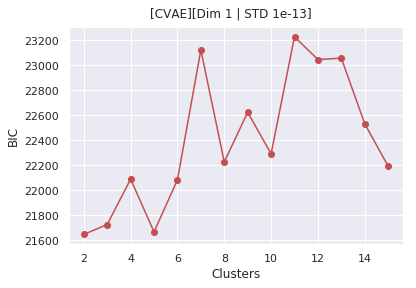

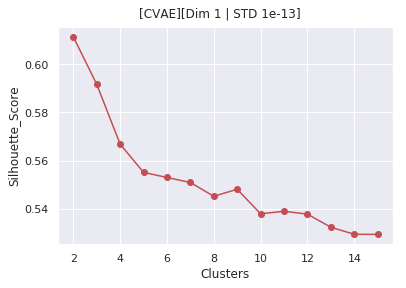

Computing GAP


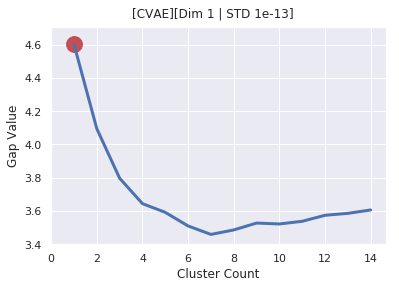

Computing GAP-2
Melho numero de clusters: 1


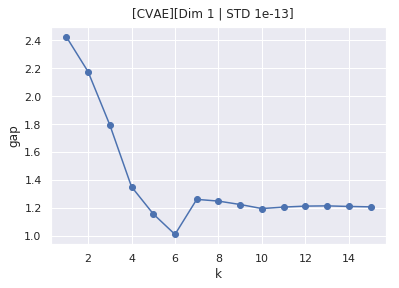

[Finished][CVAE]Lat_Dim=1 | STD=1e-13
[VAE]Lat_Dim=3 | STD=0.1
Computing KMeans
Computing BIC


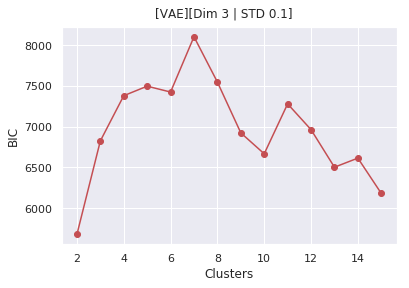

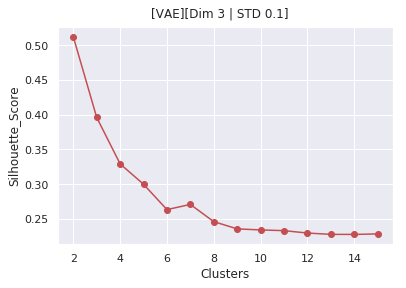

Computing GAP


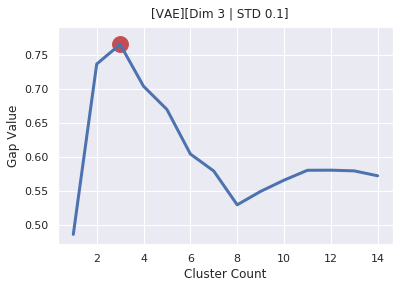

Computing GAP-2
Melho numero de clusters: 1


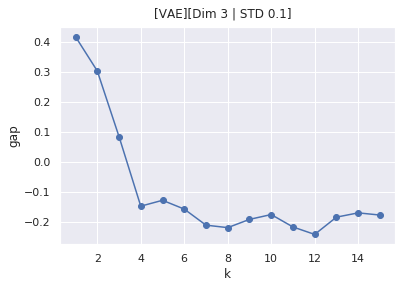

[Finished][VAE]Lat_Dim=3 | STD=0.1
[VAE]Lat_Dim=1 | STD=1.0
Computing KMeans
Computing BIC


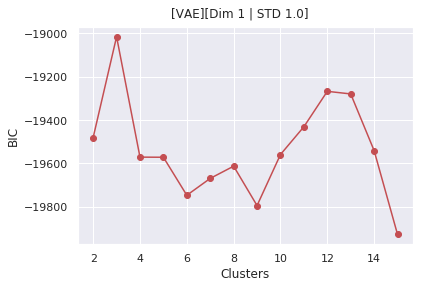

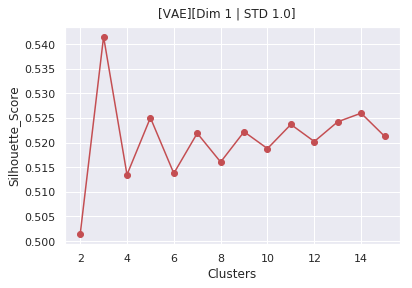

Computing GAP


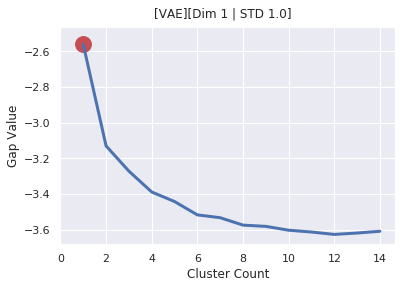

Computing GAP-2
Melho numero de clusters: 1


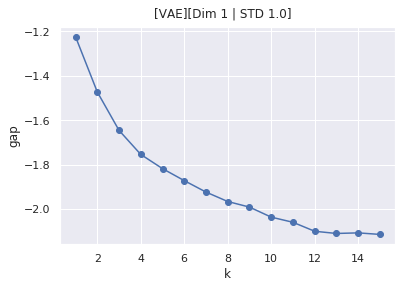

[Finished][VAE]Lat_Dim=1 | STD=1.0
[VAE]Lat_Dim=5 | STD=0.1
Computing KMeans
Computing BIC


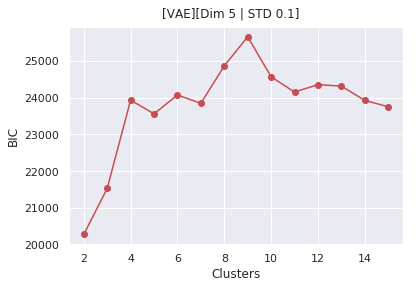

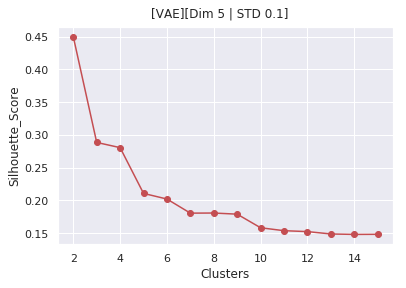

Computing GAP


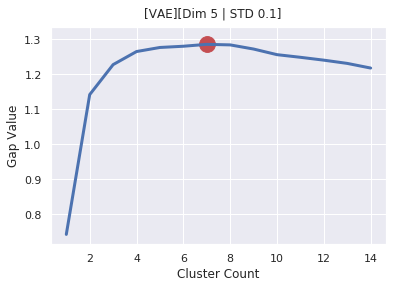

Computing GAP-2
Melho numero de clusters: 3


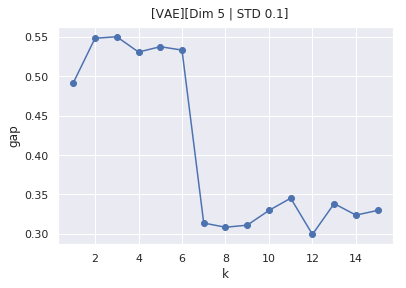

[Finished][VAE]Lat_Dim=5 | STD=0.1
[VAE]Lat_Dim=4 | STD=0.1
Computing KMeans
Computing BIC


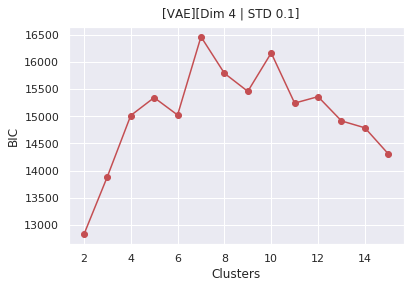

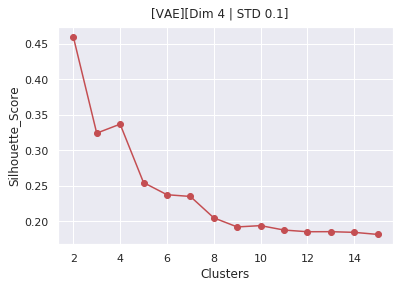

Computing GAP


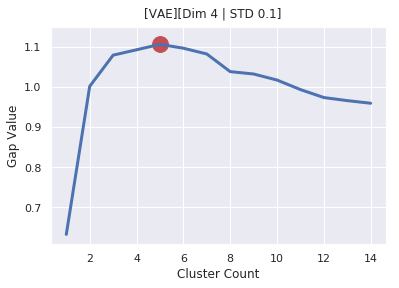

Computing GAP-2
Melho numero de clusters: 4


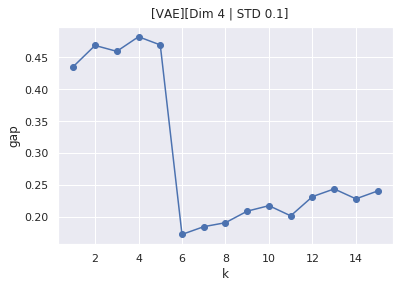

[Finished][VAE]Lat_Dim=4 | STD=0.1
[AE]Lat_Dim=3
[VAE]Lat_Dim=5 | STD=0.5
Computing KMeans
Computing BIC


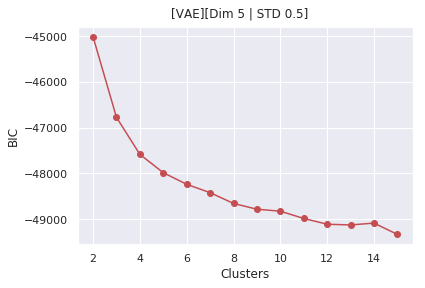

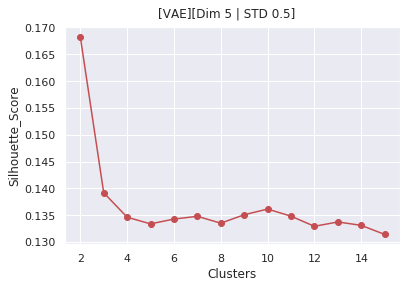

Computing GAP


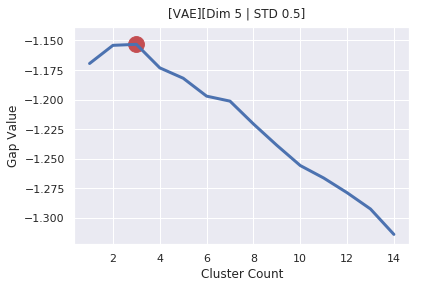

Computing GAP-2
Melho numero de clusters: 1


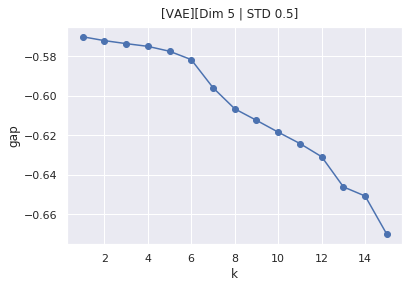

[Finished][VAE]Lat_Dim=5 | STD=0.5
[CVAE]Lat_Dim=6 | STD=0.1
Computing KMeans
Computing BIC


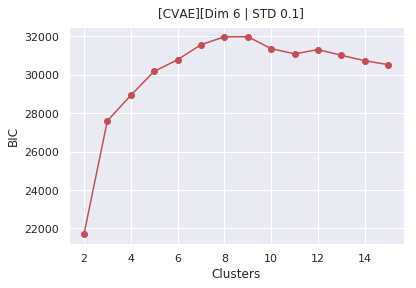

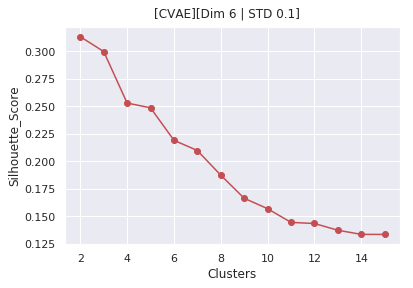

Computing GAP


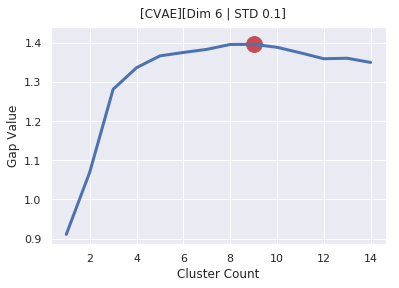

Computing GAP-2
Melho numero de clusters: 7


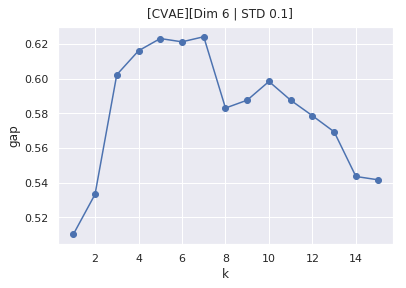

[Finished][CVAE]Lat_Dim=6 | STD=0.1
[VAE]Lat_Dim=2 | STD=1.0
Computing KMeans
Computing BIC


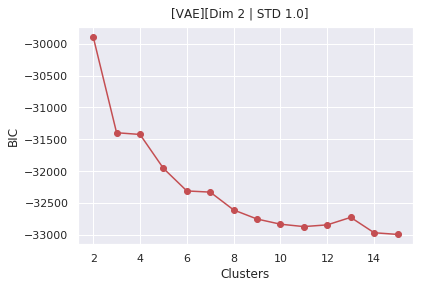

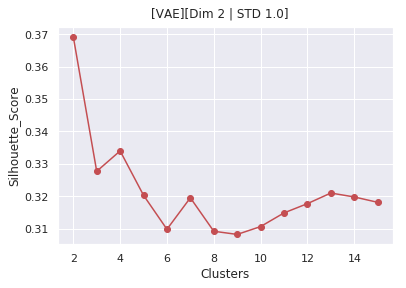

Computing GAP


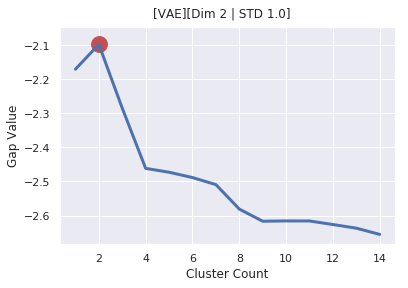

Computing GAP-2
Melho numero de clusters: 2


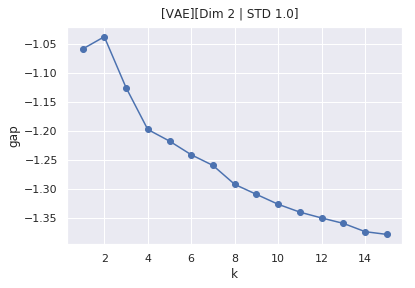

[Finished][VAE]Lat_Dim=2 | STD=1.0
[VAE]Lat_Dim=3 | STD=1.0
Computing KMeans
Computing BIC


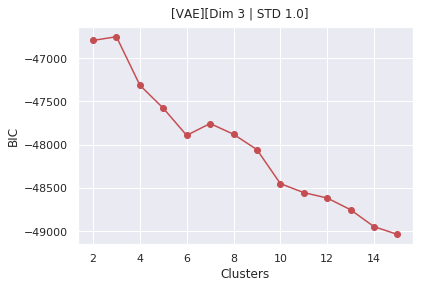

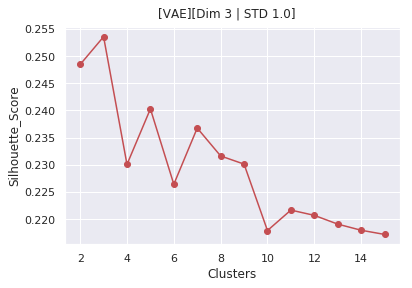

Computing GAP


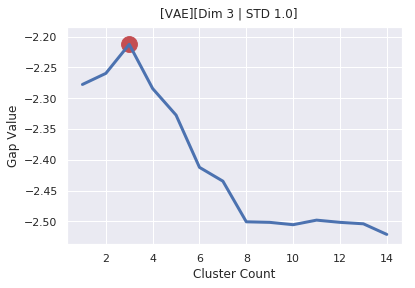

Computing GAP-2
Melho numero de clusters: 3


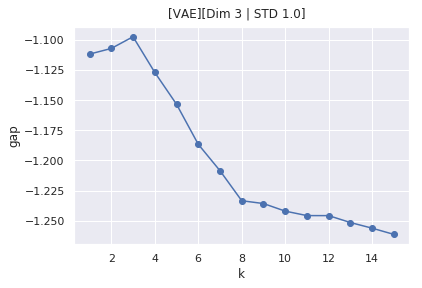

[Finished][VAE]Lat_Dim=3 | STD=1.0
[VAE]Lat_Dim=6 | STD=1e-13
Computing KMeans
Computing BIC


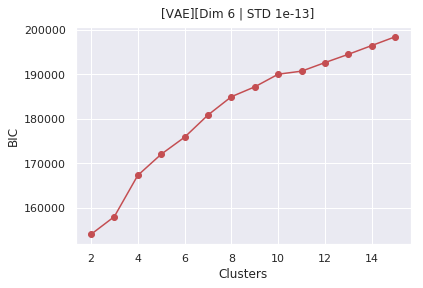

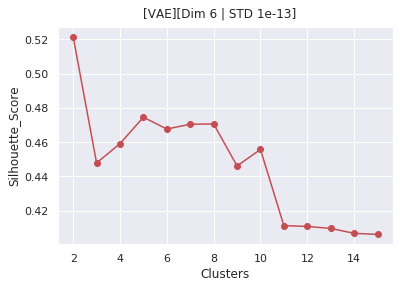

Computing GAP


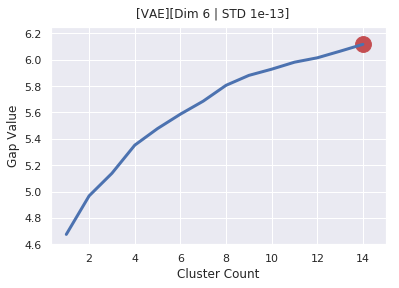

Computing GAP-2
Melho numero de clusters: 3


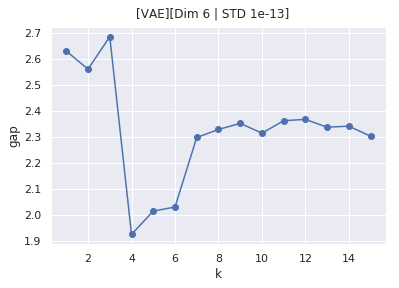

[Finished][VAE]Lat_Dim=6 | STD=1e-13
[VAE]Lat_Dim=2 | STD=0.5
Computing KMeans
Computing BIC


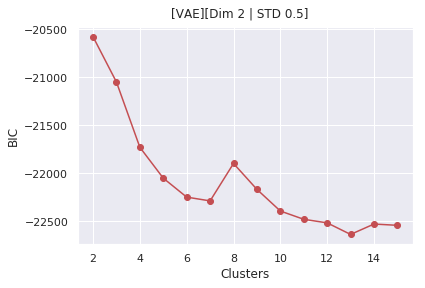

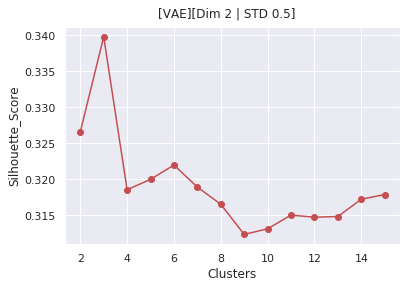

Computing GAP


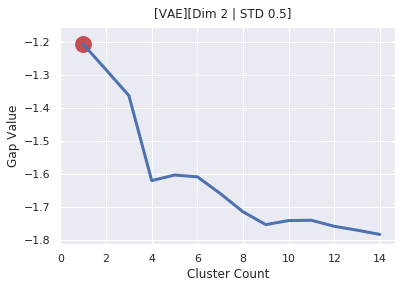

Computing GAP-2
Melho numero de clusters: 1


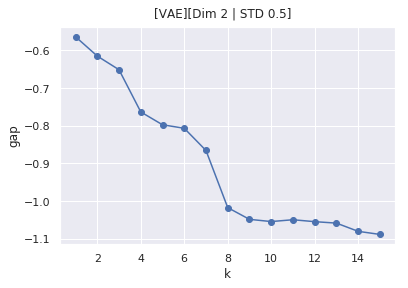

[Finished][VAE]Lat_Dim=2 | STD=0.5
[AE]Lat_Dim=1
[CVAE]Lat_Dim=4 | STD=0.5
Computing KMeans
Computing BIC


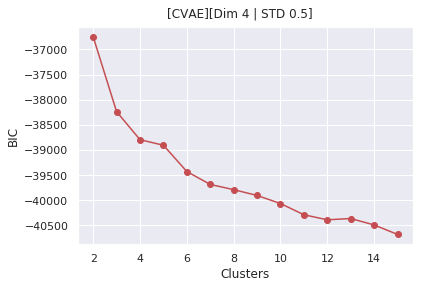

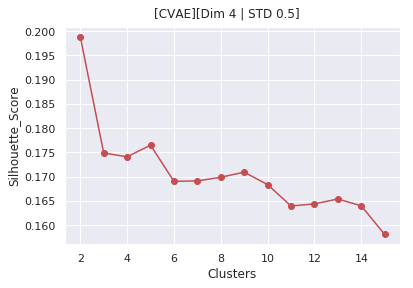

Computing GAP


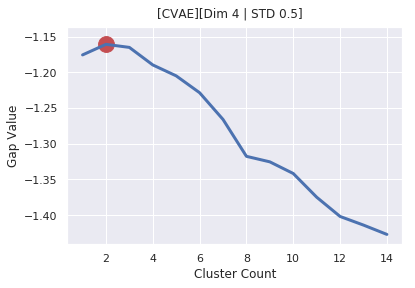

Computing GAP-2
Melho numero de clusters: 2


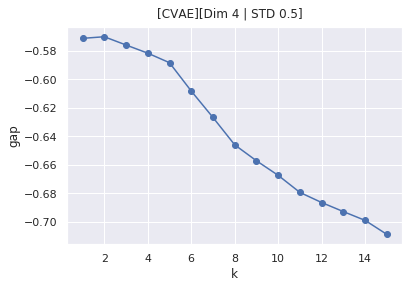

[Finished][CVAE]Lat_Dim=4 | STD=0.5
[VAE]Lat_Dim=5 | STD=1e-13
Computing KMeans
Computing BIC


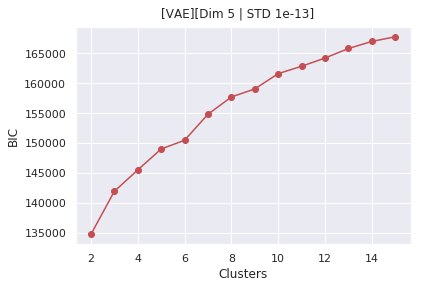

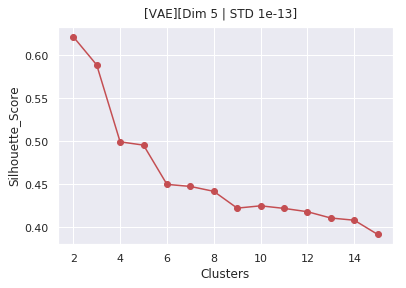

Computing GAP


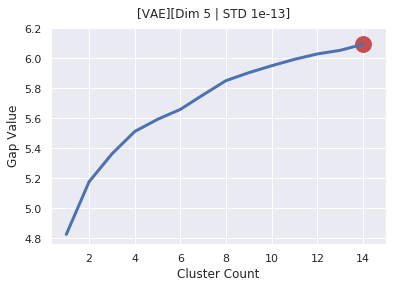

Computing GAP-2
Melho numero de clusters: 1


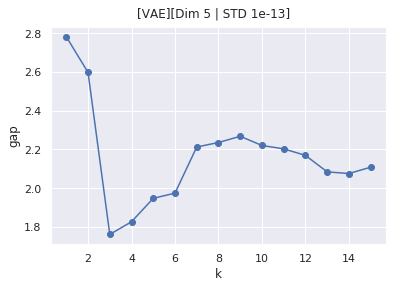

[Finished][VAE]Lat_Dim=5 | STD=1e-13
[VAE]Lat_Dim=1 | STD=0.5
Computing KMeans
Computing BIC


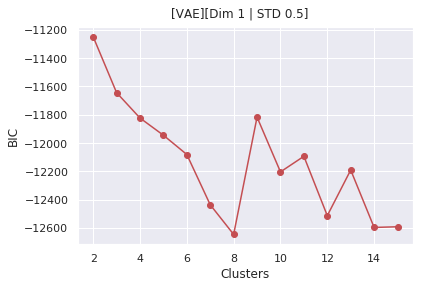

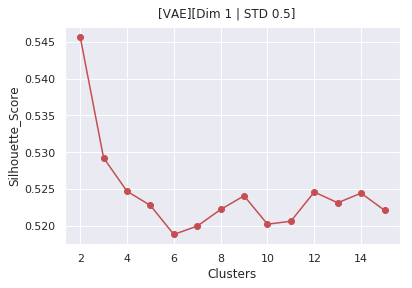

Computing GAP


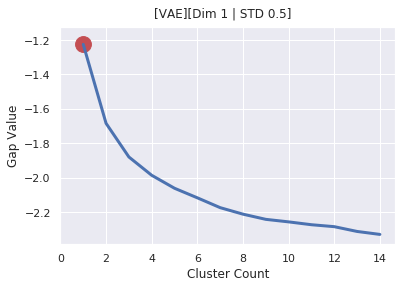

Computing GAP-2
Melho numero de clusters: 1


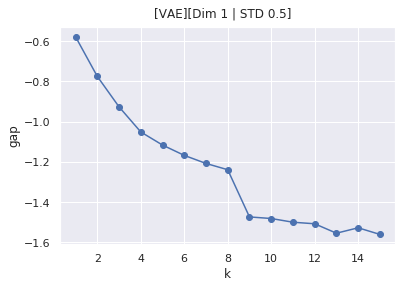

[Finished][VAE]Lat_Dim=1 | STD=0.5
[CVAE]Lat_Dim=5 | STD=0.5
Computing KMeans
Computing BIC


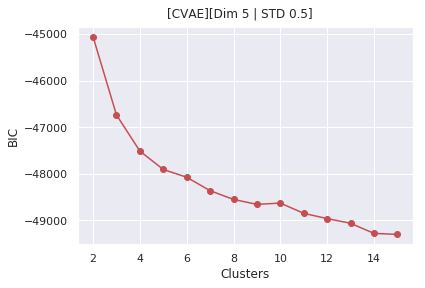

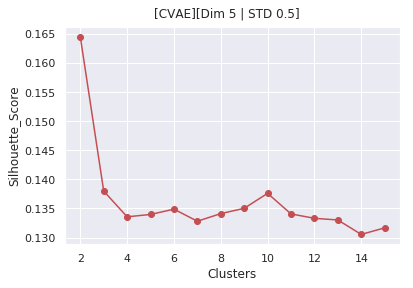

Computing GAP


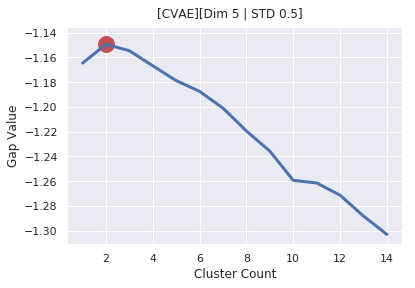

Computing GAP-2
Melho numero de clusters: 2


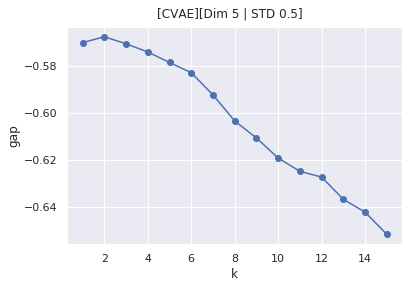

[Finished][CVAE]Lat_Dim=5 | STD=0.5
.ipynb_checkpoints
[VAE]Lat_Dim=2 | STD=0.1
Computing KMeans
Computing BIC


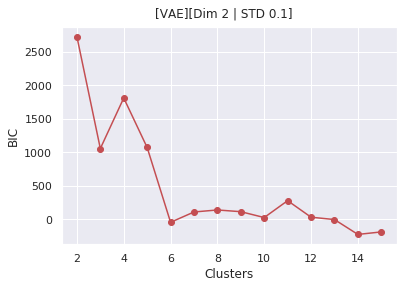

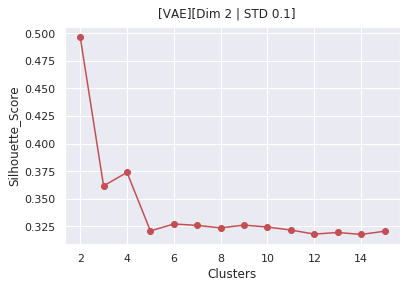

Computing GAP


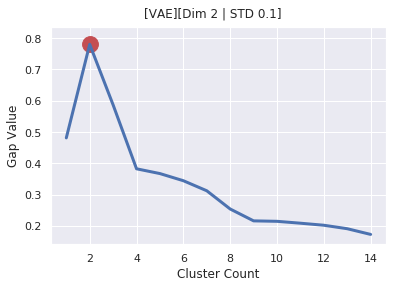

Computing GAP-2
Melho numero de clusters: 2


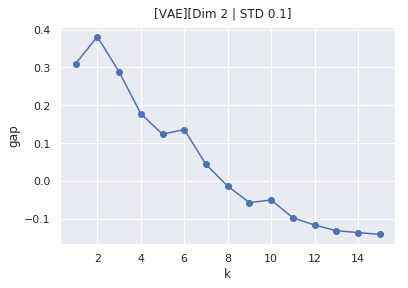

[Finished][VAE]Lat_Dim=2 | STD=0.1
[CVAE]Lat_Dim=2 | STD=0.5
Computing KMeans
Computing BIC


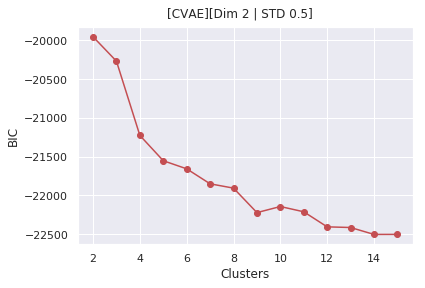

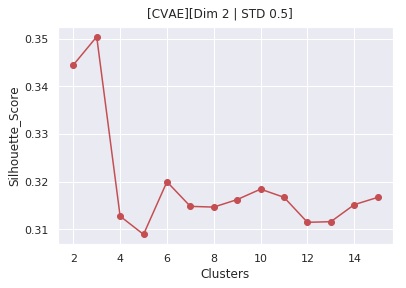

Computing GAP


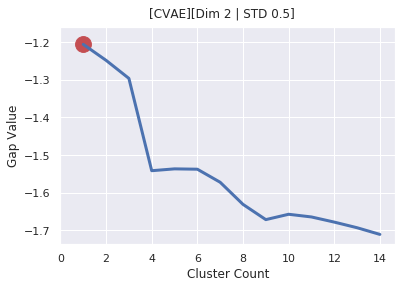

Computing GAP-2
Melho numero de clusters: 1


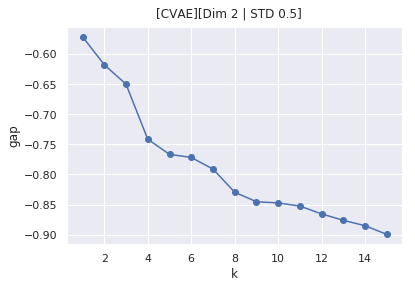

[Finished][CVAE]Lat_Dim=2 | STD=0.5
[CVAE]Lat_Dim=3 | STD=1e-13
Computing KMeans
Computing BIC


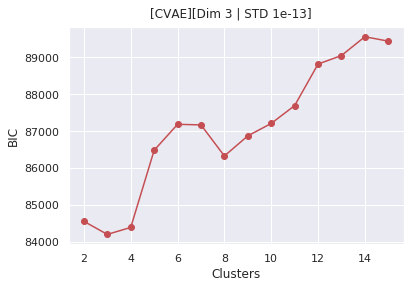

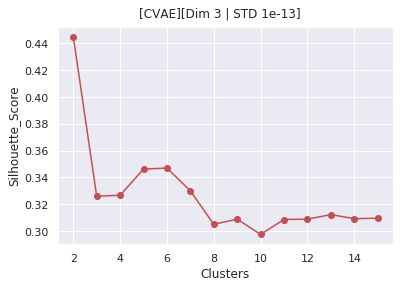

Computing GAP


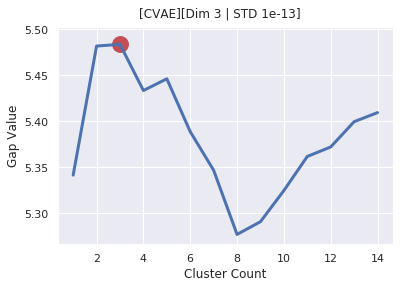

Computing GAP-2
Melho numero de clusters: 1


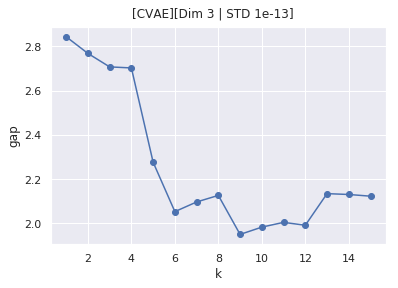

[Finished][CVAE]Lat_Dim=3 | STD=1e-13
[AE]Lat_Dim=2
[CAE]Lat_Dim=5
[CVAE]Lat_Dim=5 | STD=1.0
Computing KMeans
Computing BIC


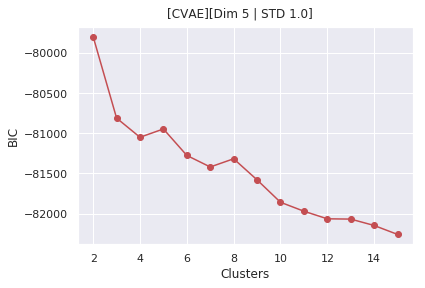

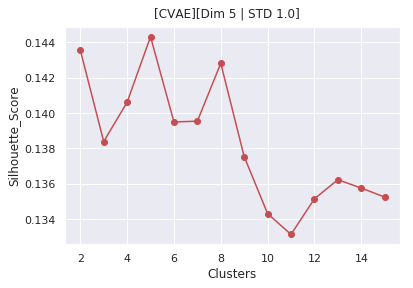

Computing GAP


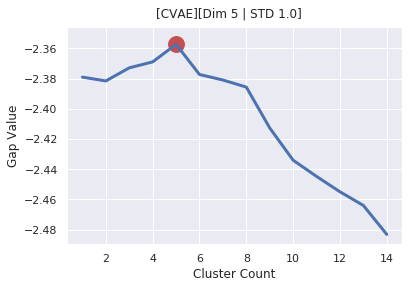

Computing GAP-2
Melho numero de clusters: 5


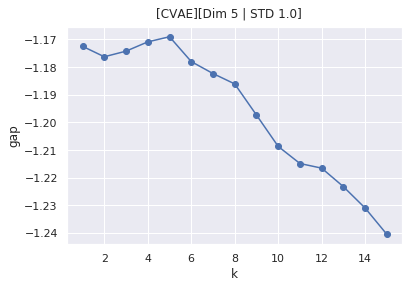

[Finished][CVAE]Lat_Dim=5 | STD=1.0
[CVAE]Lat_Dim=2 | STD=1.0
Computing KMeans
Computing BIC


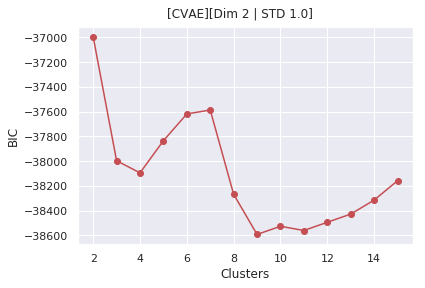

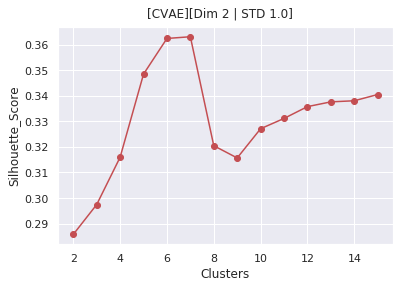

Computing GAP


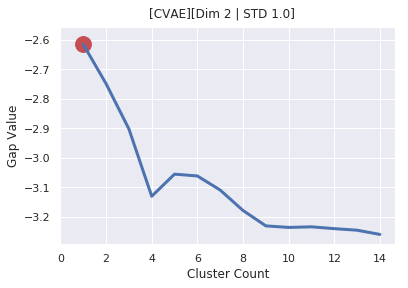

Computing GAP-2
Melho numero de clusters: 1


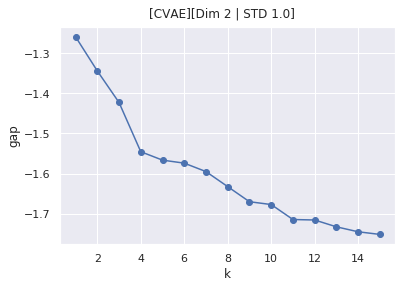

[Finished][CVAE]Lat_Dim=2 | STD=1.0
[VAE]Lat_Dim=3 | STD=1e-13
Computing KMeans
Computing BIC


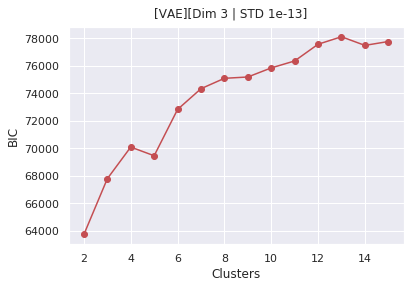

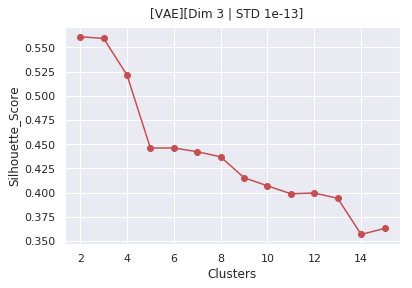

Computing GAP


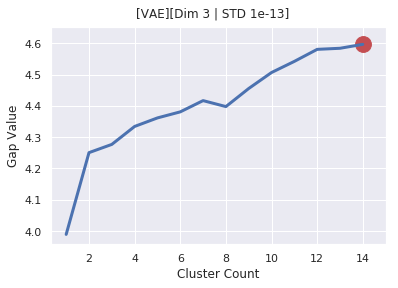

Computing GAP-2
Melho numero de clusters: 2


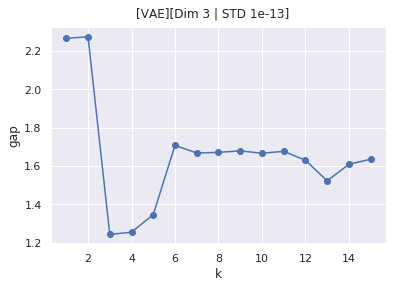

[Finished][VAE]Lat_Dim=3 | STD=1e-13
[VAE]Lat_Dim=6 | STD=0.5
Computing KMeans
Computing BIC


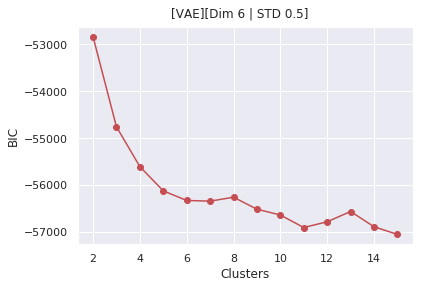

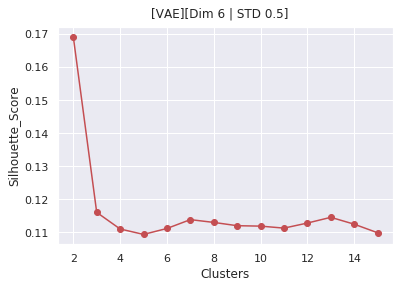

Computing GAP


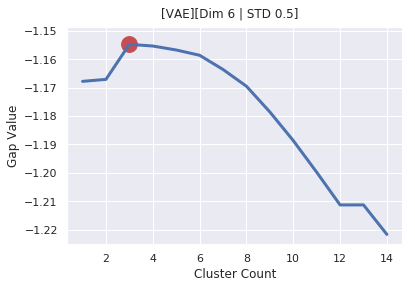

Computing GAP-2
Melho numero de clusters: 1


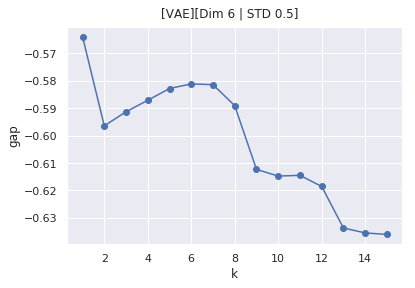

[Finished][VAE]Lat_Dim=6 | STD=0.5
[VAE]Lat_Dim=1 | STD=1e-13
Computing KMeans
Computing BIC


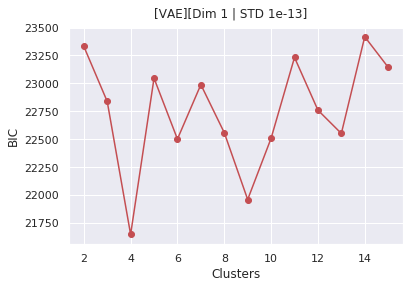

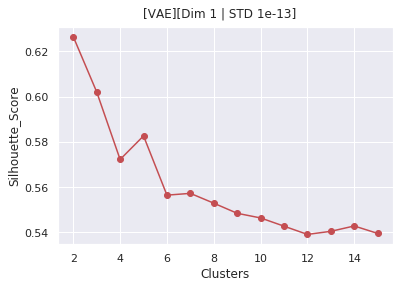

Computing GAP


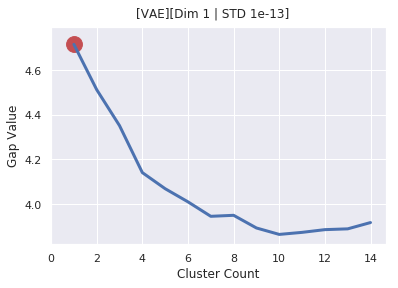

Computing GAP-2
Melho numero de clusters: 1


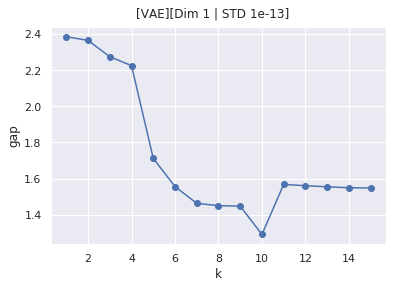

[Finished][VAE]Lat_Dim=1 | STD=1e-13
[CAE]Lat_Dim=3
[CVAE]Lat_Dim=2 | STD=1e-13
Computing KMeans
Computing BIC


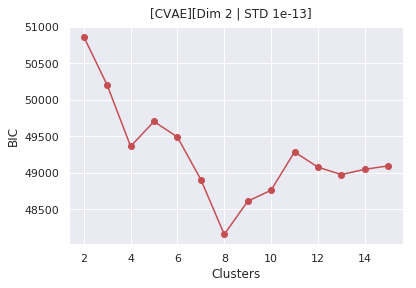

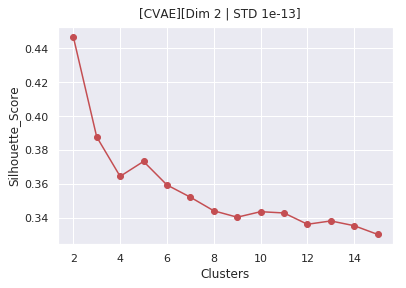

Computing GAP


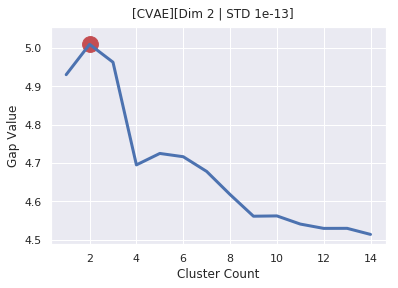

Computing GAP-2
Melho numero de clusters: 1


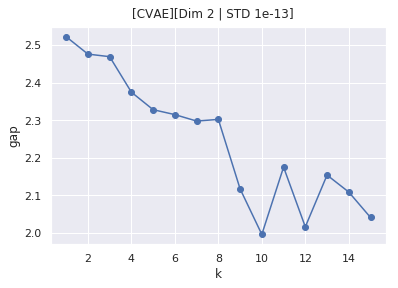

[Finished][CVAE]Lat_Dim=2 | STD=1e-13
[VAE]Lat_Dim=5 | STD=1.0
Computing KMeans
Computing BIC


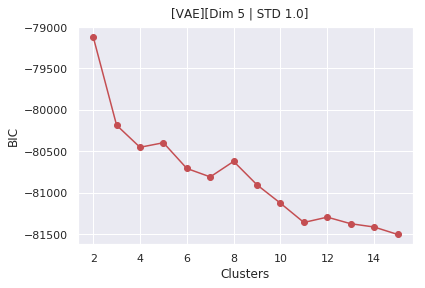

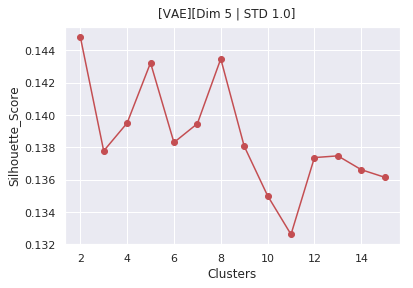

Computing GAP


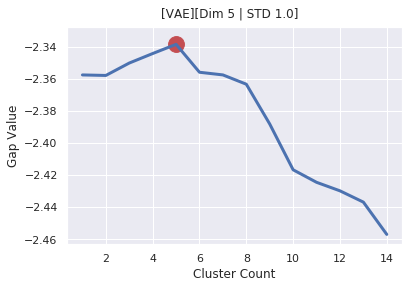

Computing GAP-2
Melho numero de clusters: 5


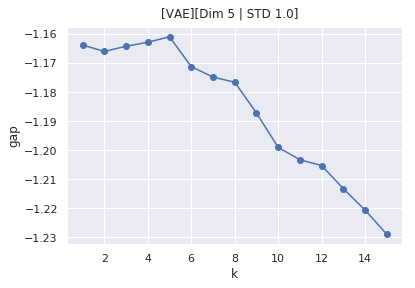

[Finished][VAE]Lat_Dim=5 | STD=1.0
[CVAE]Lat_Dim=4 | STD=1e-13
Computing KMeans
Computing BIC


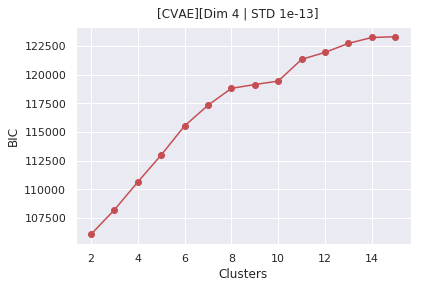

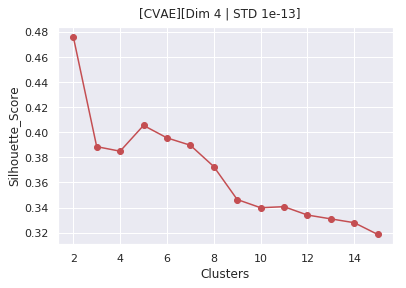

Computing GAP


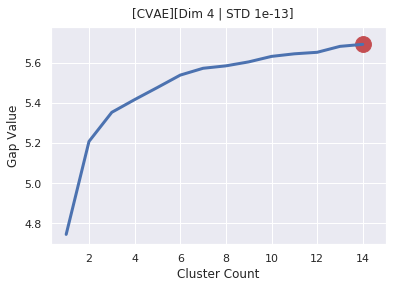

Computing GAP-2
Melho numero de clusters: 3


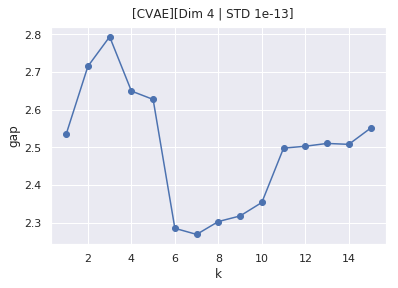

[Finished][CVAE]Lat_Dim=4 | STD=1e-13
[VAE]Lat_Dim=2 | STD=1e-13
Computing KMeans
Computing BIC


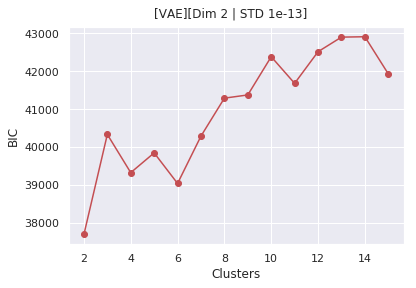

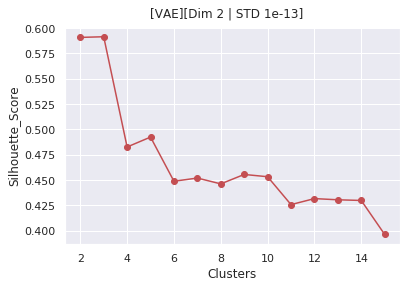

Computing GAP


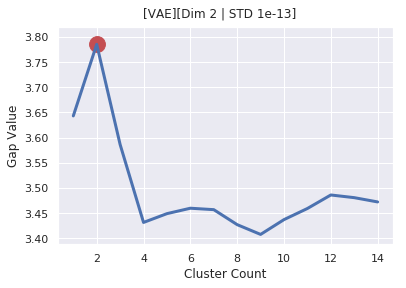

Computing GAP-2
Melho numero de clusters: 1


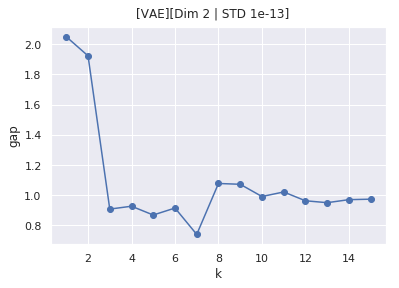

[Finished][VAE]Lat_Dim=2 | STD=1e-13
[CVAE]Lat_Dim=5 | STD=0.1
Computing KMeans
Computing BIC


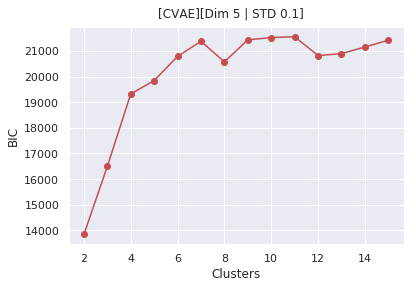

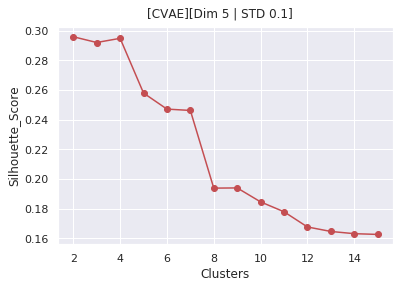

Computing GAP


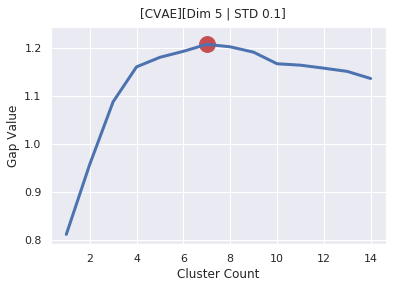

Computing GAP-2
Melho numero de clusters: 3


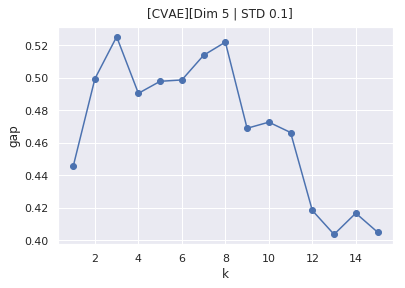

[Finished][CVAE]Lat_Dim=5 | STD=0.1
[CVAE]Lat_Dim=3 | STD=1.0
Computing KMeans
Computing BIC


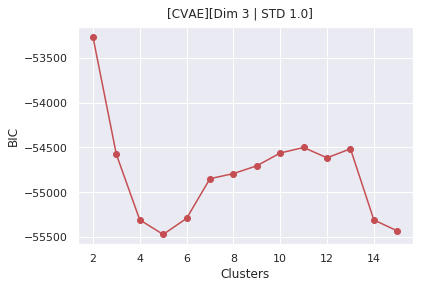

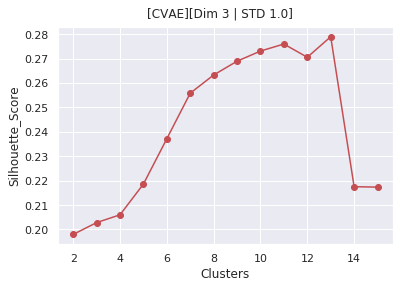

Computing GAP


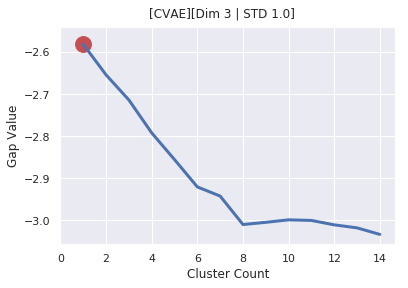

Computing GAP-2
Melho numero de clusters: 1


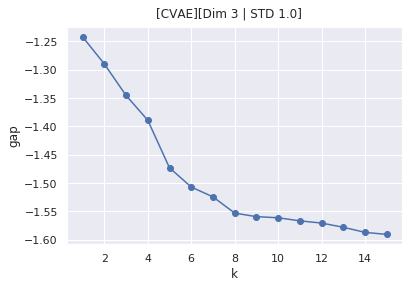

[Finished][CVAE]Lat_Dim=3 | STD=1.0
[CAE]Lat_Dim=2
[CVAE]Lat_Dim=1 | STD=0.1
Computing KMeans
Computing BIC


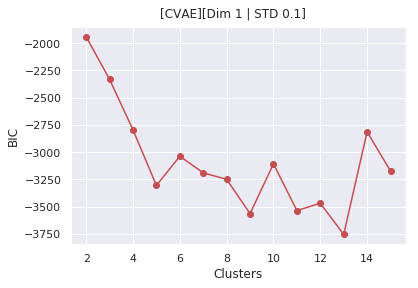

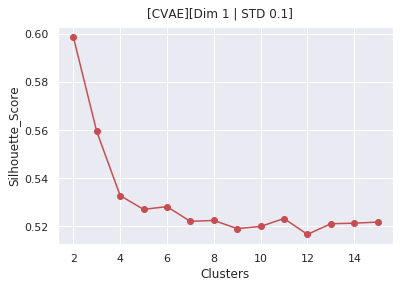

Computing GAP


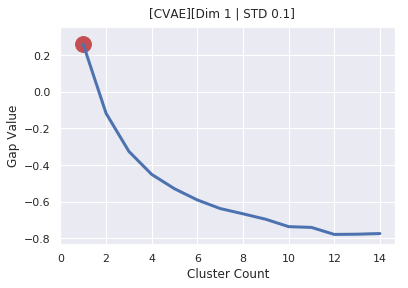

Computing GAP-2
Melho numero de clusters: 1


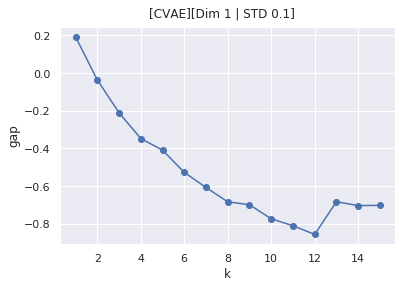

[Finished][CVAE]Lat_Dim=1 | STD=0.1


In [1]:
from Dirs import *
import os
import pandas as pd
import numpy as np
import random
import shutil
import seaborn as sns; sns.set()
import matplotlib.pyplot as plt
import itertools
%matplotlib inline

arquivos = os.listdir(latentSpace_dir)
arquivos.reverse()
classes = pd.read_csv("Training_Data")
labels = ["type1", "whan"]
porcentage = 0.9

for arquivo in arquivos:
    print(arquivo)
    if "Dim" not in arquivo:
        continue
    elif "[VAE]" in arquivo or "[CVAE]" in arquivo:

        df_tmp = pd.read_csv(latentSpace_dir +"/"+ arquivo, engine='python')
        features = []
        for i in range(df_tmp.shape[1]):
            features.append('Feature {}'.format(i+1))

        features.append("type1")
        features.append("whan")
        #print(classes.shape)
        type1 = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-2] )
        type1 = np.reshape(type1, (type1.shape[0],1))
        #print(df_tmp.values.shape, type1.shape)
        concat = np.concatenate([df_tmp.values, type1], axis = 1)
        whan = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-1])
        whan = np.reshape(whan, (whan.shape[0],1))
        concat = np.concatenate([concat, whan], axis = 1)
        df = pd.DataFrame(data = concat , columns = features)
        #print(df.head(5))
        #print(df.shape)
        labels = ["type1", "whan"]
        features.pop()
        features.pop()
        
        
        from sklearn import cluster
        from scipy.spatial import distance
        import sklearn.datasets
        from sklearn.preprocessing import StandardScaler
        import numpy as np
        
        from sklearn.metrics import silhouette_score
        from sklearn.cluster import KMeans

        def compute_bic(kmeans,X):
            """
            Computes the BIC metric for a given clusters

            Parameters:
            -----------------------------------------
            kmeans:  List of clustering object from scikit learn

            X     :  multidimension np array of data points

            Returns:
            -----------------------------------------
            BIC value
            """
            # assign centers and labels
            centers = [kmeans.cluster_centers_]
            labels  = kmeans.labels_
            #number of clusters
            m = kmeans.n_clusters
            # size of the clusters
            n = np.bincount(labels)
            #size of data set
            N, d = X.shape

            #compute variance for all clusters beforehand
            cl_var = (1.0 / (N - m) / d) * sum([sum(distance.cdist(X[np.where(labels == i)], [centers[0][i]], 
                     'euclidean')**2) for i in range(m)])

            const_term = 0.5 * m * np.log(N) * (d+1)

            BIC = np.sum([n[i] * np.log(n[i]) -
                       n[i] * np.log(N) -
                     ((n[i] * d) / 2) * np.log(2*np.pi*cl_var) -
                     ((n[i] - 1) * d/ 2) for i in range(m)]) - const_term

            return(BIC)
        
        from sklearn.cluster import KMeans

        def optimalK(data, nrefs=3, maxClusters=15):
            """
            Calculates KMeans optimal K using Gap Statistic from Tibshirani, Walther, Hastie
            Params:
                data: ndarry of shape (n_samples, n_features)
                nrefs: number of sample reference datasets to create
                maxClusters: Maximum number of clusters to test for
            Returns: (gaps, optimalK)
            """
            gaps = np.zeros((len(range(1, maxClusters)),))
            resultsdf = pd.DataFrame({'clusterCount':[], 'gap':[]})
            for gap_index, k in enumerate(range(1, maxClusters)):

                # Holder for reference dispersion results
                refDisps = np.zeros(nrefs)

                # For n references, generate random sample and perform kmeans getting resulting dispersion of each loop
                for i in range(nrefs):

                    # Create new random reference set
                    randomReference = np.random.random_sample(size=data.shape)

                    # Fit to it
                    km = KMeans(k)
                    km.fit(randomReference)

                    refDisp = km.inertia_
                    refDisps[i] = refDisp

                # Fit cluster to original data and create dispersion
                km = KMeans(k)
                km.fit(data)

                origDisp = km.inertia_

                # Calculate gap statistic
                gap = np.log(np.mean(refDisps)) - np.log(origDisp)

                # Assign this loop's gap statistic to gaps
                gaps[gap_index] = gap

                resultsdf = resultsdf.append({'clusterCount':k, 'gap':gap}, ignore_index=True)

            return (gaps.argmax() + 1, resultsdf)  # Plus 1 because index of 0 means 1 cluster is optimal, index 2 = 3 clusters are optimal


        X = df_tmp.values

        ks = range(2,16)

        print("Computing KMeans")
        # run 9 times kmeans and save each result in the KMeans object
        Kmeans = []
        score = []
        from sklearn.cluster import KMeans
        for i in ks:
            clusterer = KMeans(n_clusters=i).fit(X)
            Kmeans.append(clusterer)
            preds = clusterer.predict(X)
            centers = clusterer.cluster_centers_
            score.append(silhouette_score(X, preds, metric='euclidean'))
            
            
        print("Computing BIC")
        # now run for each cluster the BIC computation
        BIC = [compute_bic(kmeansi,X) for kmeansi in Kmeans]

        plt.plot(ks,BIC,'r-o')
        #plt.title("BIC vs N_clusters")
        plt.xlabel("Clusters")
        plt.ylabel("BIC")
        
        
        if "[CAE]" in arquivo:
            plt.suptitle("[CAE][Dim {}]".format(df_tmp.shape[1], fontsize = 12, y = 0.95))
            plt.savefig(plots_dir + '/CAE/' + 
                        '[Dim {}]BIC.png'.format(df_tmp.shape[1]))
        elif "[AE]" in arquivo:
            plt.suptitle("[AE][Dim {}]".format(df_tmp.shape[1], fontsize = 12, y = 0.95))
            plt.savefig(plots_dir + '/AE/' + 
                        '[Dim {}]BIC.png'.format(df_tmp.shape[1]))
        elif "[VAE]" in arquivo:
            std = arquivo.split("|")[1].split("=")[1]
            plt.suptitle("[VAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 12, y = 0.95)
            plt.savefig(plots_dir + '/VAE/' + 
                        '[Dim {} | STD {}]BIC.png'.format(df_tmp.shape[1],std))
        elif "[CVAE]" in arquivo:
            std = arquivo.split("|")[1].split("=")[1]
            plt.suptitle("[CVAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 12, y = 0.95)
            plt.savefig(plots_dir + '/CVAE/' + 
                        '[Dim {} | STD {}]BIC.png'.format(df_tmp.shape[1],std))
        
        plt.show()
        
        plt.plot(ks,score,'r-o')
        #plt.title("Silhouette_Score vs N_Clusters")
        plt.xlabel("Clusters")
        plt.ylabel("Silhouette_Score")
        if "[CAE]" in arquivo:
            plt.suptitle("[CAE][Dim {}]".format(df_tmp.shape[1], fontsize = 12, y = 0.95))
            plt.savefig(plots_dir + '/CAE/' + 
                        '[Dim {}]Silhouette.png'.format(df_tmp.shape[1]))
        elif "[AE]" in arquivo:
            plt.suptitle("[AE][Dim {}]".format(df_tmp.shape[1], fontsize = 12, y = 0.95))
            plt.savefig(plots_dir + '/AE/' + 
                        '[Dim {}]Silhouette.png'.format(df_tmp.shape[1]))
        elif "[VAE]" in arquivo:
            std = arquivo.split("|")[1].split("=")[1]
            plt.suptitle("[VAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 12, y = 0.95)
            plt.savefig(plots_dir + '/VAE/' + 
                        '[Dim {} | STD {}]Silhouette.png'.format(df_tmp.shape[1],std))
        elif "[CVAE]" in arquivo:
            std = arquivo.split("|")[1].split("=")[1]
            plt.suptitle("[CVAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 12, y = 0.95)
            plt.savefig(plots_dir + '/CVAE/' + 
                        '[Dim {} | STD {}]Silhouette.png'.format(df_tmp.shape[1],std))
        
        plt.show()
        
        print("Computing GAP")
        k, gapdf = optimalK(X, nrefs=5, maxClusters=15)
        #print ('Optimal k is: ', k)
        
        
        plt.plot(gapdf.clusterCount, gapdf.gap, linewidth=3)
        plt.scatter(gapdf[gapdf.clusterCount == k].clusterCount, gapdf[gapdf.clusterCount == k].gap, s=250, c='r')
        plt.grid(True)
        plt.xlabel('Cluster Count')
        plt.ylabel('Gap Value')
        #plt.title('Gap Values vs N_Cluster')
                                                                           
        if "[CAE]" in arquivo:
            plt.suptitle("[CAE][Dim {}]".format(df_tmp.shape[1], fontsize = 12, y = 0.95))
            plt.savefig(plots_dir + '/CAE/' + 
                        '[Dim {}]GAP.png'.format(df_tmp.shape[1]))
        elif "[AE]" in arquivo:
            plt.suptitle("[AE][Dim {}]".format(df_tmp.shape[1], fontsize = 12, y = 0.95))
            plt.savefig(plots_dir + '/AE/' + 
                        '[Dim {}]GAP.png'.format(df_tmp.shape[1]))
        elif "[VAE]" in arquivo:
            std = arquivo.split("|")[1].split("=")[1]
            plt.suptitle("[VAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 12, y = 0.95)
            plt.savefig(plots_dir + '/VAE/' + 
                        '[Dim {} | STD {}]GAP.png'.format(df_tmp.shape[1],std))
            
        elif "[CVAE]" in arquivo:
            std = arquivo.split("|")[1].split("=")[1]
            plt.suptitle("[CVAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 12, y = 0.95)
            plt.savefig(plots_dir + '/CVAE/' + 
                        '[Dim {} | STD {}]GAP.png'.format(df_tmp.shape[1],std))
        plt.show()
        
        
        import numpy as np
        import matplotlib.pyplot as plt
        from sklearn.datasets import make_blobs
        from sklearn.metrics import pairwise_distances
        from sklearn.cluster import KMeans

        reference = np.random.rand(X.shape[0], X.shape[1])



        def compute_inertia(a, X):
            W = [np.mean(pairwise_distances(X[a == c, :])) for c in np.unique(a)]
            return np.mean(W)
        def compute_gap(clustering, k_max=10, n_references=5):
            reference_inertia = []
            for k in range(1, k_max+1):
                local_inertia = []
                for _ in range(n_references):
                    clustering.n_clusters = k
                    assignments = clustering.fit_predict(reference)
                    local_inertia.append(compute_inertia(assignments, reference))
                reference_inertia.append(np.mean(local_inertia))
            ondata_inertia = []
            for k in range(1, k_max+1):
                clustering.n_clusters = k
                assignments = clustering.fit_predict(X)
                ondata_inertia.append(compute_inertia(assignments, X))
            gap = np.log(reference_inertia)-np.log(ondata_inertia)
            return gap, np.log(reference_inertia), np.log(ondata_inertia)

        k_max = 15
        
        print("Computing GAP-2")
        
        gap, reference_inertia, ondata_inertia = compute_gap(KMeans(), k_max)


        
        plt.plot(range(1, k_max+1), gap, '-o')
        plt.ylabel('gap')
        plt.xlabel('k')
        print("Melho numero de clusters:" ,np.argmax(gap) + 1)
        
        if "[CAE]" in arquivo:
            plt.suptitle("[CAE][Dim {}]".format(df_tmp.shape[1], fontsize = 12, y = 0.95))
            plt.savefig(plots_dir + '/CAE/' + 
                        '[Dim {}]GAP2.png'.format(df_tmp.shape[1]))
        elif "[AE]" in arquivo:
            plt.suptitle("[AE][Dim {}]".format(df_tmp.shape[1], fontsize = 12, y = 0.95))
            plt.savefig(plots_dir + '/AE/' + 
                        '[Dim {}]GAP2.png'.format(df_tmp.shape[1]))
        elif "[VAE]" in arquivo:
            std = arquivo.split("|")[1].split("=")[1]
            plt.suptitle("[VAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 12, y = 0.95)
            plt.savefig(plots_dir + '/VAE/' + 
                        '[Dim {} | STD {}]GAP2.png'.format(df_tmp.shape[1],std))
            
        elif "[CVAE]" in arquivo:
            std = arquivo.split("|")[1].split("=")[1]
            plt.suptitle("[CVAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 12, y = 0.95)
            plt.savefig(plots_dir + '/CVAE/' + 
                        '[Dim {} | STD {}]GAP2.png'.format(df_tmp.shape[1],std))
        
        
        plt.show()
        
        
        print(f"[Finished]{arquivo}")
        
        
        
        

Iniciando...


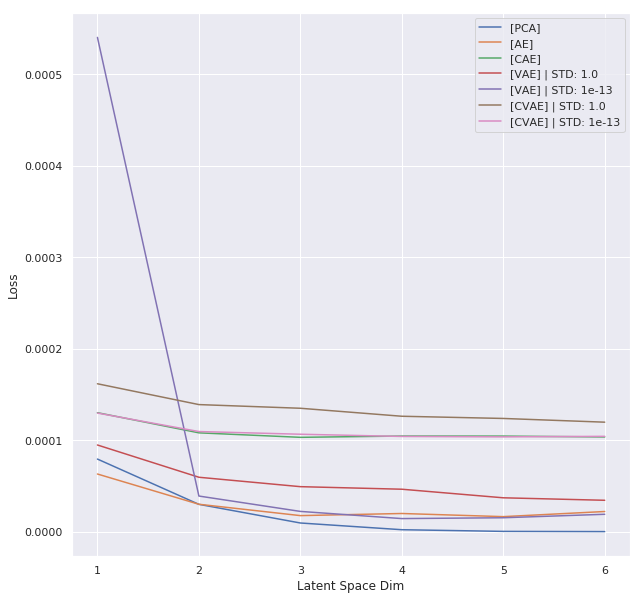

In [11]:
import pandas as pd
import matplotlib.pyplot as plt
import os
import time
from Dirs import *
from Data import *
from sklearn.decomposition import PCA

print("Iniciando...")
start = time.time()
arquivos = os.listdir(lossEpoch_dir)
arquivos = sorted(arquivos)
dims = range(1,7)
models = ["[AE]","[CAE]","[VAE]","[CVAE]"]
epsilon = [1.0, 0.5, 0.1, 1e-13]

fig = plt.figure(figsize=(10, 10))

##PCA


loss = []
for i in range(1,7):
    pca = PCA(n_components=i)
    predict = pca.fit_transform(x_test)

    X_projected = pca.inverse_transform(predict)
    loss.append(((x_test - X_projected) ** 2).mean())
    
plt.plot(dims, loss, label = "[PCA]")

plt.legend(loc = "upper right")
plt.xlabel("Latent Space Dim")
plt.ylabel("Loss")



data = []
std_tmp = 0
for model in models:
    loss = []
    for arquivo in arquivos:
        if model in arquivo:
        
    #if models[modelo] in arquivos[arquivo]:
            
            df = pd.read_csv(lossEpoch_dir + '/' + arquivo)
            fragmentos_arquivo = arquivo.split("||")
            

            if len(fragmentos_arquivo) == 2:
                dim = fragmentos_arquivo[1].split("=")
                loss.append(df.values[-1,0])
            
            
            else:
                dim = fragmentos_arquivo[2].split("=")
                
                std = fragmentos_arquivo[1].split("=")
                
                if std[1] == 1.0:
                    continue
                elif std_tmp == 0:
                    std_tmp = std[1]
                    #loss.append(df.values[-1,0])
                
                elif std[1] != std_tmp:
                    plt.plot(dims, loss, label = model + " | " + f"STD: {std_tmp}")
                    plt.legend(loc = "upper right")
                    plt.xlabel("Latent Space Dim")
                    plt.ylabel("Loss")
                    std_tmp = std[1]
                    loss = []
                
                loss.append(df.values[-1,0])

    if model == "[AE]" or model == "[CAE]":       
        #ax = fig.add_subplot(111)
        plt.plot(dims, loss, label = model)

        plt.legend(loc = "upper right")
        plt.xlabel("Latent Space Dim")
        plt.ylabel("Loss")


    else:
        plt.plot(dims, loss, label = model + " | " + f"STD: {std_tmp}")
        plt.legend(loc = "upper right")
        plt.xlabel("Latent Space Dim")
        plt.ylabel("Loss")
        std_tmp = 0
    
    
    
    
    
    
plt.savefig("Loss x Dim.png")    
    
    
    
plt.show()
    

            

[CAE]Lat_Dim=2
GMM Accuracy: 0.76


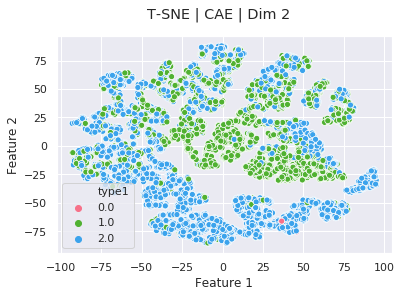

GMM Accuracy: 0.62


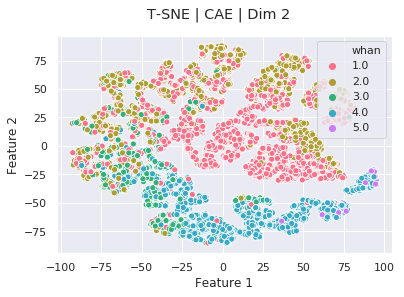

[CVAE]Lat_Dim=3 | STD=1.0
GMM Accuracy: 0.73


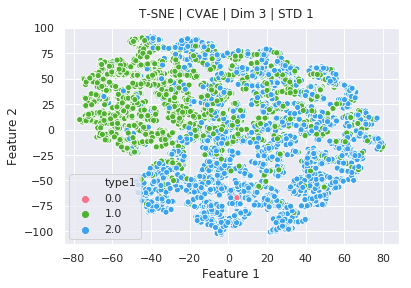

GMM Accuracy: 0.59


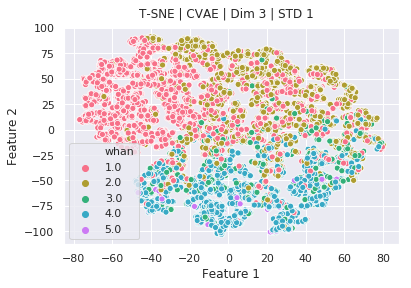

[VAE]Lat_Dim=2 | STD=1e-13
GMM Accuracy: 0.73


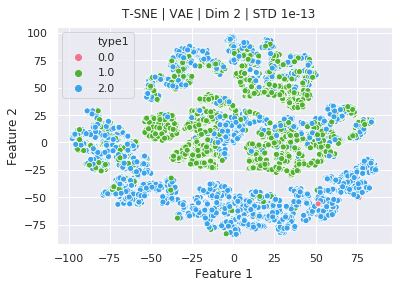

GMM Accuracy: 0.63


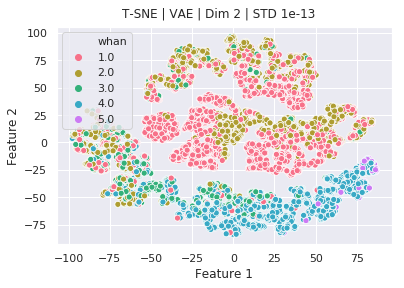

[CVAE]Lat_Dim=4 | STD=1e-13
GMM Accuracy: 0.68


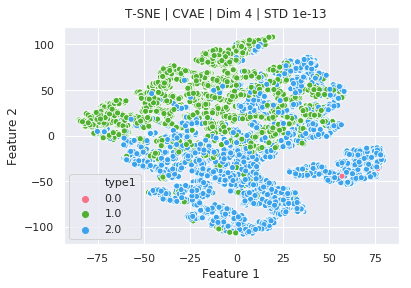

GMM Accuracy: 0.61


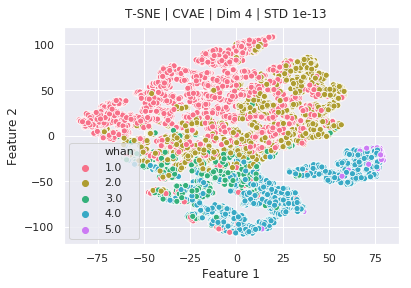

[VAE]Lat_Dim=5 | STD=1.0
GMM Accuracy: 0.74


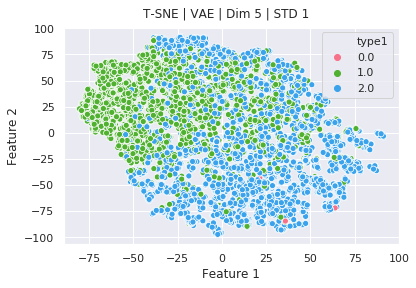

GMM Accuracy: 0.60


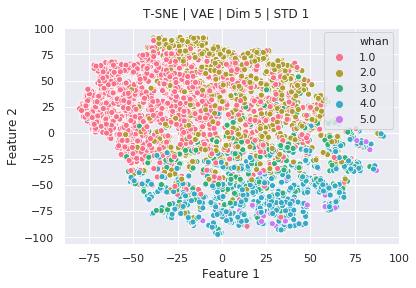

[CVAE]Lat_Dim=2 | STD=1e-13
GMM Accuracy: 0.66


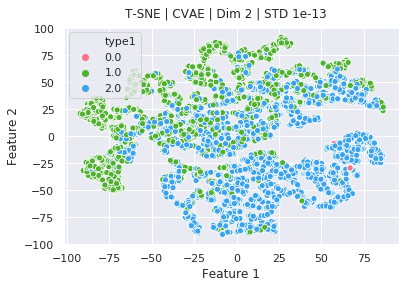

GMM Accuracy: 0.57


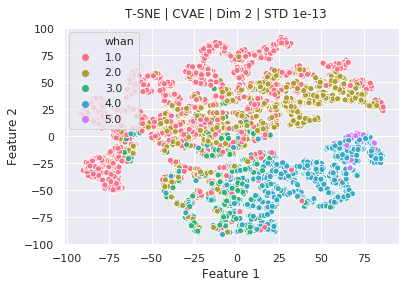

[CAE]Lat_Dim=3
GMM Accuracy: 0.68


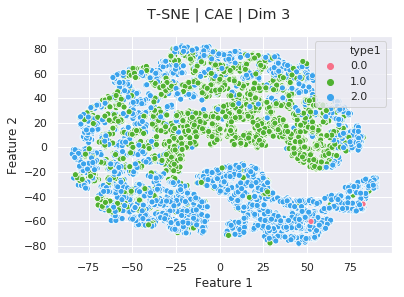

GMM Accuracy: 0.64


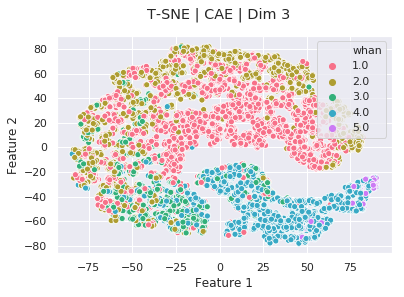

[VAE]Lat_Dim=3 | STD=1e-13
GMM Accuracy: 0.75


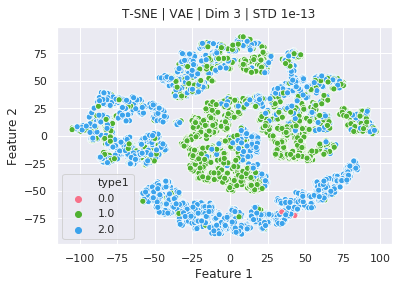

GMM Accuracy: 0.61


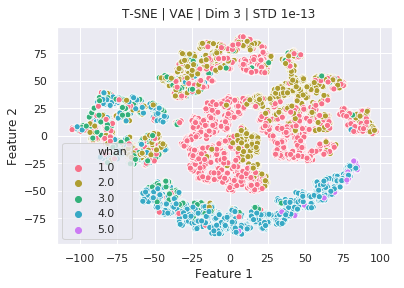

[CVAE]Lat_Dim=2 | STD=1.0
GMM Accuracy: 0.72


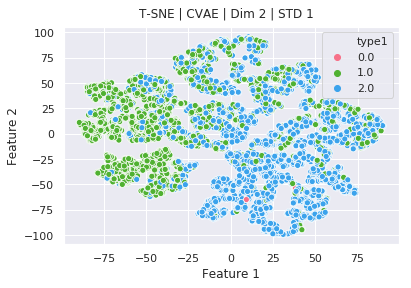

GMM Accuracy: 0.63


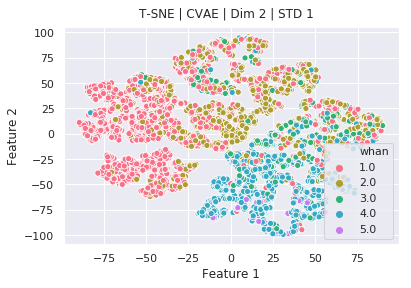

[CVAE]Lat_Dim=5 | STD=1.0
GMM Accuracy: 0.72


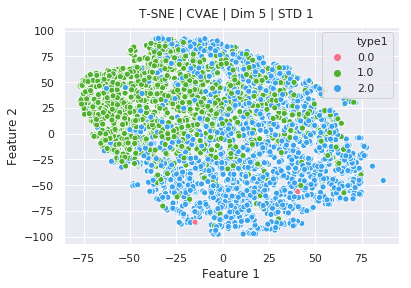

GMM Accuracy: 0.61


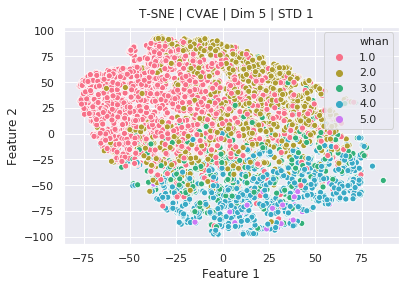

[CAE]Lat_Dim=5
GMM Accuracy: 0.73


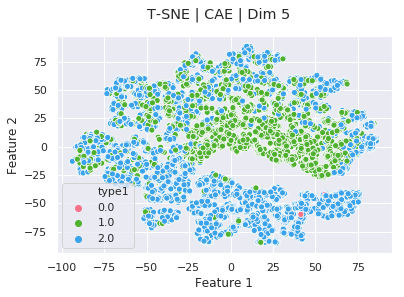

GMM Accuracy: 0.59


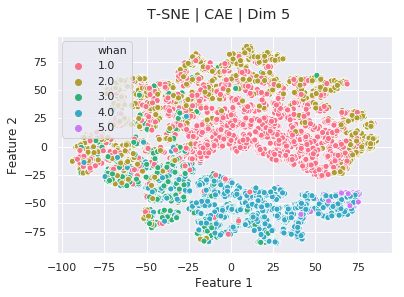

[AE]Lat_Dim=2
GMM Accuracy: 0.72


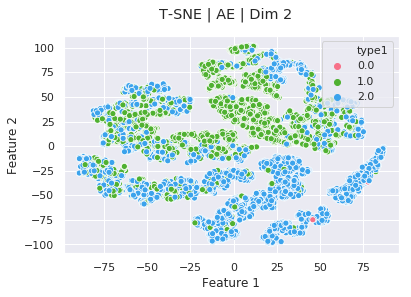

GMM Accuracy: 0.62


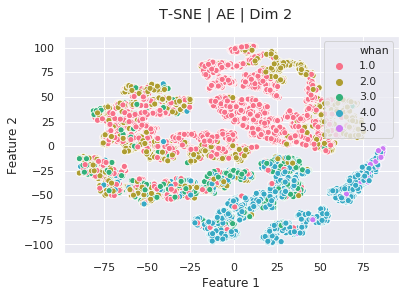

[CVAE]Lat_Dim=3 | STD=1e-13
GMM Accuracy: 0.69


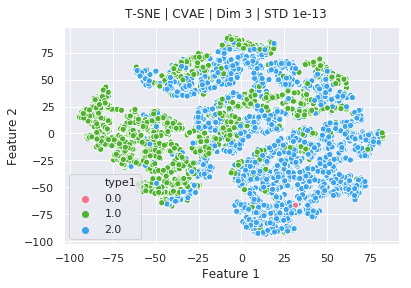

GMM Accuracy: 0.62


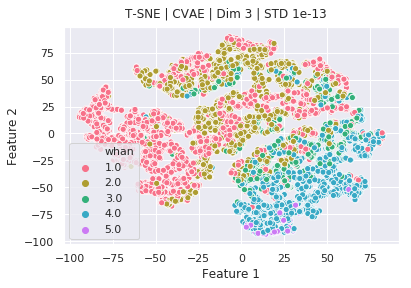

.ipynb_checkpoints
[VAE]Lat_Dim=5 | STD=1e-13
GMM Accuracy: 0.74


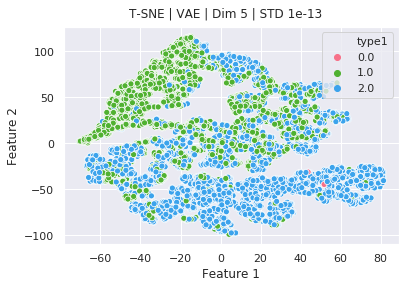

GMM Accuracy: 0.56


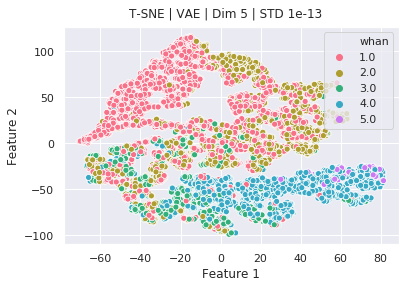

[VAE]Lat_Dim=6 | STD=1e-13
GMM Accuracy: 0.72


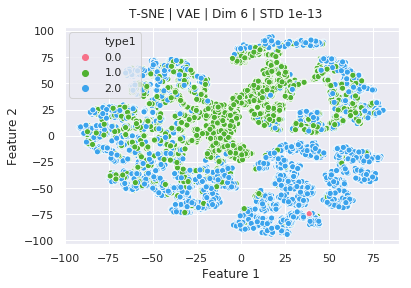

GMM Accuracy: 0.61


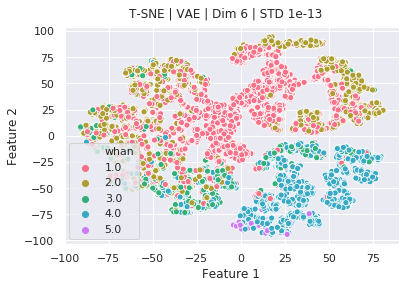

[VAE]Lat_Dim=3 | STD=1.0
GMM Accuracy: 0.71


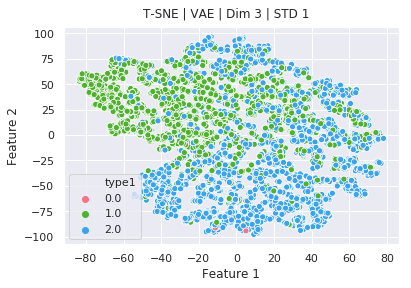

GMM Accuracy: 0.59


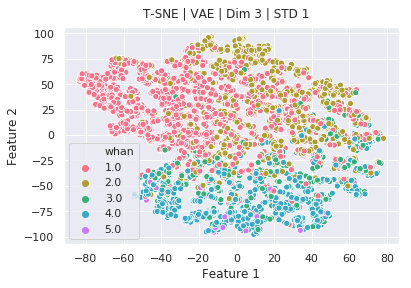

[VAE]Lat_Dim=2 | STD=1.0
GMM Accuracy: 0.74


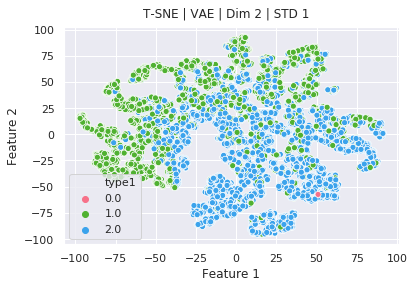

GMM Accuracy: 0.58


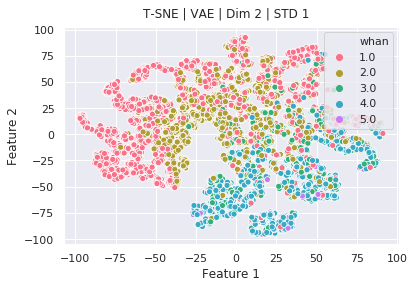

[AE]Lat_Dim=3
GMM Accuracy: 0.73


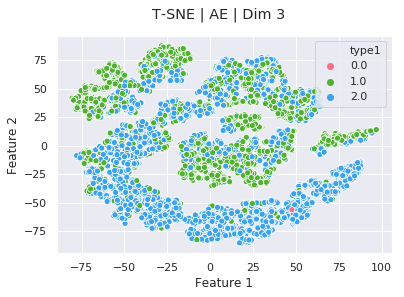

GMM Accuracy: 0.62


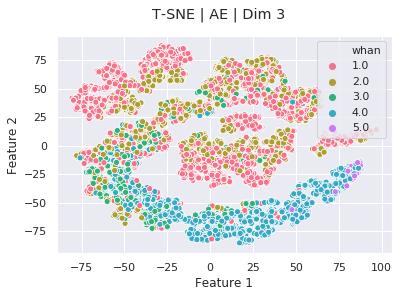

[AE]Lat_Dim=5
GMM Accuracy: 0.73


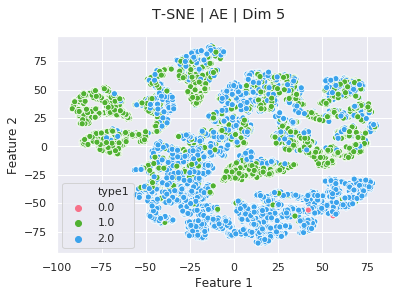

GMM Accuracy: 0.59


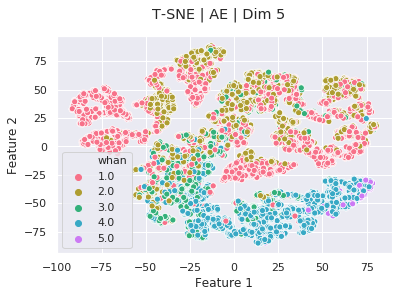

[VAE]Lat_Dim=4 | STD=1.0
GMM Accuracy: 0.72


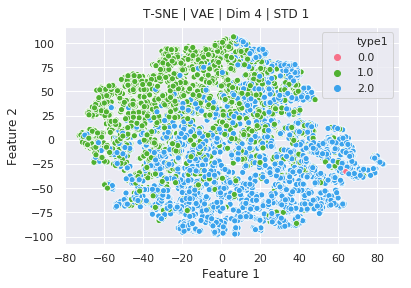

GMM Accuracy: 0.60


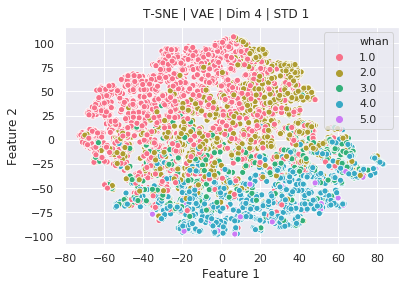

[CVAE]Lat_Dim=6 | STD=1e-13
GMM Accuracy: 0.71


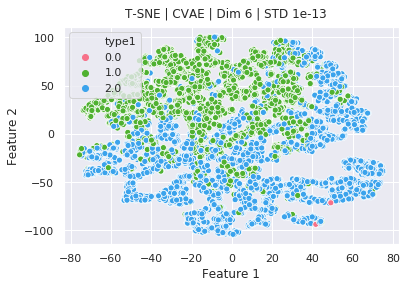

GMM Accuracy: 0.62


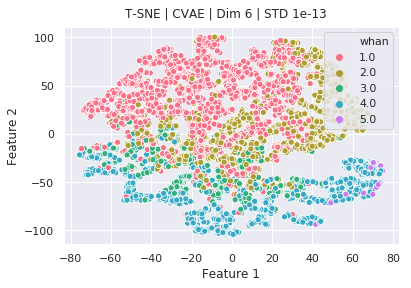

[AE]Lat_Dim=4
GMM Accuracy: 0.74


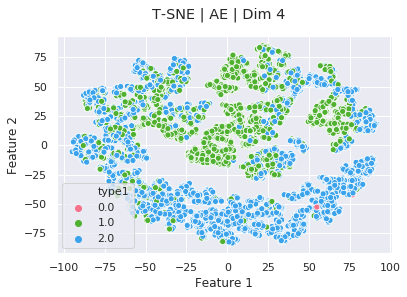

GMM Accuracy: 0.59


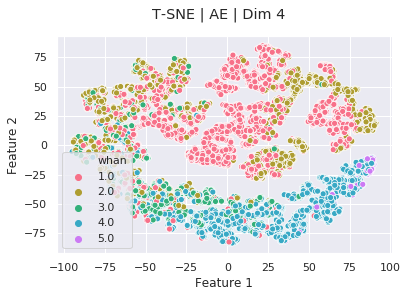

[CAE]Lat_Dim=6
GMM Accuracy: 0.71


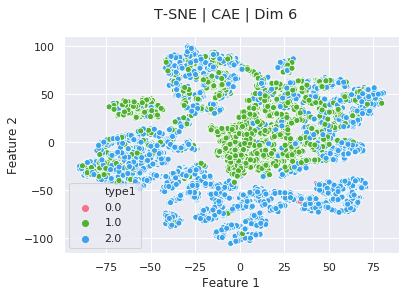

GMM Accuracy: 0.63


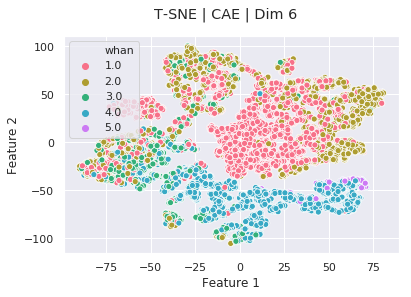

[VAE]Lat_Dim=4 | STD=1e-13
GMM Accuracy: 0.76


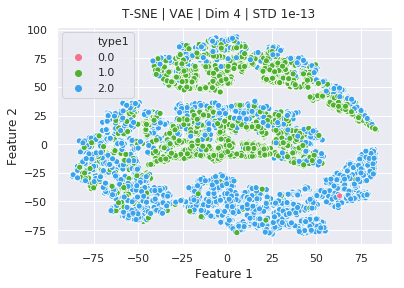

GMM Accuracy: 0.57


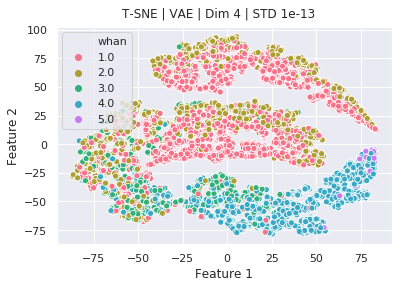

[CVAE]Lat_Dim=5 | STD=1e-13
GMM Accuracy: 0.69


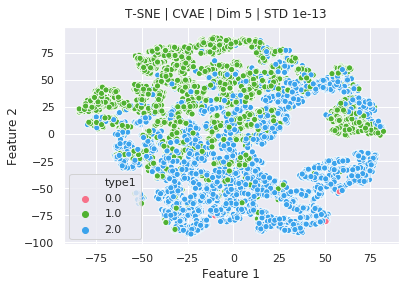

GMM Accuracy: 0.62


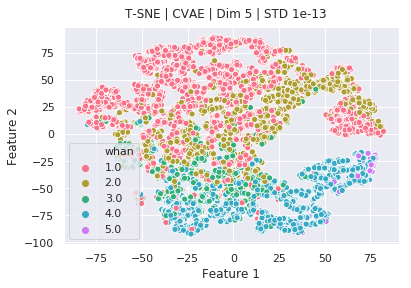

[VAE]Lat_Dim=6 | STD=1.0
GMM Accuracy: 0.74


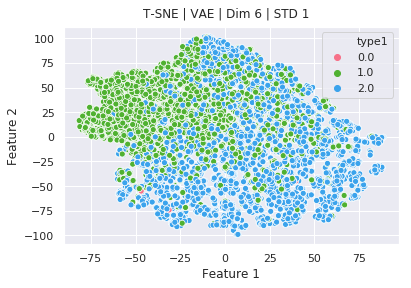

GMM Accuracy: 0.55


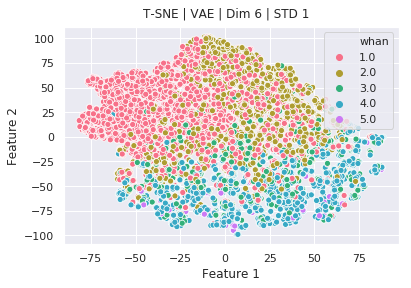

[CAE]Lat_Dim=4
GMM Accuracy: 0.73


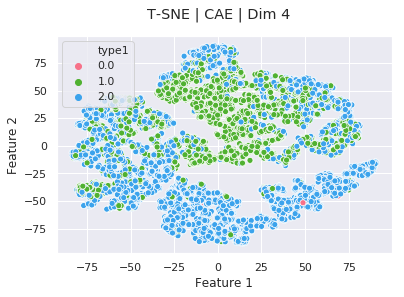

GMM Accuracy: 0.56


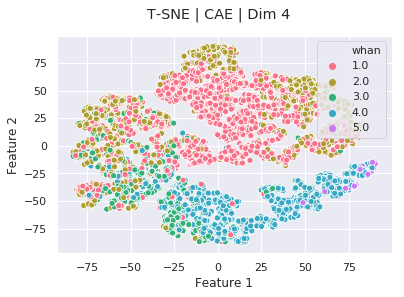

[AE]Lat_Dim=6
GMM Accuracy: 0.73


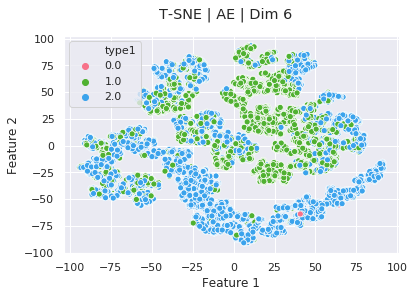

GMM Accuracy: 0.60


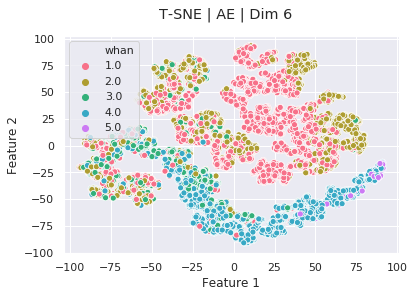

[CVAE]Lat_Dim=6 | STD=1.0
GMM Accuracy: 0.73


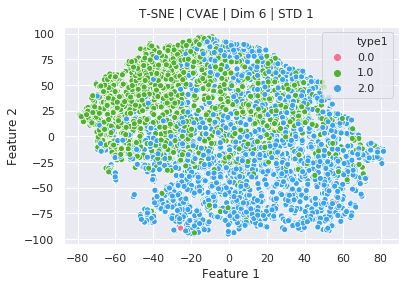

GMM Accuracy: 0.60


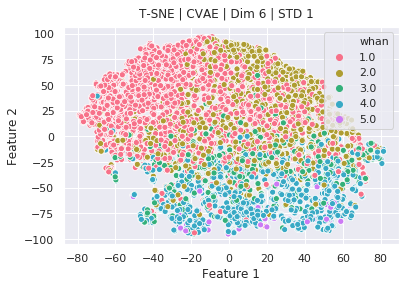

[CVAE]Lat_Dim=4 | STD=1.0
GMM Accuracy: 0.71


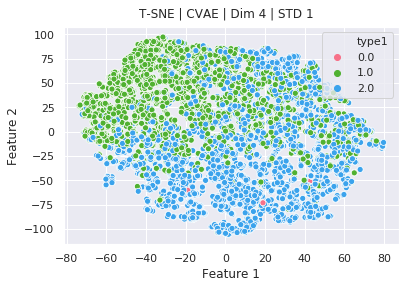

GMM Accuracy: 0.59


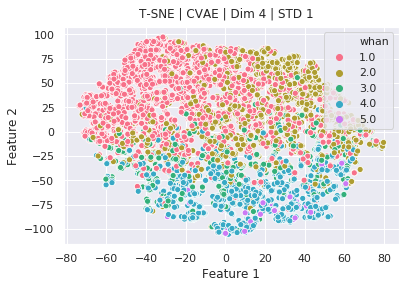

In [1]:
from sklearn.manifold import TSNE
from Dirs import *
import os
import pandas as pd
import numpy as np
import random
import shutil
import seaborn as sns; sns.set()
import matplotlib.pyplot as plt
import itertools
%matplotlib inline
import itertools
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

arquivos = os.listdir(latentSpace_dir)
classes = pd.read_csv("Training_Data")
labels = ["type1", "whan"]
porcentage = 0.9

for arquivo in arquivos:
    print(arquivo)
    if "Dim" not in arquivo:
        continue
    elif True:

        df_tmp = pd.read_csv(latentSpace_dir +"/"+ arquivo, engine='python')
        features = []
        for i in range(df_tmp.shape[1]):
            features.append('Feature {}'.format(i+1))

        features.append("type1")
        features.append("whan")
        #print(classes.shape)
        type1 = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-2] )
        type1 = np.reshape(type1, (type1.shape[0],1))
        #print(df_tmp.values.shape, type1.shape)
        concat = np.concatenate([df_tmp.values, type1], axis = 1)
        whan = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-1])
        whan = np.reshape(whan, (whan.shape[0],1))
        concat = np.concatenate([concat, whan], axis = 1)
        df = pd.DataFrame(data = concat , columns = features)
        #print(df.head(5))
        #print(df.shape)
        labels = ["type1", "whan"]
        features.pop()
        features.pop()


        # Project the data: this step will take several seconds
        tsne = TSNE(n_components=2, init='random', random_state=0)
        digits_proj = tsne.fit_transform(df.values[:,:-2])
        #print("**T-SNE**")
        

        features = []
        for i in range(digits_proj.shape[1]):
            features.append('Feature {}'.format(i+1))

        features.append("type1")
        features.append("whan")
        #type1 = np.copy(train_df.values[:,-2])
        #type1 = np.copy(train_df.values[int(train_df.shape[0] * porcentage):, -2])
        #type1 = np.reshape(type1, (type1.shape[0],1))
        concat = np.concatenate([digits_proj, type1], axis = 1)
        #whan = np.copy(train_df.values[:,-1])
        #whan = np.copy(train_df.values[int(train_df.shape[0] * porcentage):, -1])
        #whan = np.reshape(whan, (whan.shape[0],1))
        concat = np.concatenate([concat, whan], axis = 1)
        tse_df = pd.DataFrame(data = concat , columns = features)

        labels = ["type1", "whan"]
        for label in labels:

            y_test = df[label].values
            y_test = np.reshape(y_test, (y_test.shape[0],1))
        
            from sklearn.mixture import GaussianMixture
            n_clusters = len(np.unique(y_test))
            gmm = GaussianMixture(n_components=n_clusters, n_init= 20, covariance_type= 'full')
            y_pred_gmm = gmm.fit_predict(df_tmp.values)

            from scipy.stats import mode
            y_pred_gmm = np.reshape(y_pred_gmm, (y_pred_gmm.shape[0],1))
            labels = np.zeros_like(y_pred_gmm)
            for i in range(n_clusters):
                mask = (y_pred_gmm == i)
                labels[mask] = mode(y_test[mask])[0]


            from sklearn.metrics import accuracy_score
            print("GMM Accuracy: {:.2f}".format(accuracy_score(y_test, labels)))
            
            plt.figure()  
            sns.scatterplot(x="Feature %d" % (1) , y="Feature %d" % (2), palette = sns.color_palette("husl", len(np.unique(df[label]))),
                         hue=label, data=tse_df)


            if "[CAE]" in arquivo:
                plt.suptitle("T-SNE | CAE | Dim {}".format(df_tmp.shape[1], fontsize = 12, y = 0.95))
                #plt.savefig(tsne_dir + '/CAE/' + 
                #            '[CAE] | T-SNE | Dim {} | Type: {}.png'.format(df_tmp.shape[1], label))
            elif "[AE]" in arquivo:
                plt.suptitle("T-SNE | AE | Dim {}".format(df_tmp.shape[1], fontsize = 12, y = 0.95))
                #plt.savefig(tsne_dir + '/AE/' + 
                #            '[AE] | T-SNE | Dim {} | Type: {}.png'.format(df_tmp.shape[1], label))
            elif "[VAE]" in arquivo:
                std = arquivo.split("|")[1].split(".")[0].split("=")[1]
                plt.suptitle("T-SNE | VAE | Dim {} | STD {}".format(df_tmp.shape[1],std), fontsize = 12, y = 0.95)
                #plt.savefig(tsne_dir + '/VAE/' + 
                #            '[VAE] | T-SNE | STD {} | Dim {} | Type: {}.png'.format(std, df_tmp.shape[1], label))

            elif "[CVAE]" in arquivo:
                std = arquivo.split("|")[1].split(".")[0].split("=")[1]
                plt.suptitle("T-SNE | CVAE | Dim {} | STD {}".format(df_tmp.shape[1],std), fontsize = 12, y = 0.95)
                #plt.savefig(tsne_dir + '/CVAE/' + 
                #            '[CVAE] | T-SNE | STD {} | Dim {} | Type: {}.png'.format(std, df_tmp.shape[1], label))

            plt.show()

In [1]:
from sklearn.manifold import TSNE
from Dirs import *
import os
import pandas as pd
import numpy as np
import random
import shutil
import seaborn as sns; sns.set()
import matplotlib.pyplot as plt
import itertools
%matplotlib inline
import itertools
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
from IPython.display import clear_output
from sklearn.cluster import KMeans
from sklearn.cluster import SpectralClustering
from sklearn.mixture import GaussianMixture

arquivos = os.listdir(latentSpace_dir)
classes = pd.read_csv("Training_Data")
labels = ["type1", "whan"]
porcentage = 0.9

results = np.array([["Model","Dim", "STD", "K-Means", "Spectral", "GMM"]])

for arquivo in arquivos:
    #print(arquivo)
    if "Dim" not in arquivo:
        continue
    elif True:

        df_tmp = pd.read_csv(latentSpace_dir +"/"+ arquivo, engine='python')
        features = []
        for i in range(df_tmp.shape[1]):
            features.append('Feature {}'.format(i+1))

        features.append("type1")
        features.append("whan")
        #print(classes.shape)
        type1 = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-2] )
        type1 = np.reshape(type1, (type1.shape[0],1))
        #print(df_tmp.values.shape, type1.shape)
        concat = np.concatenate([df_tmp.values, type1], axis = 1)
        whan = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-1])
        whan = np.reshape(whan, (whan.shape[0],1))
        concat = np.concatenate([concat, whan], axis = 1)
        df = pd.DataFrame(data = concat , columns = features)
        #print(df.head(5))
        #print(df.shape)
        labels = ["type1", "whan"]
        features.pop()
        features.pop()
            
        labels = ["type1"]
        for label in labels:
    
            tmp = []
    
            if "[AE]" in arquivo:
                tmp.append("AE")
                tmp.append(str(df_tmp.shape[1]))
                tmp.append("-")
            elif "[CAE]" in arquivo:
                tmp.append("CAE")
                tmp.append(str(df_tmp.shape[1]))
                tmp.append("-")
            elif "[VAE]" in arquivo:
                tmp.append("VAE")
                tmp.append(str(df_tmp.shape[1]))
                std = arquivo.split("|")[1].split(".")[0].split("=")[1]
                tmp.append(str(std))
            elif "[CVAE]" in arquivo:
                tmp.append("CVAE")
                tmp.append(str(df_tmp.shape[1]))
                std = arquivo.split("|")[1].split(".")[0].split("=")[1]
                tmp.append(str(std))
            
            
            y_test = df[label].values
            y_test = np.reshape(y_test, (y_test.shape[0],1))
            #print("Iniciando")
            #K-MEANS
            n_clusters = len(np.unique(y_test))
            kmeans = KMeans(n_clusters=n_clusters, n_init=20)
            y_pred_kmeans = kmeans.fit_predict(df_tmp.values)

            from scipy.stats import mode
            y_pred_kmeans = np.reshape(y_pred_kmeans, (y_pred_kmeans.shape[0],1))
            labels = np.zeros_like(y_pred_kmeans)
            for i in range(n_clusters):
                mask = (y_pred_kmeans == i)
                labels[mask] = mode(y_test[mask])[0]

            from sklearn.metrics import accuracy_score
            score_kmeans = accuracy_score(y_test, labels)
            tmp.append((str(score_kmeans*100))[:4])
            #print(score_kmeans)
                       
            #SPECTRAL
            n_clusters = len(np.unique(y_test))
            model = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors',
                                       assign_labels='kmeans', n_init= 20)
            y_pred_spec = model.fit_predict(df_tmp.values)


            from scipy.stats import mode
            y_pred_spec = np.reshape(y_pred_spec, (y_pred_spec.shape[0],1))
            labels = np.zeros_like(y_pred_spec)
            for i in range(n_clusters):
                mask = (y_pred_spec == i)
                labels[mask] = mode(y_test[mask])[0]


            from sklearn.metrics import accuracy_score
            score_spec = accuracy_score(y_test, labels)
            tmp.append((str(score_spec*100))[:4])
            #print(score_spec)
            
            
            #GMM
            n_clusters = len(np.unique(y_test))
            gmm = GaussianMixture(n_components=n_clusters, n_init= 20, covariance_type= 'full')
            y_pred_gmm = gmm.fit_predict(df_tmp.values)

            from scipy.stats import mode
            y_pred_gmm = np.reshape(y_pred_gmm, (y_pred_gmm.shape[0],1))
            labels = np.zeros_like(y_pred_gmm)
            for i in range(n_clusters):
                mask = (y_pred_gmm == i)
                labels[mask] = mode(y_test[mask])[0]


            from sklearn.metrics import accuracy_score
            score_gmm = accuracy_score(y_test, labels)
            #print("GMM Accuracy: {:.2f}".format(score_gmm))
            tmp.append((str(score_gmm*100))[:4])
            #print(score_gmm)
                       
            #print(tmp)
            tmp = np.array([tmp])
            #print(tmp)
            results = np.concatenate([results,tmp], axis=0)
            clear_output()
            print(results)
            
df = pd.DataFrame(data = results[1:,:], columns= results[0,:])
df.to_csv("Clustering Algorithms Results.csv", index=False)

df.head()
            
            
            
            
            

[['Model' 'Dim' 'STD' 'K-Means' 'Spectral' 'GMM']
 ['CAE' '2' '-' '72.1' '72.2' '76.1']
 ['CVAE' '3' '1' '71.1' '72.0' '73.0']
 ['VAE' '2' '1e-13' '73.8' '72.5' '73.3']
 ['CVAE' '4' '1e-13' '74.0' '74.7' '67.5']
 ['VAE' '5' '1' '71.2' '70.9' '74.0']
 ['CVAE' '2' '1e-13' '67.5' '61.1' '65.6']
 ['CAE' '3' '-' '69.4' '72.4' '67.9']
 ['VAE' '3' '1e-13' '73.7' '75.6' '75.0']
 ['CVAE' '2' '1' '70.6' '71.1' '71.9']
 ['CVAE' '5' '1' '72.0' '70.9' '72.0']
 ['CAE' '5' '-' '70.9' '73.3' '72.9']
 ['AE' '2' '-' '72.0' '73.2' '71.7']
 ['CVAE' '3' '1e-13' '75.9' '75.9' '68.4']
 ['VAE' '5' '1e-13' '74.4' '70.4' '73.8']
 ['VAE' '6' '1e-13' '69.5' '64.4' '72.2']
 ['VAE' '3' '1' '70.7' '69.6' '71.3']
 ['VAE' '2' '1' '73.2' '70.8' '73.7']
 ['AE' '3' '-' '72.6' '71.4' '73.4']
 ['AE' '5' '-' '72.6' '70.8' '73.1']
 ['VAE' '4' '1' '70.7' '68.2' '71.5']
 ['CVAE' '6' '1e-13' '68.1' '75.4' '71.3']
 ['AE' '4' '-' '74.7' '74.4' '74.1']
 ['CAE' '6' '-' '74.8' '76.6' '71.0']
 ['VAE' '4' '1e-13' '70.7' '66.6' '75.9']

,Model,Dim,STD,K-Means,Spectral,GMM
0,CAE,2,-,72.1,72.2,76.1
1,CVAE,3,1,71.1,72.0,73.0
2,VAE,2,1e-13,73.8,72.5,73.3
3,CVAE,4,1e-13,74.0,74.7,67.5
4,VAE,5,1,71.2,70.9,74.0


,Model,Dim,STD,K-Means,Spectral,GMM
0,AE,2,-,0.1,0.2,0.3
1,CAE,5,-,0.6,0.6,0.4


[CAE]Lat_Dim=2
[CVAE]Lat_Dim=3 | STD=1.0
[CVAE]Lat_Dim=5 | STD=0.1
[VAE]Lat_Dim=2 | STD=1e-13
[CVAE]Lat_Dim=4 | STD=1e-13
[VAE]Lat_Dim=5 | STD=1.0
[PCA]Lat_Dim=3
[CVAE]Lat_Dim=2 | STD=1e-13
[CAE]Lat_Dim=3
[VAE]Lat_Dim=6 | STD=0.5
[VAE]Lat_Dim=3 | STD=1e-13
[CVAE]Lat_Dim=2 | STD=1.0
[CVAE]Lat_Dim=5 | STD=1.0
[CAE]Lat_Dim=5
[AE]Lat_Dim=2
[CVAE]Lat_Dim=3 | STD=1e-13
[CVAE]Lat_Dim=2 | STD=0.5
[PCA]Lat_Dim=2
(11200, 3) 3
2
(11200, 3) 3


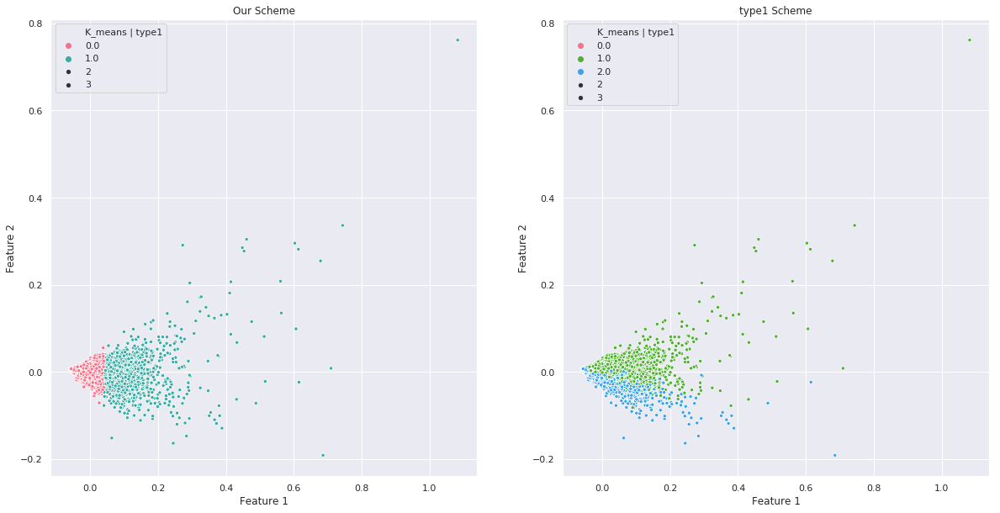

(11200, 3) 3
3
(11200, 3) 3


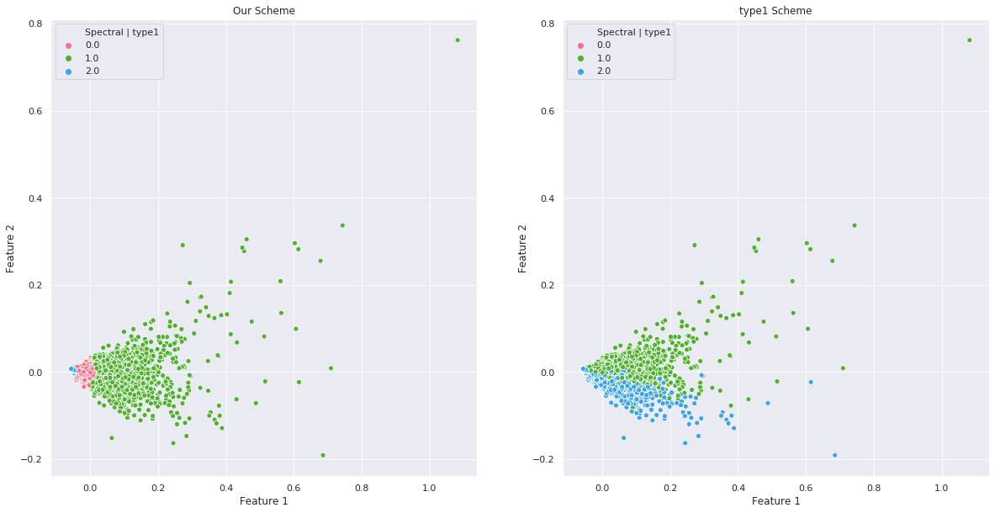

(11200, 3) 3
3
(11200, 3) 3


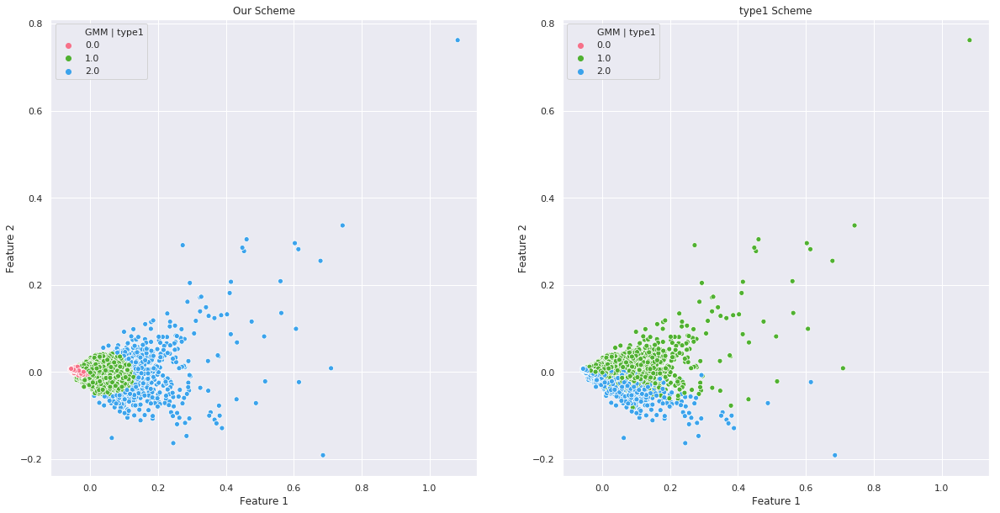

(11200, 3) 3
2
(11200, 3) 3


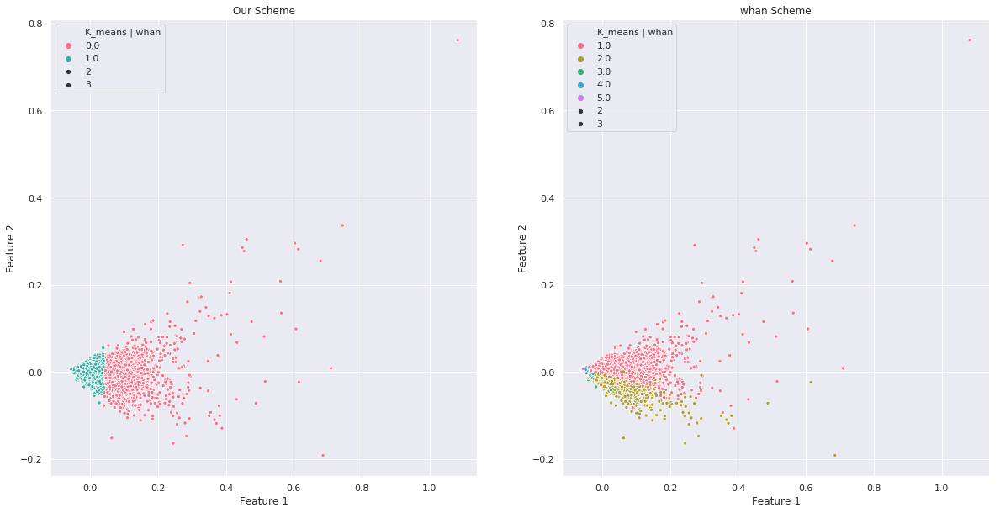

(11200, 3) 3
5
(11200, 3) 3


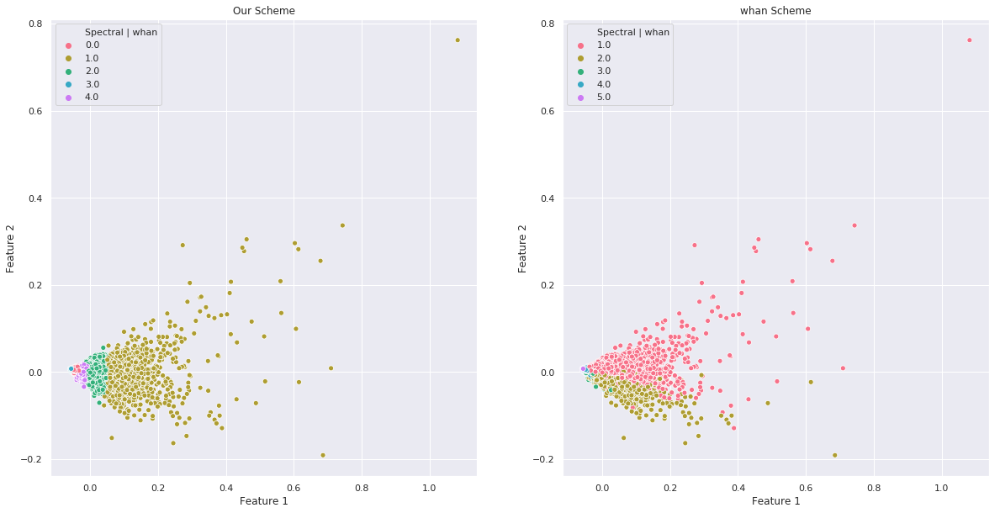

(11200, 3) 3
5
(11200, 3) 3


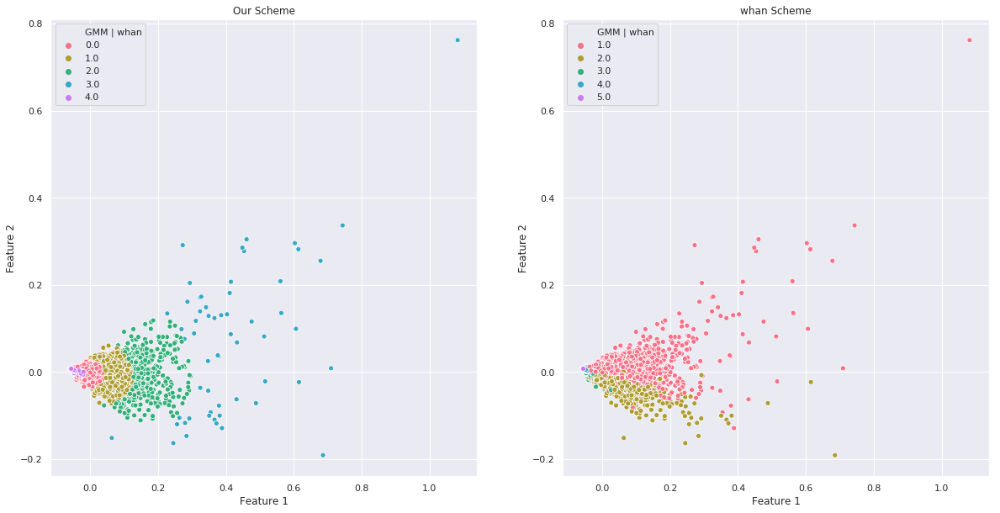

[VAE]Lat_Dim=2 | STD=0.1
.ipynb_checkpoints
[CVAE]Lat_Dim=5 | STD=0.5
[VAE]Lat_Dim=5 | STD=1e-13
[CVAE]Lat_Dim=4 | STD=0.5
[VAE]Lat_Dim=2 | STD=0.5
[VAE]Lat_Dim=6 | STD=1e-13
[VAE]Lat_Dim=3 | STD=1.0
[VAE]Lat_Dim=2 | STD=1.0
[CVAE]Lat_Dim=6 | STD=0.1
[VAE]Lat_Dim=5 | STD=0.5
[AE]Lat_Dim=3
[VAE]Lat_Dim=4 | STD=0.1
[VAE]Lat_Dim=5 | STD=0.1
[VAE]Lat_Dim=3 | STD=0.1
[CVAE]Lat_Dim=6 | STD=0.5
[AE]Lat_Dim=5
[CVAE]Lat_Dim=3 | STD=0.1
[VAE]Lat_Dim=4 | STD=1.0
[CVAE]Lat_Dim=6 | STD=1e-13
[AE]Lat_Dim=4
[CAE]Lat_Dim=6
[CVAE]Lat_Dim=3 | STD=0.5
[VAE]Lat_Dim=4 | STD=1e-13
[CVAE]Lat_Dim=5 | STD=1e-13
[VAE]Lat_Dim=6 | STD=0.1
[VAE]Lat_Dim=6 | STD=1.0
[CAE]Lat_Dim=4
[AE]Lat_Dim=6
[CVAE]Lat_Dim=6 | STD=1.0
[CVAE]Lat_Dim=2 | STD=0.1
[VAE]Lat_Dim=4 | STD=0.5
[CVAE]Lat_Dim=4 | STD=1.0
[VAE]Lat_Dim=3 | STD=0.5
[CVAE]Lat_Dim=4 | STD=0.1


In [47]:
from sklearn.manifold import TSNE
from Dirs import *
import os
import pandas as pd
import numpy as np
import random
import shutil
import seaborn as sns; sns.set()
import matplotlib.pyplot as plt
import itertools
%matplotlib inline
import itertools
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
from IPython.display import clear_output
from sklearn.cluster import KMeans
from sklearn.cluster import SpectralClustering
from sklearn.mixture import GaussianMixture

arquivos = os.listdir(latentSpace_dir)
classes = pd.read_csv("Training_Data")
labels = ["type1", "whan"]
porcentage = 0.9

results = np.array([["Model","Dim", "STD", "K-Means", "Spectral", "GMM"]])

for arquivo in arquivos:
    print(arquivo)
    if "Dim" not in arquivo:
        continue
    elif "PCA" in arquivo and "Dim=2" in arquivo:

        df_tmp = pd.read_csv(latentSpace_dir +"/"+ arquivo, engine='python')
        features = []
        for i in range(df_tmp.shape[1]):
            features.append('Feature {}'.format(i+1))

        features.append("type1")
        features.append("whan")
        #print(classes.shape)
        type1 = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-2] )
        type1 = np.reshape(type1, (type1.shape[0],1))
        #print(df_tmp.values.shape, type1.shape)
        concat = np.concatenate([df_tmp.values, type1], axis = 1)
        whan = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-1])
        whan = np.reshape(whan, (whan.shape[0],1))
        concat = np.concatenate([concat, whan], axis = 1)
        df = pd.DataFrame(data = concat , columns = features)
        #print(df.head(5))
        #print(df.shape)
        labels_vectors = {"type1":type1, "whan":whan}
        features.pop()
        features.pop()
            
        labels = ["type1", "whan"]
        for label in labels:
            '''
            tmp = []
    
            if "[AE]" in arquivo:
                tmp.append("AE")
                tmp.append(str(df_tmp.shape[1]))
                tmp.append("-")
            elif "[CAE]" in arquivo:
                tmp.append("CAE")
                tmp.append(str(df_tmp.shape[1]))
                tmp.append("-")
            elif "[VAE]" in arquivo:
                tmp.append("VAE")
                tmp.append(str(df_tmp.shape[1]))
                std = arquivo.split("|")[1].split(".")[0].split("=")[1]
                tmp.append(str(std))
            elif "[CVAE]" in arquivo:
                tmp.append("CVAE")
                tmp.append(str(df_tmp.shape[1]))
                std = arquivo.split("|")[1].split(".")[0].split("=")[1]
                tmp.append(str(std))
            '''
            
            y_test = labels_vectors[label]
            y_test = np.reshape(y_test, (y_test.shape[0],1))
            #print("Iniciando")
            #K-MEANS
            n_clusters = 2
            kmeans = KMeans(n_clusters=n_clusters, n_init=20)
            y_pred_kmeans = kmeans.fit_predict(df_tmp.values)
            y_pred_kmeans = np.reshape(y_pred_kmeans, (y_pred_kmeans.shape[0],1))
            #print(y_pred_kmeans.shape)
            
            df = np.concatenate([np.copy(df_tmp.values), y_pred_kmeans], axis = 1)
            #whan = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-1])
            #whan = np.reshape(whan, (whan.shape[0],1))
            #concat = np.concatenate([concat, whan], axis = 1)
            features.append(f"K_means | {label}")
            print(df.shape, len(features))
            df = pd.DataFrame(data = df , columns = features)
            
            
            fig = plt.figure(figsize=(20,10))
            ax = fig.add_subplot(1,2,1)
            sns.scatterplot(x="Feature %d" % (1) , y="Feature %d" % (2), 
                    palette = sns.color_palette("husl", len(np.unique(df[f"K_means | {label}"]))),
                    hue=f"K_means | {label}", data=df, size=3) 
            ax.set_title("Our Scheme")
            ax = fig.add_subplot(1,2,2)
            from scipy.stats import mode
            #y_pred_kmeans = np.reshape(y_pred_kmeans, (y_pred_kmeans.shape[0],1))
            labels = np.zeros_like(y_pred_kmeans)
            print(n_clusters)
            for i in range(n_clusters):
                mask = (y_pred_kmeans == i)
                labels[mask] = mode(y_test[mask])[0]
            
            features.pop()
            labels = np.reshape(labels, (labels.shape[0],1))   
            df = np.concatenate([np.copy(df_tmp.values), labels_vectors[label]], axis = 1)
            #whan = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-1])
            #whan = np.reshape(whan, (whan.shape[0],1))
            #concat = np.concatenate([concat, whan], axis = 1)
            features.append(f"K_means | {label}")
            print(df.shape, len(features))
            df = pd.DataFrame(data = df , columns = features)
            sns.scatterplot(x="Feature %d" % (1) , y="Feature %d" % (2), 
                    palette = sns.color_palette("husl", len(np.unique(df[f"K_means | {label}"]))),
                    hue=f"K_means | {label}", data=df, size =3) 
            ax.set_title(f"{label} Scheme")
            
            if "[VAE]" in arquivo:
                std = arquivo.split("|")[1].split("=")[1]
                plt.suptitle("[VAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/VAE/' + 
                            '[Dim {} | STD {}]OurScheme | K-Means |Type:{}.png'.format(df_tmp.shape[1],std,label))
                #g.savefig(root_dir + "/Playground/" + 
                #          '[VAE | Dim {} | STD {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],std,label))
            elif "[CAE]" in arquivo:
                plt.suptitle("[CAE][Dim {}]".format(df_tmp.shape[1]), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/CAE/' + 
                            '[Dim {}]OurScheme | K-Means |Type:{}.png'.format(df_tmp.shape[1],label))
            elif "[AE]" in arquivo:
                plt.suptitle("[AE][Dim {}]".format(df_tmp.shape[1]), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/AE/' + 
                            '[Dim {}]OurScheme | K-Means |Type:{}.png'.format(df_tmp.shape[1],label))
                
            elif "[CVAE]" in arquivo:
                std = arquivo.split("|")[1].split("=")[1]
                plt.suptitle("[CVAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/CVAE/' + 
                            '[Dim {} | STD {}]OurScheme | K-Means |Type:{}.png'.format(df_tmp.shape[1],std,label))
                #g.savefig(root_dir + "/Playground/" + 
                #          '[CVAE | Dim {} | STD {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],std,label))

            #plt.close()
            plt.show()
            
            
            
            '''
            from scipy.stats import mode
            y_pred_kmeans = np.reshape(y_pred_kmeans, (y_pred_kmeans.shape[0],1))
            labels = np.zeros_like(y_pred_kmeans)
            for i in range(n_clusters):
                mask = (y_pred_kmeans == i)
                labels[mask] = mode(y_test[mask])[0]

            from sklearn.metrics import accuracy_score
            score_kmeans = accuracy_score(y_test, labels)
            tmp.append((str(score_kmeans*100))[:4])
            #print(score_kmeans)
            '''
            
            
            #SPECTRAL
            n_clusters = len(np.unique(y_test))
            model = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors',
                                       assign_labels='kmeans', n_init= 20)
            y_pred_spec = model.fit_predict(df_tmp.values)
            y_pred_spec = np.reshape(y_pred_spec, (y_pred_spec.shape[0],1))
            
            df = np.concatenate([np.copy(df_tmp.values), y_pred_spec], axis = 1)
            #whan = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-1])
            #whan = np.reshape(whan, (whan.shape[0],1))
            #concat = np.concatenate([concat, whan], axis = 1)
            features.pop()
            features.append(f"Spectral | {label}")
            print(df.shape, len(features))
            df = pd.DataFrame(data = df , columns = features)
            
            
            fig = plt.figure(figsize=(20,10))
            ax = fig.add_subplot(1,2,1)
            sns.scatterplot(x="Feature %d" % (1) , y="Feature %d" % (2), 
                    palette = sns.color_palette("husl", len(np.unique(df[f"Spectral | {label}"]))),
                    hue=f"Spectral | {label}", data=df) 
            ax.set_title("Our Scheme")
            ax = fig.add_subplot(1,2,2)
            from scipy.stats import mode
            #y_pred_kmeans = np.reshape(y_pred_kmeans, (y_pred_kmeans.shape[0],1))
            labels = np.zeros_like(y_pred_spec)
            print(n_clusters)
            for i in range(n_clusters):
                mask = (y_pred_kmeans == i)
                labels[mask] = mode(y_test[mask])[0]
            
            features.pop()
            labels = np.reshape(labels, (labels.shape[0],1))   
            df = np.concatenate([np.copy(df_tmp.values), labels_vectors[label]], axis = 1)
            #whan = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-1])
            #whan = np.reshape(whan, (whan.shape[0],1))
            #concat = np.concatenate([concat, whan], axis = 1)
            features.append(f"Spectral | {label}")
            print(df.shape, len(features))
            df = pd.DataFrame(data = df , columns = features)
            sns.scatterplot(x="Feature %d" % (1) , y="Feature %d" % (2), 
                    palette = sns.color_palette("husl", len(np.unique(df[f"Spectral | {label}"]))),
                    hue=f"Spectral | {label}", data=df) 
            ax.set_title(f"{label} Scheme")
            
            if "[VAE]" in arquivo:
                std = arquivo.split("|")[1].split("=")[1]
                plt.suptitle("[VAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/VAE/' + 
                            '[Dim {} | STD {}]OurScheme | Spectral |Type:{}.png'.format(df_tmp.shape[1],std,label))
                #g.savefig(root_dir + "/Playground/" + 
                #          '[VAE | Dim {} | STD {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],std,label))
            elif "[CAE]" in arquivo:
                plt.suptitle("[CAE][Dim {}]".format(df_tmp.shape[1]), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/CAE/' + 
                            '[Dim {}]OurScheme | Spectral |Type:{}.png'.format(df_tmp.shape[1],label))
            elif "[AE]" in arquivo:
                plt.suptitle("[AE][Dim {}]".format(df_tmp.shape[1]), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/AE/' + 
                            '[Dim {}]OurScheme | Spectral |Type:{}.png'.format(df_tmp.shape[1],label))
                
            elif "[CVAE]" in arquivo:
                std = arquivo.split("|")[1].split("=")[1]
                plt.suptitle("[CVAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/CVAE/' + 
                            '[Dim {} | STD {}]OurScheme | Spectral |Type:{}.png'.format(df_tmp.shape[1],std,label))
                #g.savefig(root_dir + "/Playground/" + 
                #          '[CVAE | Dim {} | STD {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],std,label))

            #plt.close()
            plt.show()
            
            '''
            from scipy.stats import mode
            y_pred_spec = np.reshape(y_pred_spec, (y_pred_spec.shape[0],1))
            labels = np.zeros_like(y_pred_spec)
            for i in range(n_clusters):
                mask = (y_pred_spec == i)
                labels[mask] = mode(y_test[mask])[0]

            
            from sklearn.metrics import accuracy_score
            score_spec = accuracy_score(y_test, labels)
            tmp.append((str(score_spec*100))[:4])
            #print(score_spec)
            '''
            
            #GMM
            n_clusters = len(np.unique(y_test))
            gmm = GaussianMixture(n_components=n_clusters, n_init= 20, covariance_type= 'full')
            y_pred_gmm = gmm.fit_predict(df_tmp.values)
            y_pred_gmm = np.reshape(y_pred_gmm, (y_pred_gmm.shape[0],1))
            
            df = np.concatenate([np.copy(df_tmp.values), y_pred_gmm], axis = 1)
            #whan = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-1])
            #whan = np.reshape(whan, (whan.shape[0],1))
            #concat = np.concatenate([concat, whan], axis = 1)
            features.pop()
            features.append(f"GMM | {label}")
            print(df.shape, len(features))
            df = pd.DataFrame(data = df , columns = features)
            
            
            fig = plt.figure(figsize=(20,10))
            ax = fig.add_subplot(1,2,1)
            sns.scatterplot(x="Feature %d" % (1) , y="Feature %d" % (2), 
                    palette = sns.color_palette("husl", len(np.unique(df[f"GMM | {label}"]))),
                    hue=f"GMM | {label}", data=df) 
            ax.set_title("Our Scheme")
            ax = fig.add_subplot(1,2,2)
            from scipy.stats import mode
            #y_pred_kmeans = np.reshape(y_pred_kmeans, (y_pred_kmeans.shape[0],1))
            labels = np.zeros_like(y_pred_gmm)
            print(n_clusters)
            for i in range(n_clusters):
                mask = (y_pred_kmeans == i)
                labels[mask] = mode(y_test[mask])[0]
            
            features.pop()
            labels = np.reshape(labels, (labels.shape[0],1))   
            df = np.concatenate([np.copy(df_tmp.values), labels_vectors[label]], axis = 1)
            #whan = np.copy(classes.values[int(classes.shape[0] * porcentage):-129,-1])
            #whan = np.reshape(whan, (whan.shape[0],1))
            #concat = np.concatenate([concat, whan], axis = 1)
            features.append(f"GMM | {label}")
            print(df.shape, len(features))
            df = pd.DataFrame(data = df , columns = features)
            sns.scatterplot(x="Feature %d" % (1) , y="Feature %d" % (2), 
                    palette = sns.color_palette("husl", len(np.unique(df[f"GMM | {label}"]))),
                    hue=f"GMM | {label}", data=df) 
            ax.set_title(f"{label} Scheme")
            features.pop()
            
            if "[VAE]" in arquivo:
                std = arquivo.split("|")[1].split("=")[1]
                plt.suptitle("[VAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/VAE/' + 
                            '[Dim {} | STD {}]OurScheme | GMM |Type:{}.png'.format(df_tmp.shape[1],std,label))
                #g.savefig(root_dir + "/Playground/" + 
                #          '[VAE | Dim {} | STD {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],std,label))
            elif "[CAE]" in arquivo:
                plt.suptitle("[CAE][Dim {}]".format(df_tmp.shape[1]), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/CAE/' + 
                            '[Dim {}]OurScheme | GMM |Type:{}.png'.format(df_tmp.shape[1],label))
            elif "[AE]" in arquivo:
                plt.suptitle("[AE][Dim {}]".format(df_tmp.shape[1]), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/AE/' + 
                            '[Dim {}]OurScheme | GMM |Type:{}.png'.format(df_tmp.shape[1],label))
                
            elif "[CVAE]" in arquivo:
                std = arquivo.split("|")[1].split("=")[1]
                plt.suptitle("[CVAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 24, y = 1.05)
                plt.savefig(ourclusters_dir + '/CVAE/' + 
                            '[Dim {} | STD {}]OurScheme | GMM |Type:{}.png'.format(df_tmp.shape[1],std,label))
                #g.savefig(root_dir + "/Playground/" + 
                #          '[CVAE | Dim {} | STD {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],std,label))

            #plt.close()
            plt.show()
            
            
            '''
            from scipy.stats import mode
            y_pred_gmm = np.reshape(y_pred_gmm, (y_pred_gmm.shape[0],1))
            labels = np.zeros_like(y_pred_gmm)
            for i in range(n_clusters):
                mask = (y_pred_gmm == i)
                labels[mask] = mode(y_test[mask])[0]


            from sklearn.metrics import accuracy_score
            score_gmm = accuracy_score(y_test, labels)
            #print("GMM Accuracy: {:.2f}".format(score_gmm))
            tmp.append((str(score_gmm*100))[:4])
            #print(score_gmm)
            '''
            '''         
            #print(tmp)
            tmp = np.array([tmp])
            #print(tmp)
            results = np.concatenate([results,tmp], axis=0)
            clear_output()
            print(results)
            '''
#df = pd.DataFrame(data = results[1:,:], columns= results[0,:])
#df.to_csv("Clustering Algorithms Results.csv", index=False)

#df.head()
            
            
            
            
            

3


(24879, 2) (24879, 1)


<Figure size 432x288 with 0 Axes>

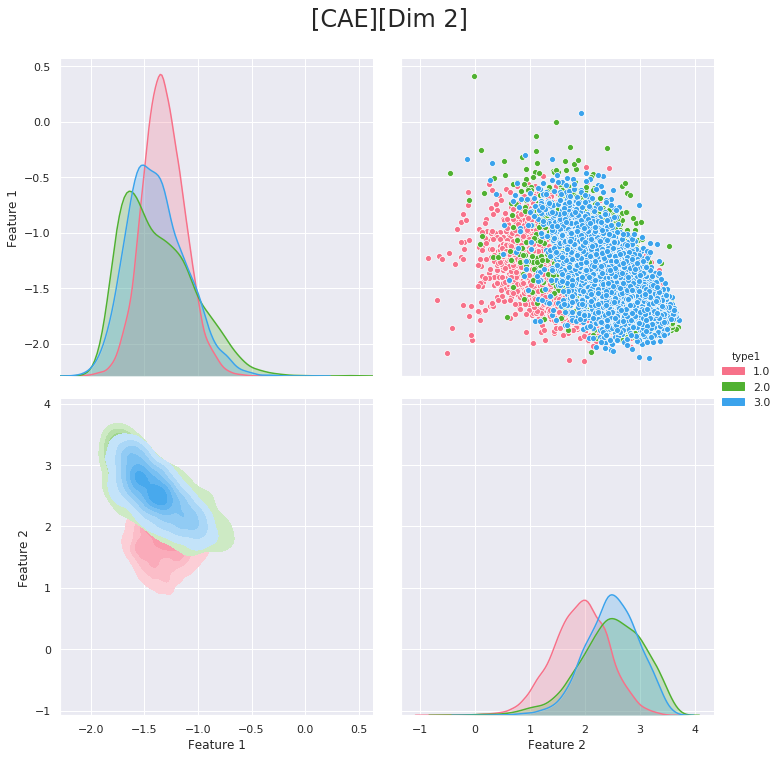

<Figure size 432x288 with 0 Axes>

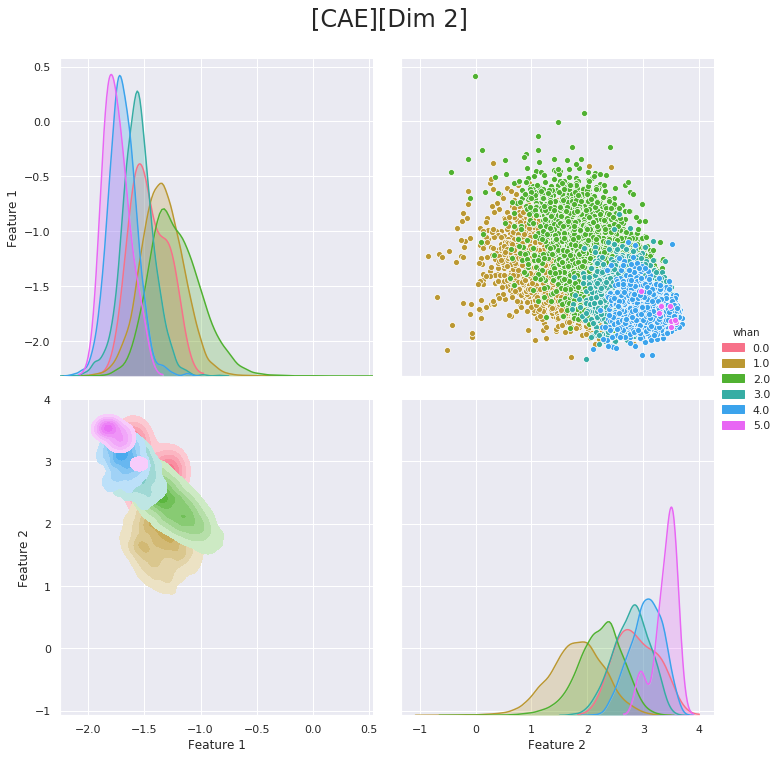

(24879, 3) (24879, 1)


<Figure size 432x288 with 0 Axes>

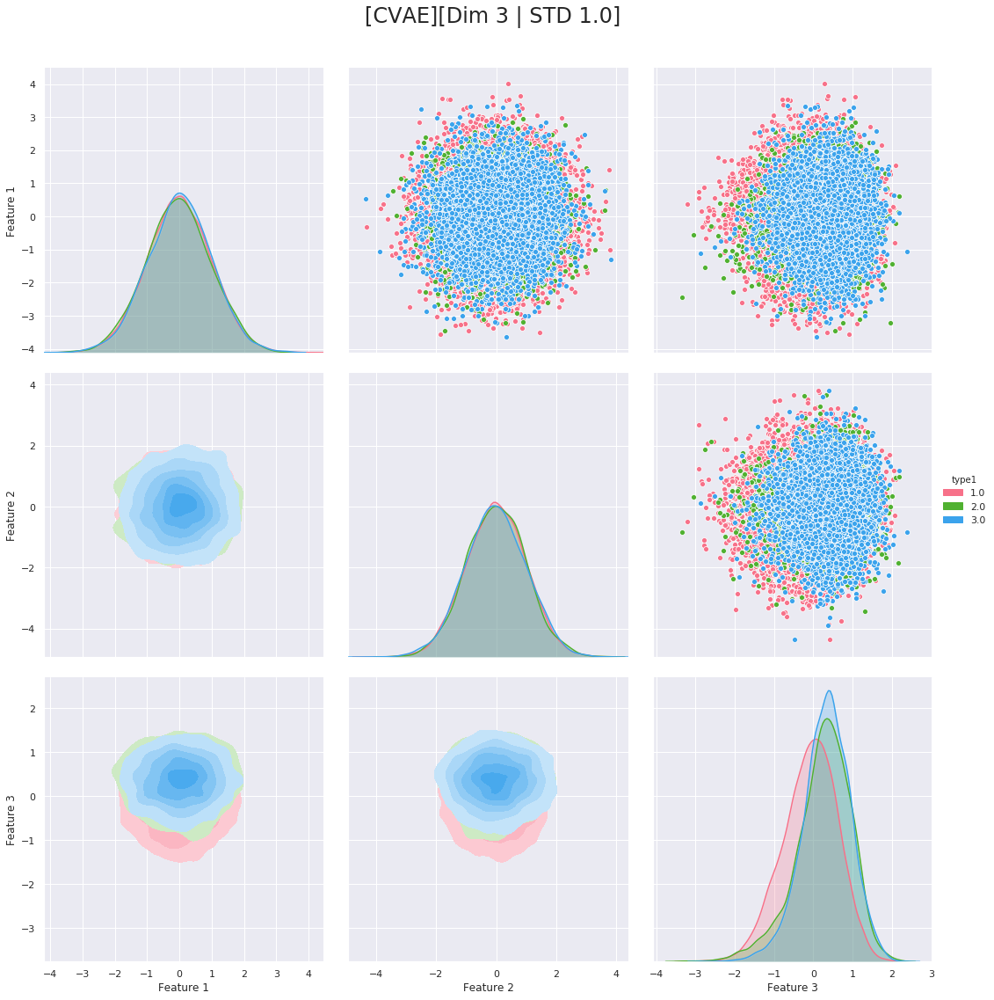

<Figure size 432x288 with 0 Axes>

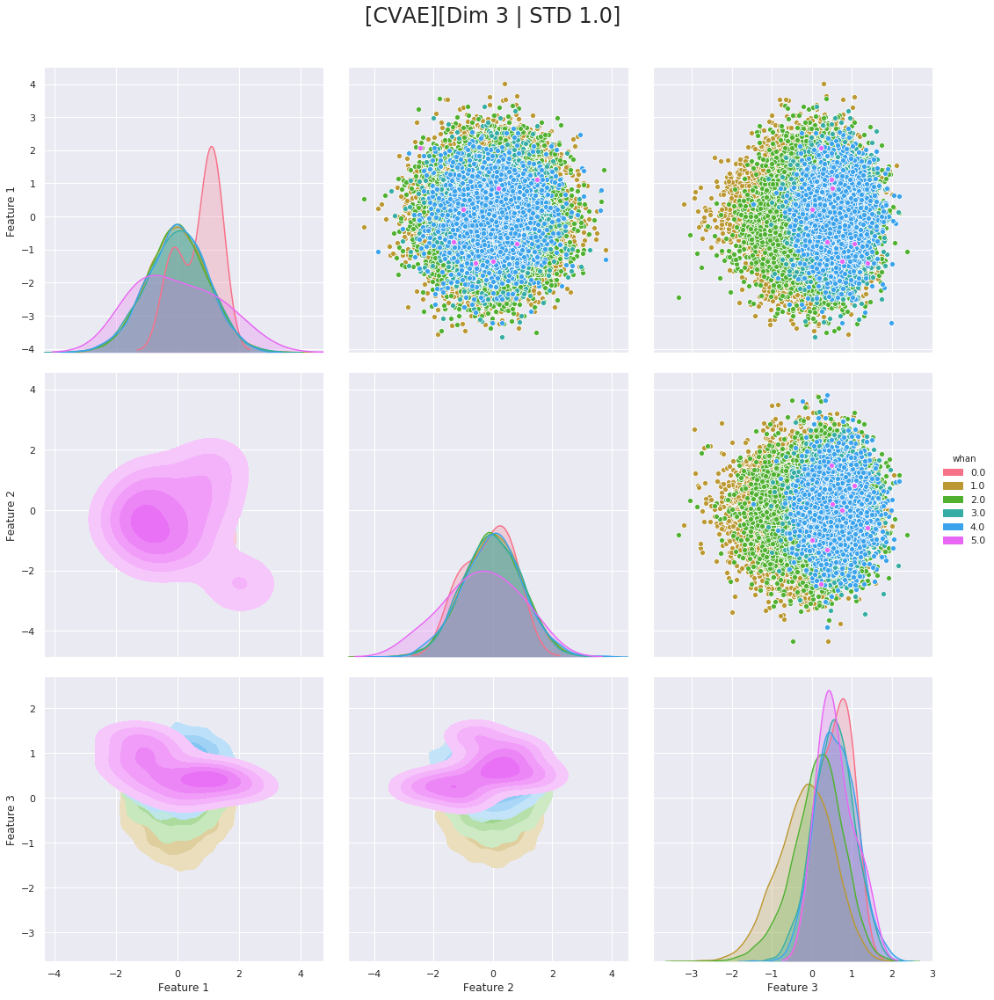

(24879, 5) (24879, 1)


<Figure size 432x288 with 0 Axes>

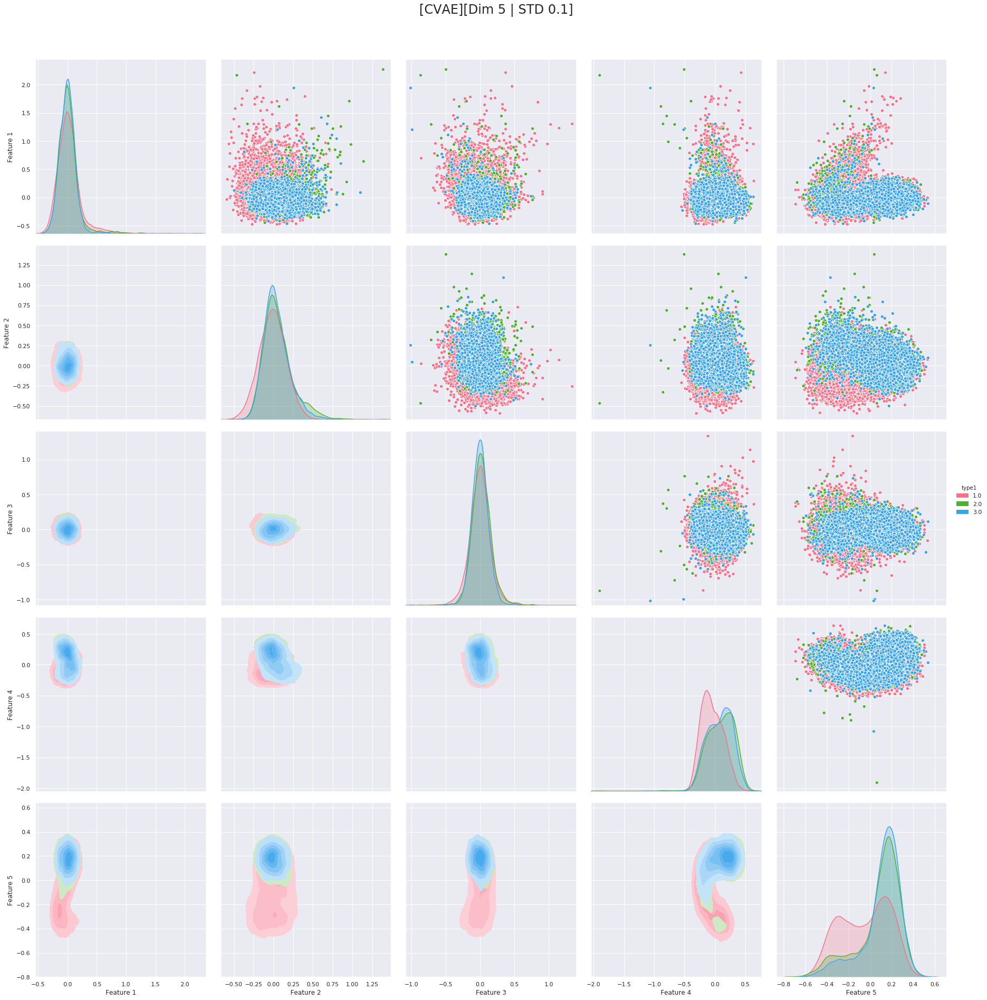

<Figure size 432x288 with 0 Axes>

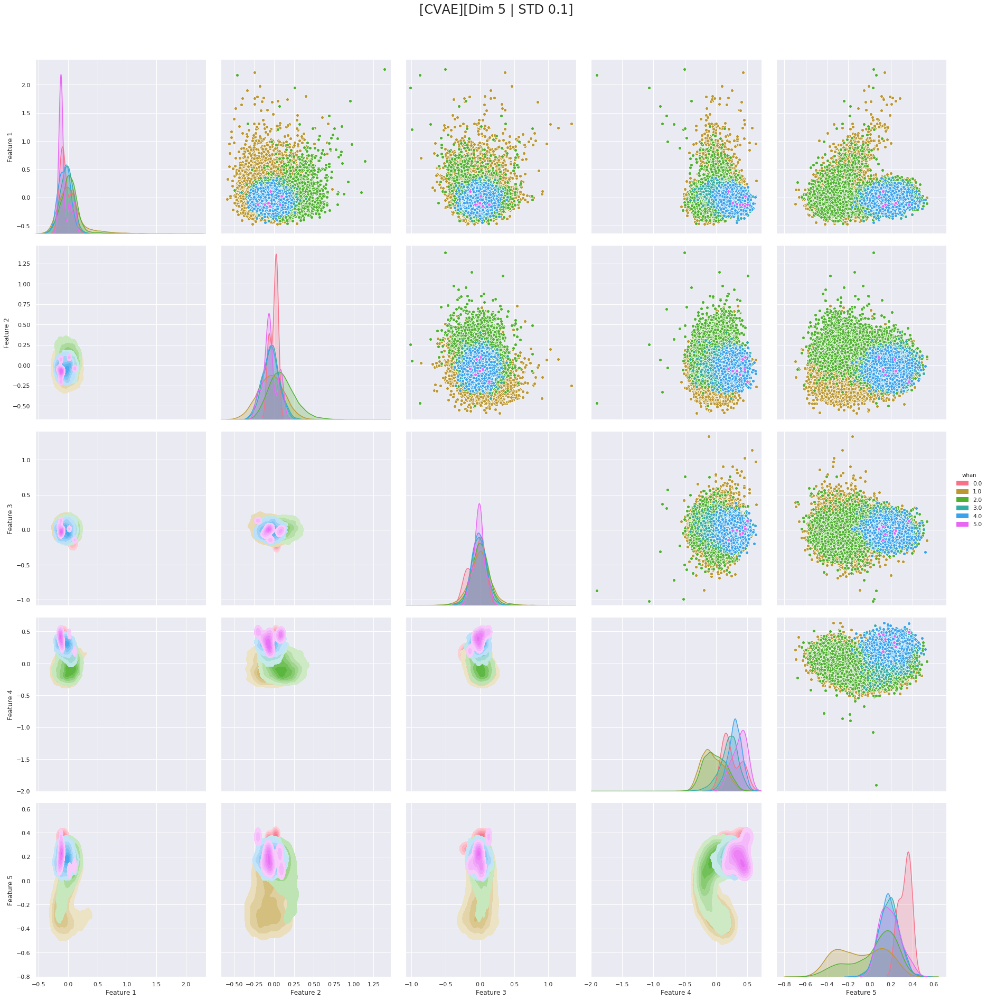

(24879, 4) (24879, 1)


<Figure size 432x288 with 0 Axes>

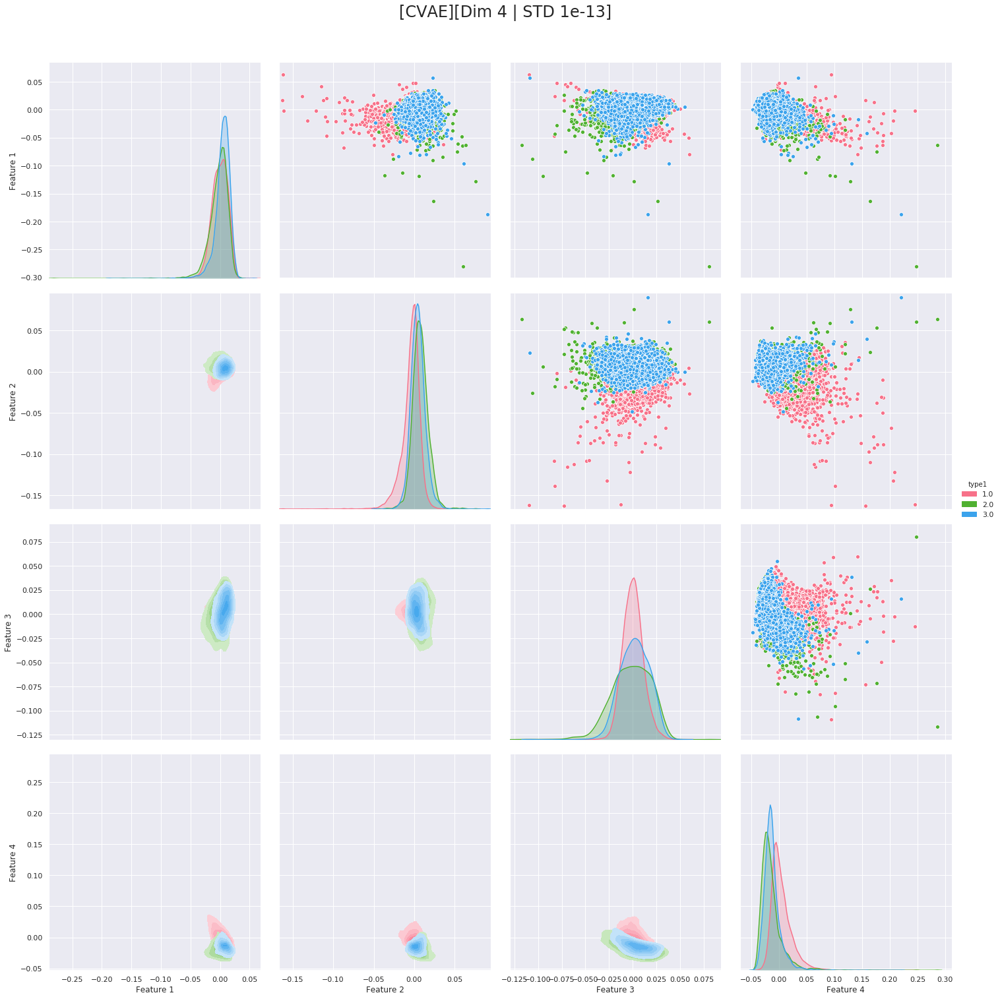

<Figure size 432x288 with 0 Axes>

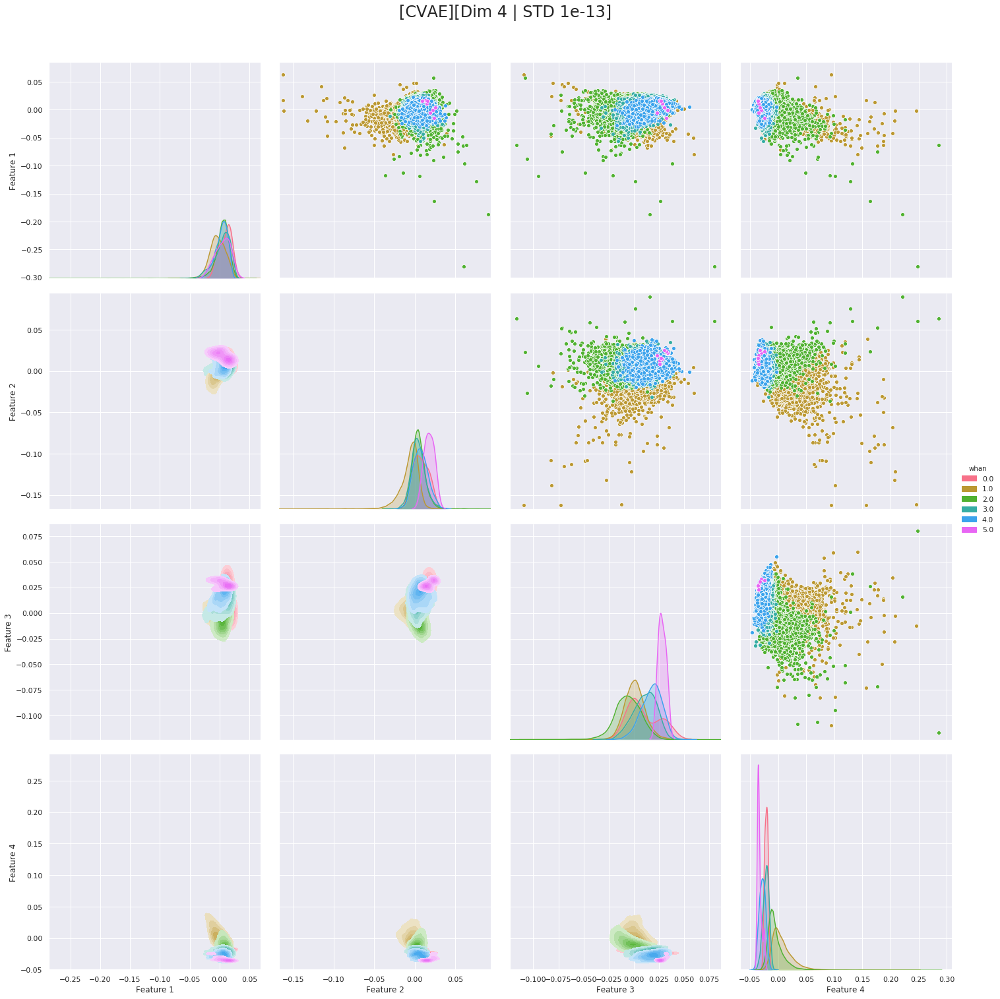

(24879, 2) (24879, 1)


<Figure size 432x288 with 0 Axes>

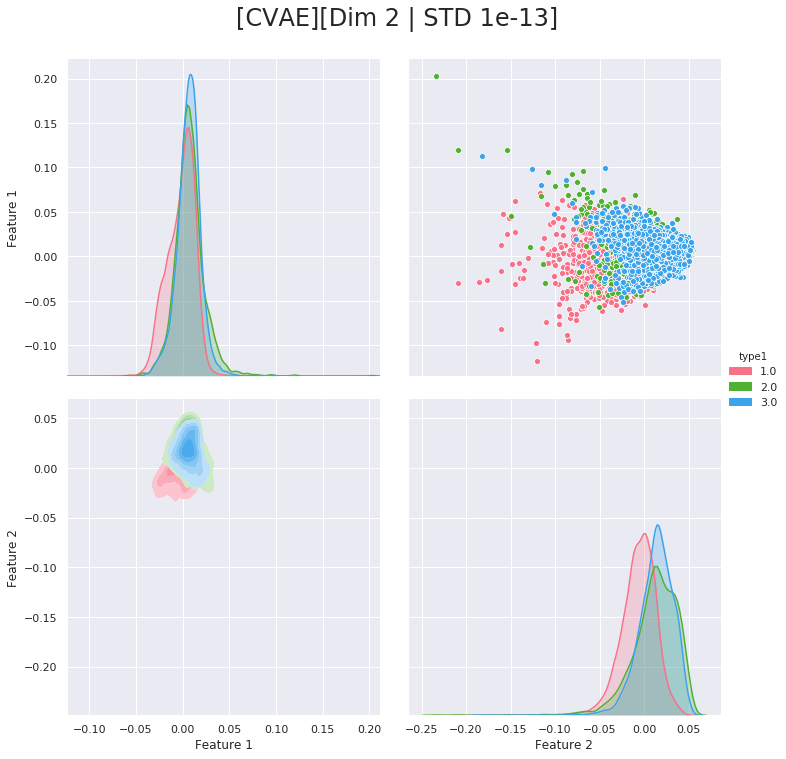

<Figure size 432x288 with 0 Axes>

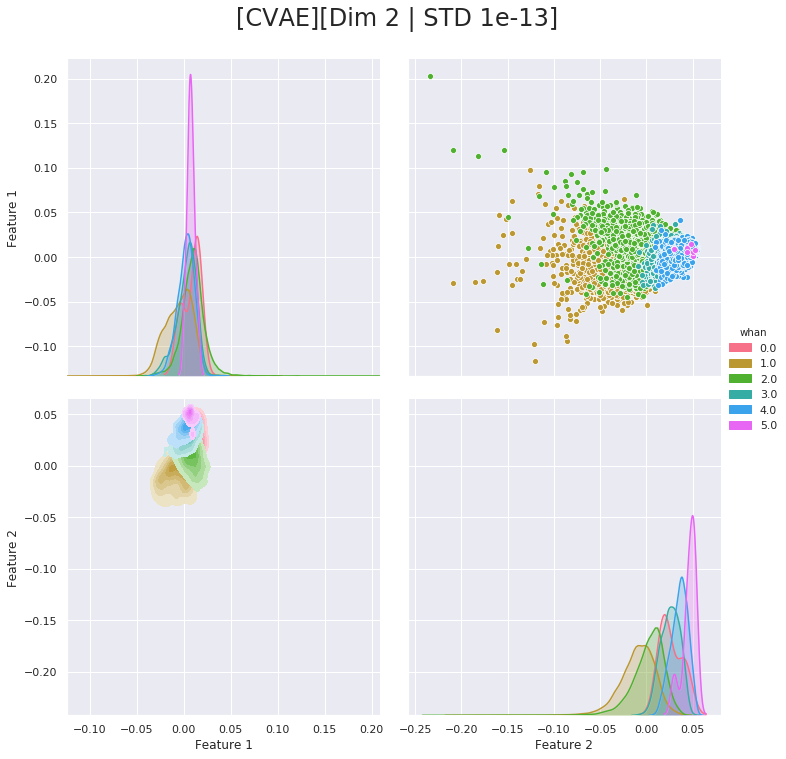

(24879, 3) (24879, 1)


<Figure size 432x288 with 0 Axes>

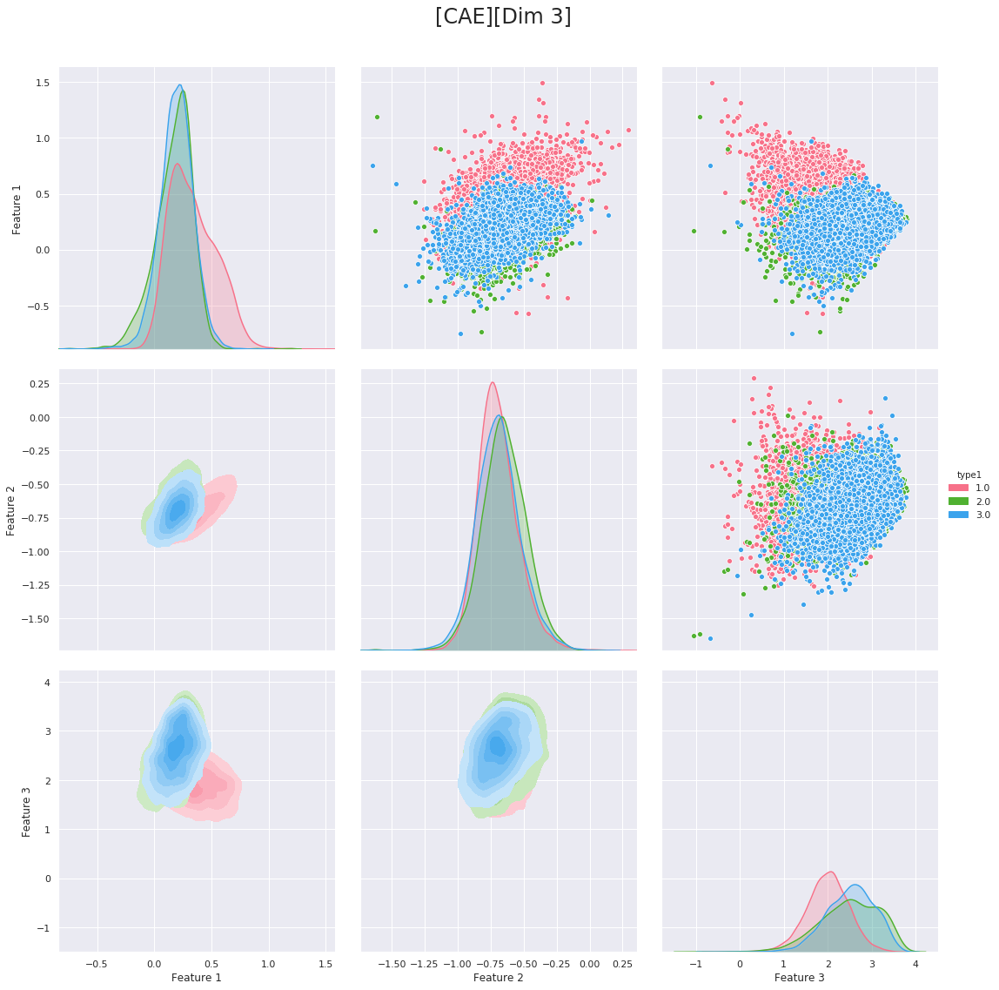

<Figure size 432x288 with 0 Axes>

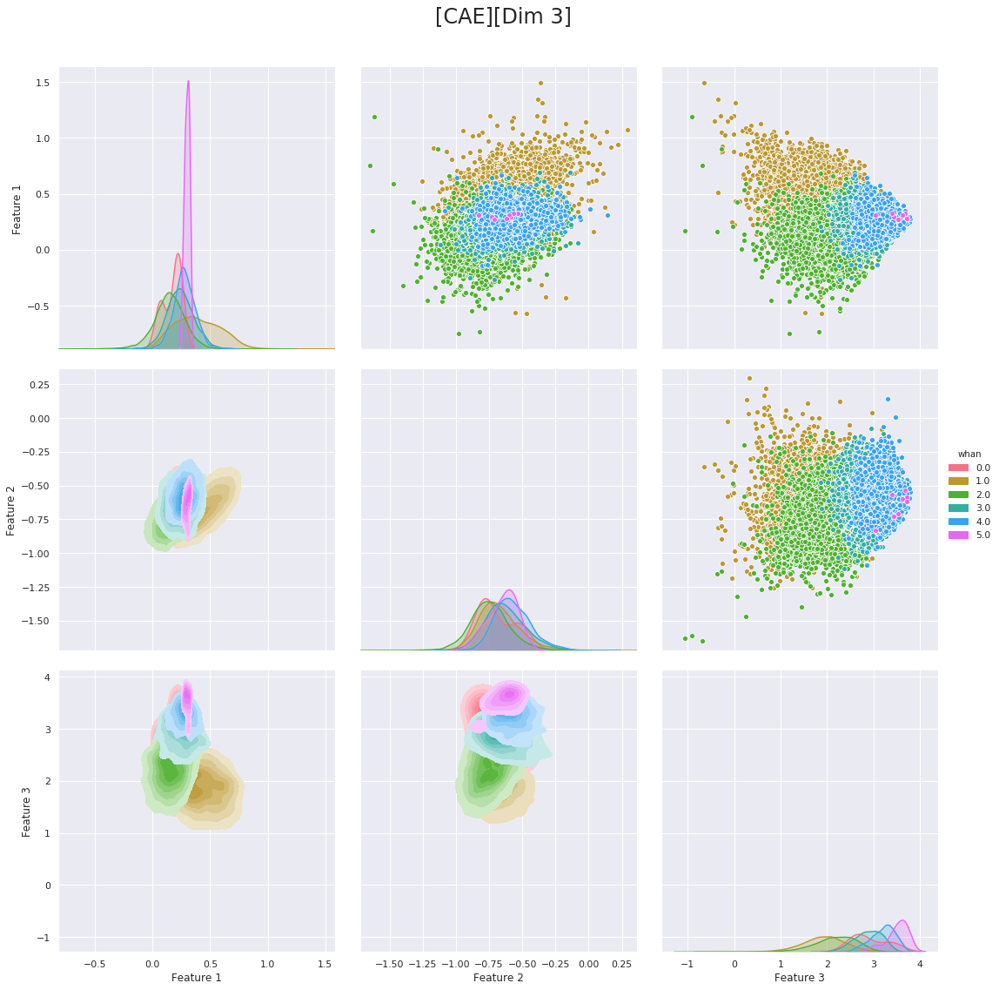

(24879, 2) (24879, 1)


<Figure size 432x288 with 0 Axes>

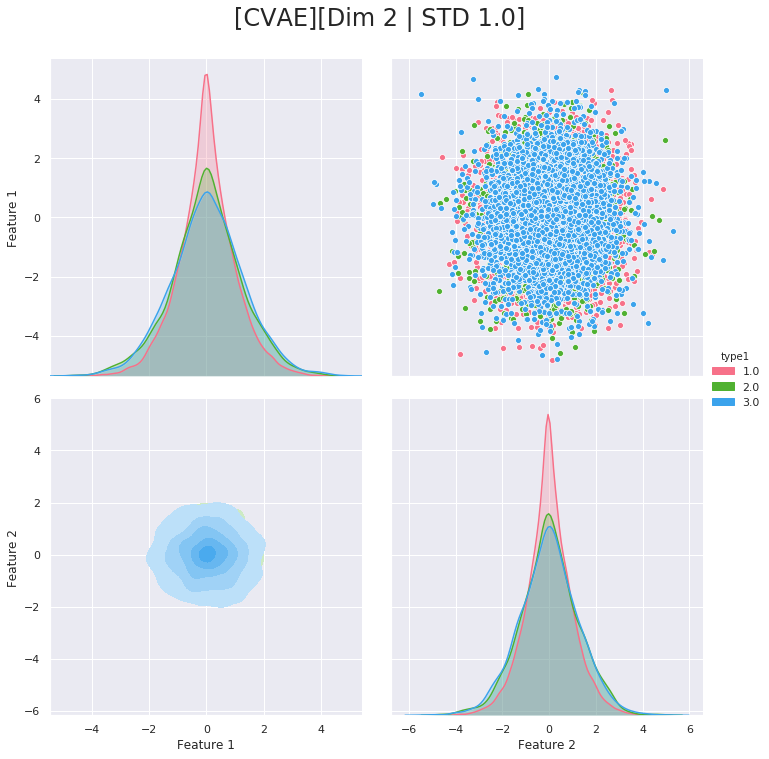

<Figure size 432x288 with 0 Axes>

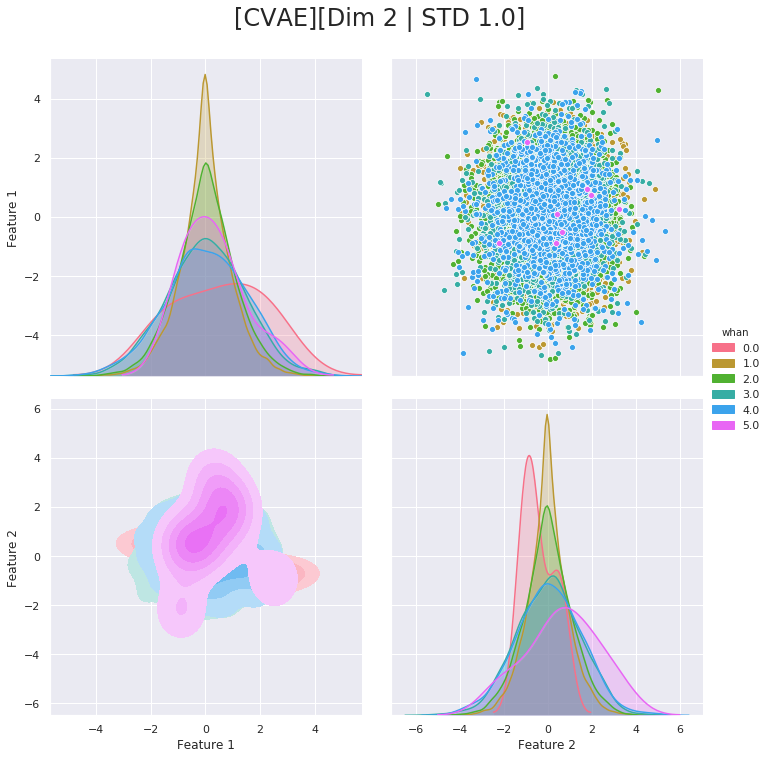

(24879, 5) (24879, 1)


<Figure size 432x288 with 0 Axes>

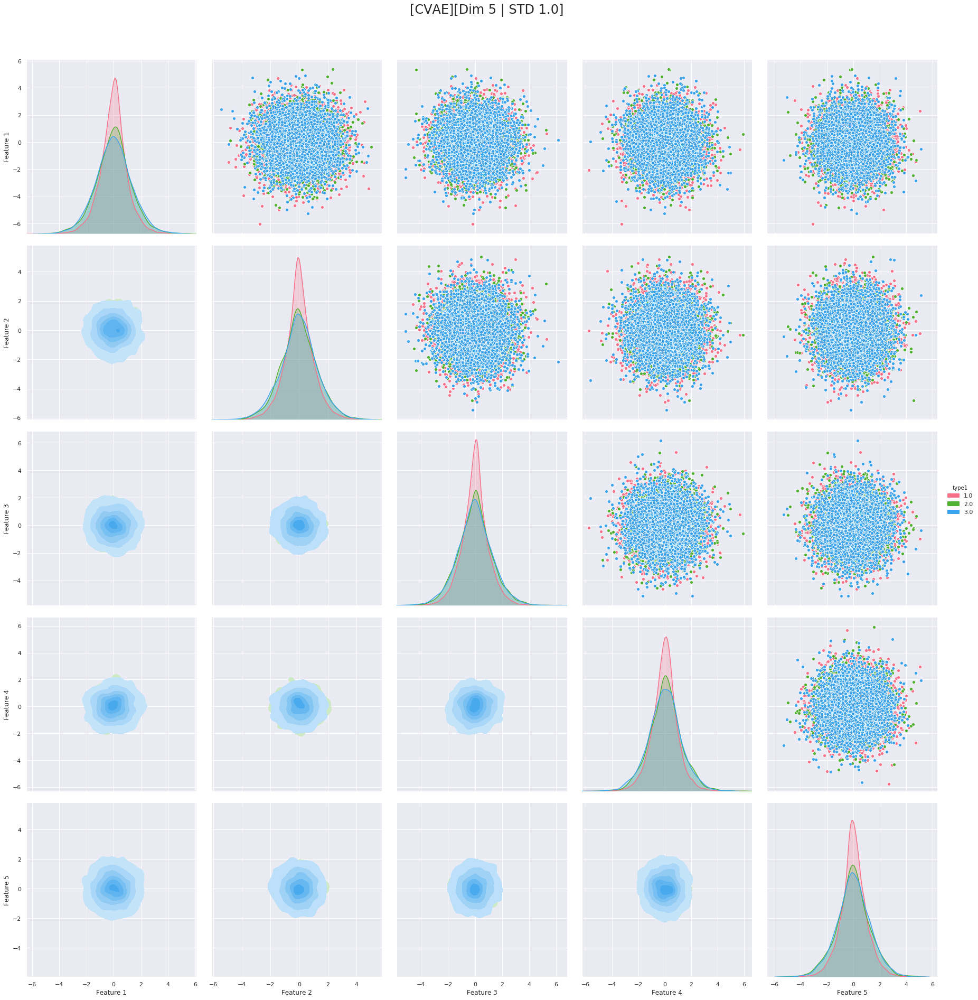

<Figure size 432x288 with 0 Axes>

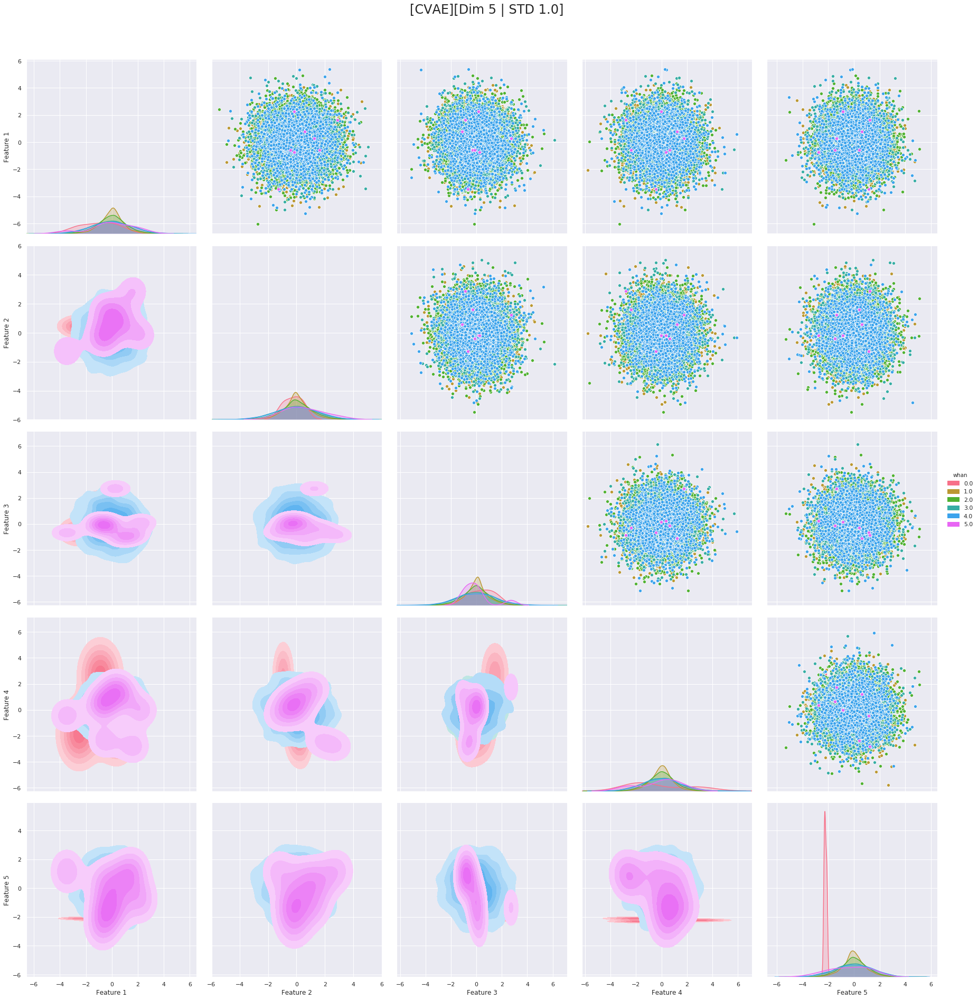

(24879, 5) (24879, 1)


<Figure size 432x288 with 0 Axes>

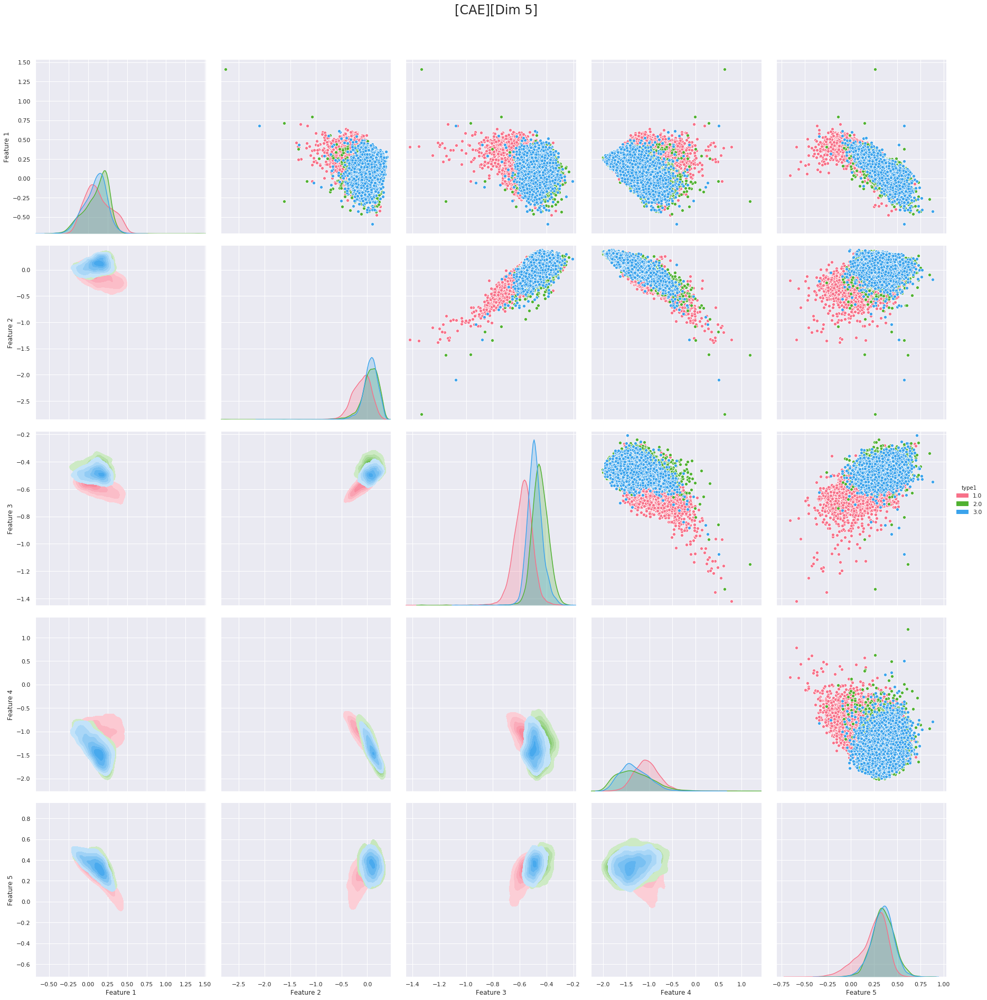

<Figure size 432x288 with 0 Axes>

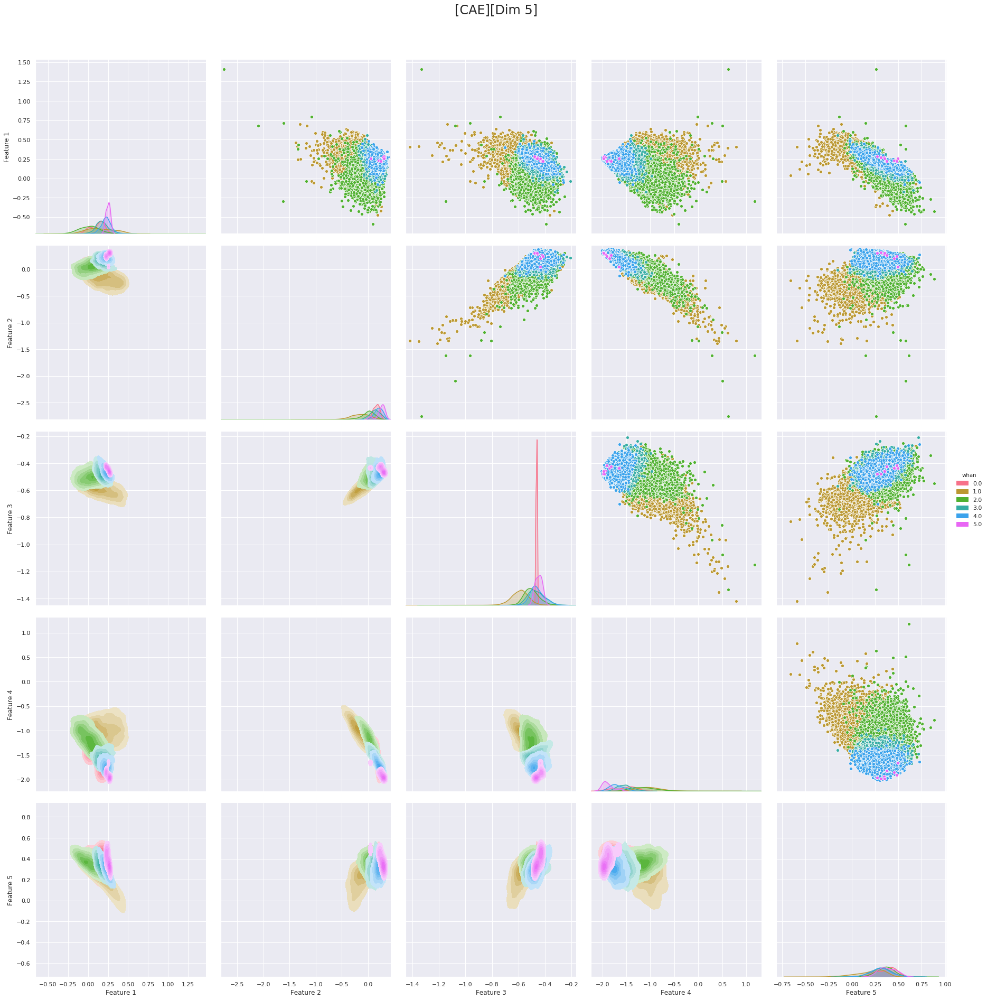

(24879, 3) (24879, 1)


<Figure size 432x288 with 0 Axes>

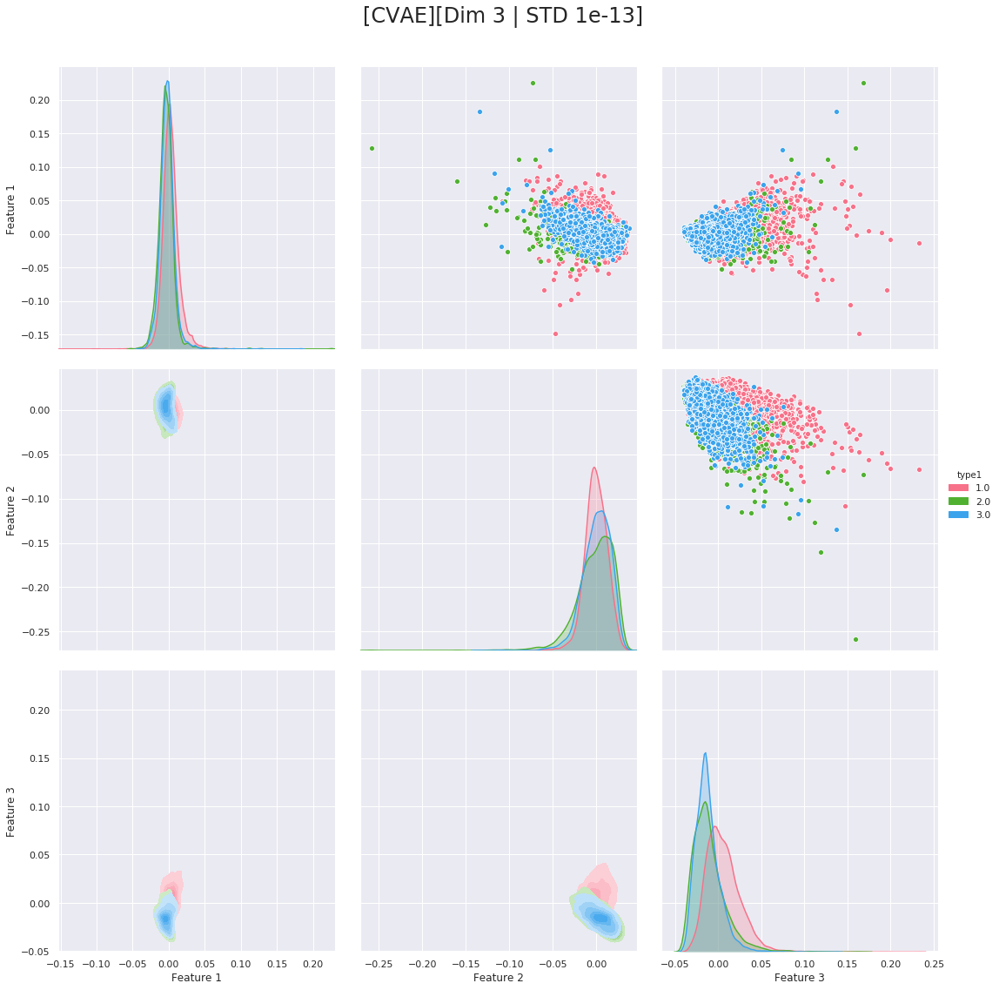

<Figure size 432x288 with 0 Axes>

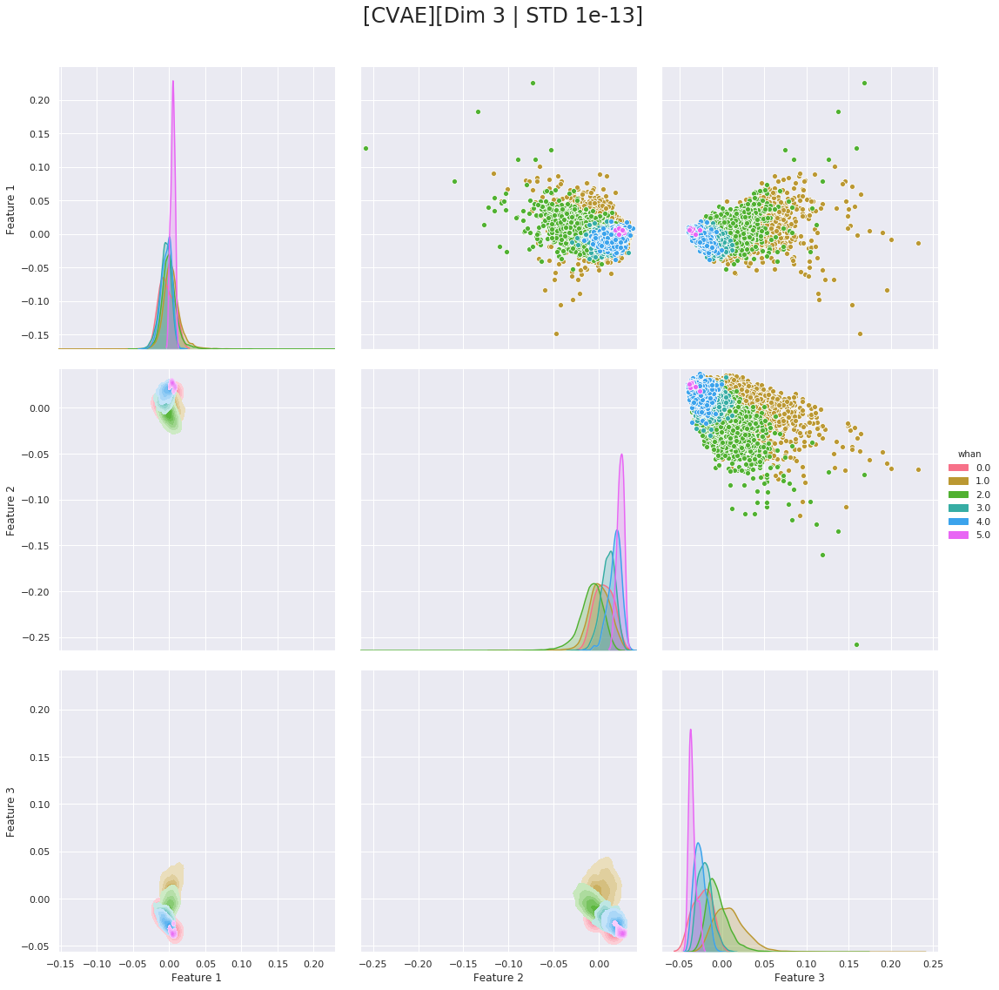

(24879, 2) (24879, 1)


<Figure size 432x288 with 0 Axes>

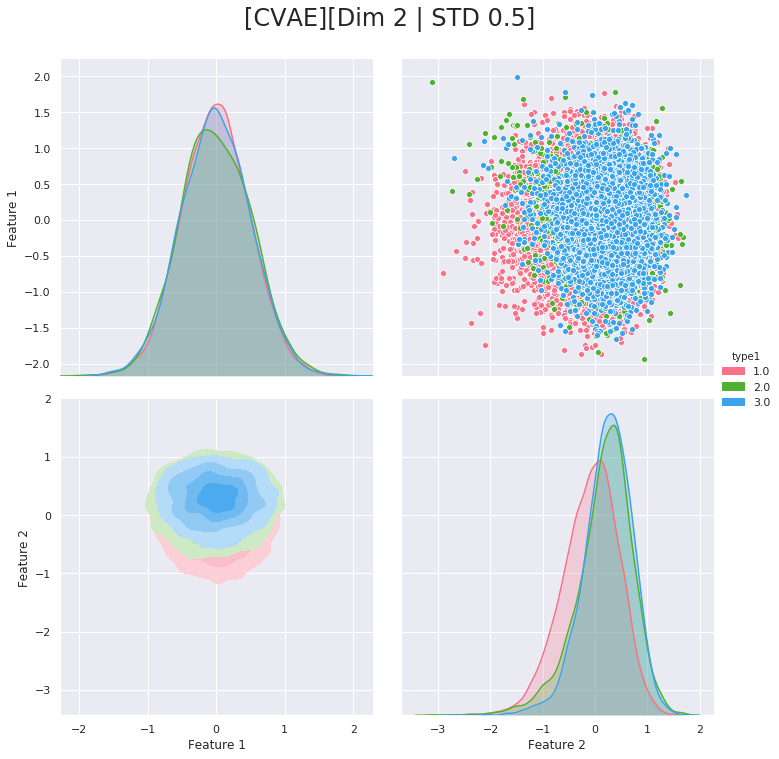

<Figure size 432x288 with 0 Axes>

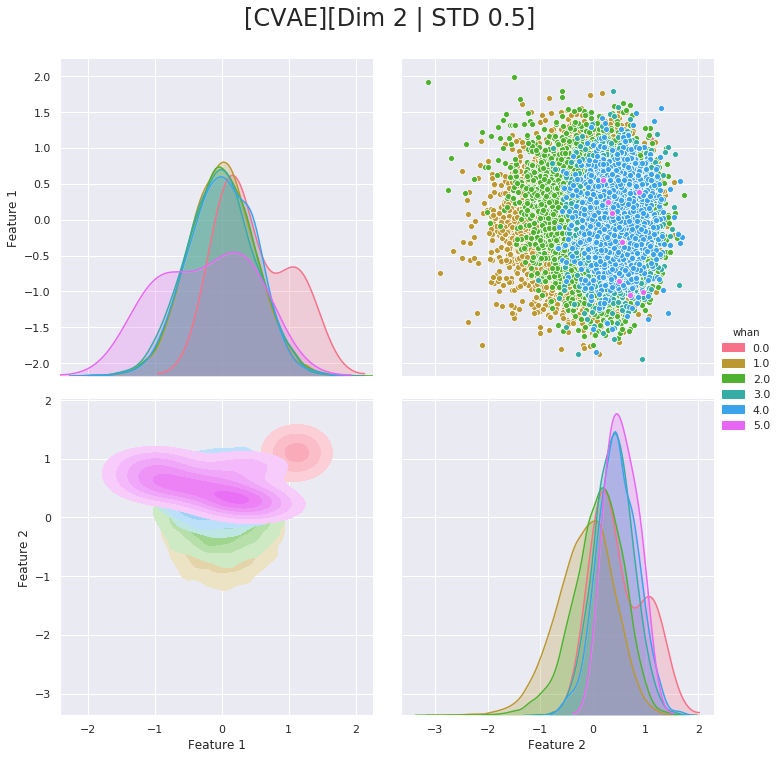

(24879, 5) (24879, 1)


<Figure size 432x288 with 0 Axes>

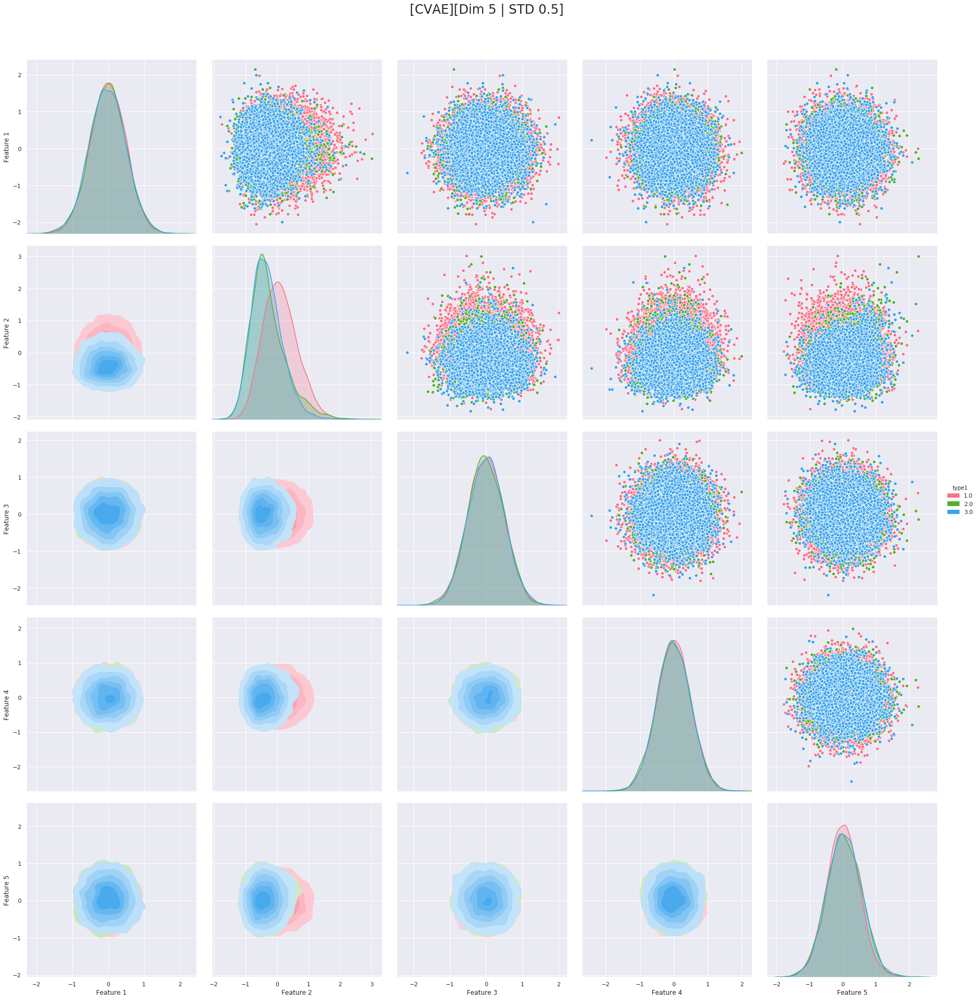

<Figure size 432x288 with 0 Axes>

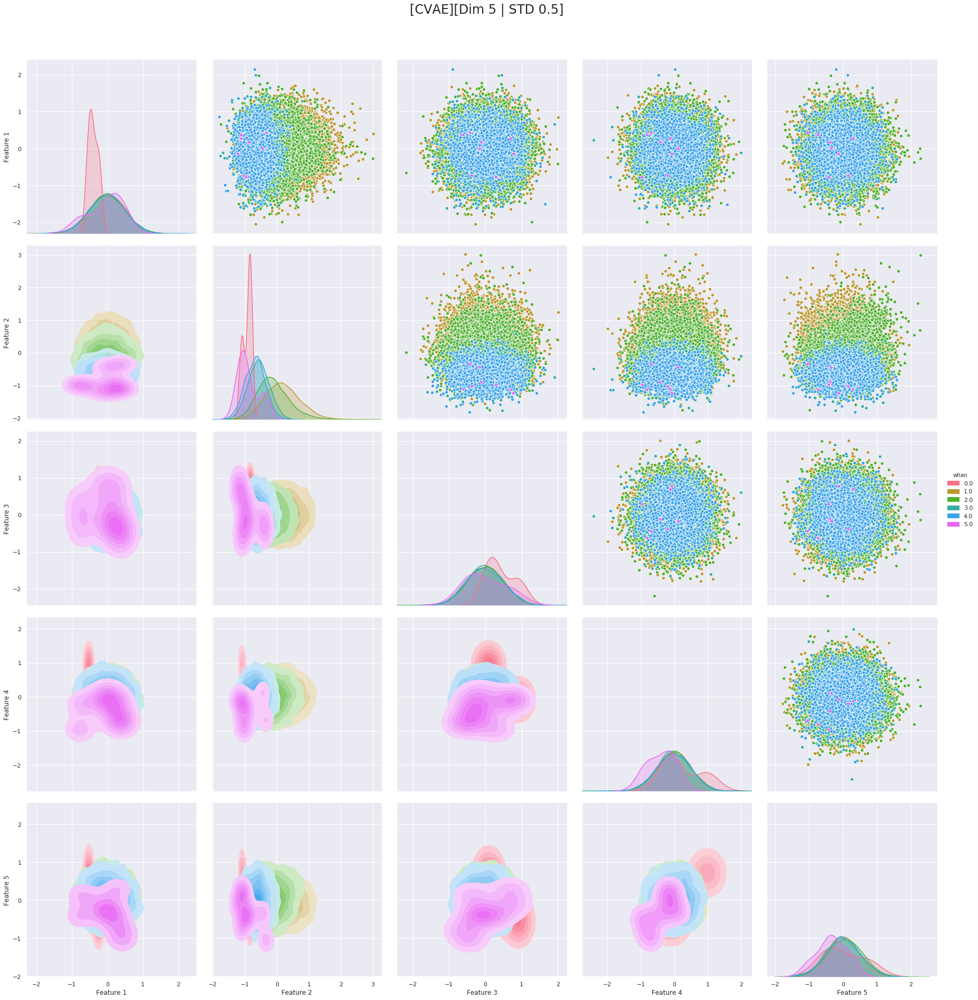

(24879, 4) (24879, 1)


In [ ]:
from Dirs import *
import os
import pandas as pd
import numpy as np
import random
import shutil
import seaborn as sns; sns.set()
import matplotlib.pyplot as plt
import itertools
%matplotlib inline

arquivos = os.listdir(latentSpace_dir)
classes = pd.read_csv("Training_Data")
labels = ["type1", "whan"]
porcentage = 0.9

for arquivo in arquivos:
    #print(arquivo)
    if "Dim" not in arquivo:
        continue
    elif ("[CAE]" in arquivo or "[CVAE]" in arquivo):

        df_tmp = pd.read_csv(latentSpace_dir +"/"+ arquivo, engine='python')
        features = []
        for i in range(df_tmp.shape[1]):
            features.append('Feature {}'.format(i+1))

        features.append("type1")
        features.append("whan")
        #print(classes.shape)
        type1 = np.copy(classes.values[int(classes.shape[0] * porcentage):,-2] )
        type1 = np.reshape(type1, (type1.shape[0],1))
        print(df_tmp.values.shape, type1.shape)
        concat = np.concatenate([df_tmp.values, type1], axis = 1)
        whan = np.copy(classes.values[int(classes.shape[0] * porcentage):,-1])
        whan = np.reshape(whan, (whan.shape[0],1))
        concat = np.concatenate([concat, whan], axis = 1)
        df = pd.DataFrame(data = concat , columns = features)
        #print(df.head(5))
        #print(df.shape)
        labels = ["type1", "whan"]
        features.pop()
        features.pop()

        for label in labels:
            index = []
            for i in range(df.shape[1] - 2):
                index.append(i+1)

            comb_pairs = itertools.combinations(index,2)
            key = True
            comb_2d = []
            while(key):
                try:
                    comb_2d.append(next(comb_pairs))

                except:
                    key = False

            comb_2d.reverse()
            plt.figure()           
            #sns.scatterplot(x="Feature %d" % (1) , y="Feature %d" % (2), 
            #                palette = sns.color_palette("husl", len(np.unique(tse_df[label]))),
            #                hue=label, data=tse_df)     
            #plt.title('Latent Space R¨2')


            
            g = sns.PairGrid(df, hue=label, vars= features , height=5, 
                             palette = sns.color_palette("husl", len(np.unique(df[label]))))
            g.map_diag(sns.kdeplot, shade=True)
            g.map_upper(sns.scatterplot)
            g.map_lower(sns.kdeplot, shade=True, shade_lowest= False, n_levels = 6)
            g.add_legend()
            
            if "[VAE]" in arquivo:
                std = arquivo.split("|")[1].split("=")[1]
                g.fig.suptitle("[VAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 24, y = 1.05)
                g.savefig(plots_dir + '/VAE/' + 
                            '[Dim {} | STD {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],std,label))
                g.savefig(root_dir + "/Playground/" + 
                          '[VAE | Dim {} | STD {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],std,label))
            elif "[CAE]" in arquivo:
                g.fig.suptitle("[CAE][Dim {}]".format(df_tmp.shape[1]), fontsize = 24, y = 1.05)
                #g.savefig(plots_dir + '/CAE/' + 
                #            '[Dim {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],label))
                #g.savefig(root_dir + "/Playground/" + 
                #          '[AE | Dim {}]Latent_Space-Type:{} conv final.png'.format(df_tmp.shape[1],label))
            elif "[AE]" in arquivo:
                g.fig.suptitle("[AE][Dim {}]".format(df_tmp.shape[1]), fontsize = 24, y = 1.05)
                g.savefig(plots_dir + '/AE/' + 
                            '[Dim {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],label))
                g.savefig(root_dir + "/Playground/" + 
                          '[AE | Dim {}]Latent_Space-Type:{} without -999.png'.format(df_tmp.shape[1],label))
                
            elif "[CVAE]" in arquivo:
                std = arquivo.split("|")[1].split("=")[1]
                g.fig.suptitle("[CVAE][Dim {} | STD {}]".format(df_tmp.shape[1],std), fontsize = 24, y = 1.05)
                g.savefig(plots_dir + '/CVAE/' + 
                            '[Dim {} | STD {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],std,label))
                
                g.savefig(root_dir + "/Playground/" + 
                          '[CVAE | Dim {} | STD {}]Latent_Space-Type:{}.png'.format(df_tmp.shape[1],std,label))

            #plt.close()
            plt.show()
        

        #print(f"[Finished]{arquivo}")
    else:
        continue